In [1]:
%matplotlib inline

import matplotlib
import numpy as np
import matplotlib.pyplot as plt

# import itertools
# matplotlib.use('Agg')
import os
from os import walk
import cv2



from datetime import datetime
from pytz import timezone


import cntk.tests.test_utils
import cntk as C
from cntk.layers import Convolution, MaxPooling, Dense
from cntk.initializer import glorot_uniform
from cntk.ops import relu, sigmoid, input_variable
from cntk.learners import learning_rate_schedule, UnitType
from cntk.device import try_set_default_device, gpu, all_devices
from cntk.ops.functions import load_model
global result_path 
global report_root 
global report_img_path 
global img_predict_dir_path
global img_blending_dir_path 
global img_test_dir_path 


In [2]:
def get_window( img, y, x, size = 31 ):
    temp = (size - 1) // 2
    x1 = x - temp
    x2 = x + 1 + temp
    y1 = y - temp
    y2 = y + 1 + temp
    window = img[ y1:y2, x1:x2, :]
    return window

In [3]:
def read_color_img(path):
    bgr = cv2.imread( path, cv2.IMREAD_COLOR )
    b, g, r = cv2.split( bgr )
    img = cv2.merge( [r, g, b] )
    return img

In [4]:
def to_bgr(rgb):
    r, g, b = cv2.split( rgb )
    bgr = cv2.merge( [b, g, r] )
    return bgr

In [5]:
def read_gray_img(path):
    img = cv2.imread( path, cv2.IMREAD_GRAYSCALE)
    return img

In [6]:
def get_largest_component (image):
    nb_components, output, stats, centroids = cv2.connectedComponentsWithStats(image, connectivity=8)
    sizes = stats[:, -1]
    max_label = 1
    if len(sizes) >= 2:
        max_size = sizes[1]
    else :
        max_size = sizes[0]
    for i in range(2, nb_components):
        if sizes[i] > max_size:
            max_label = i
            max_size = sizes[i]
    img2 = np.zeros(output.shape)
    img2[output == max_label] = 255
    return img2

In [7]:
def union( img1, img2):
    h, w = img1.shape
    img = np.zeros( shape = (h,w)  , dtype = np.uint8)
    for row in range(h):
        for col in range(w):
            v1 = img1[row, col]
            v2 = img2[row, col]
            if v1 == 255 or v2 == 255:
                img[row, col] = 255
    return img

In [8]:
def intersection( img1, img2):
    h, w = img1.shape
    img = np.zeros( shape = (h,w)  , dtype = np.uint8)
    for row in range(h):
        for col in range(w):
            v1 = img1[row, col]
            v2 = img2[ row, col]
            if v1 == 255 and v2 == 255:
                img[row, col] = 255
    return img

In [9]:
def get_IoU( img1, img2):
    union_img = union(img1, img2)
    intersection_img = intersection(img1, img2)
    sum_union = 0
    sum_intersection = 0
    h, w = union_img.shape
    for row in range(h):
        for col in range(w):
            v1 = union_img[row, col]
            v2 = intersection_img[row, col]
            if v1 == 255:
                sum_union += 1
            if v2 == 255:
                sum_intersection += 1
    return sum_intersection / sum_union

In [10]:
def show_img(img, title=None, mode=None):
    plt.imshow(img, cmap=mode)
    plt.title(title)
    plt.show()

In [11]:
def alpha_blending( fg, bg, alpha = 0.3 ):
    new_img = np.array(bg)
    rows, cols = fg.shape
    for row in range(rows):
        for col in range(cols):
            if fg[row, col] == 255:                
                value = ( (1-alpha) * 255 ) +  ( alpha * bg[row, col, 2] )
                new_img[row, col, 2] = int(value)
                new_img[row, col, 0] = bg[row, col, 0]
                new_img[row, col, 1] = bg[row, col, 1]
    return new_img

In [12]:
def predict( img_color, model, stride=2):
    num_pixel = 0
    height, width, chanel = img_color.shape
    img_predict = np.zeros( shape = (height, width)  , dtype = np.uint8)
    print("shape => {:d},{:d}".format(height, width))
    
    white = np.asarray([255])
    
    for row in range(15, height - 15, stride):
        data = list()
        for col in range(15, width - 15, stride):
            num_pixel += 1
            w = get_window( img_color , row, col, 31 )
            tmp_data = np.asarray(w, dtype=np.float32)
            tmp_data = np.reshape( tmp_data, (3,31,31))
            data.append(tmp_data)
        
        data_array = np.array(data)
        predictions = model.eval(data_array)
        
        for index in range(len(data)):
            col = 15 + (stride * index)
            p = predictions[index]
            top_class = np.argmax(p)
            if top_class == 1:
                img_predict[row, col] = white
            elif top_class == 2 :
                img_predict[row, col] = white
    print("num pixel => {:d}".format(num_pixel))
    return img_predict

In [13]:
def segment( color_path, model,img_predict_dir_path ):
    img_color = read_color_img( color_path )
    img_predict = predict( img_color, model )
    
    cv2.imwrite('%s/%s_predict1.png' % ( img_predict_dir_path, get_name_img_color(color_path)), img_predict )
    img_predict = cv2.dilate( img_predict, np.ones( (5,5) , np.uint8), iterations=1)
    img_predict = cv2.erode( img_predict, np.ones( (5,5) , np.uint8), iterations=1)
    img_predict = cv2.dilate( img_predict, np.ones( (3,3) , np.uint8), iterations=1)
    
    img_predict = get_largest_component(img_predict)
    img_blending = alpha_blending( fg=img_predict, bg=img_color )
    
    return img_color, img_predict 

In [14]:
def test_predict( img_predict, img_gray):
    num_pixel_all = 0 
    num_pixel_tp = 0
    num_pixel_fp = 0
    num_pixel_tn = 0 
    num_pixel_fn = 0
#     print(img_predict.shape)
    height, width = img_predict.shape
    test_img = np.zeros( shape = (height, width, 3)  , dtype = np.uint8)
    for row in range(height):
        for col in range(width):
            num_pixel_all += 1
            red = [ 255, 0, 0]
            green = [ 0, 255, 0]
            yellow = [ 255, 255, 0]
            # wrong = red, right = green
            if img_predict[row, col] and img_gray[row, col] == 255:
                num_pixel_tp += 1
                test_img[row, col] = green                
            elif img_predict[row, col] == 255 and img_gray[row, col] == 0:
                num_pixel_fp += 1
                test_img[row, col] = yellow
            elif img_predict[row, col] == 0 and img_gray[row, col] == 255:
                num_pixel_tn += 1
                test_img[row, col] = red
            else :
                num_pixel_fn += 1
    return test_img, num_pixel_all, num_pixel_tp, num_pixel_fp, num_pixel_tn, num_pixel_fn

In [15]:
def get_name_img_color(path):
    last_slash_index = path.rfind('/')
    last_dot_index = path.rfind('.')
    name = path[ last_slash_index + 1: last_dot_index]
    return name

In [16]:
def get_name_img_gray(path):
    last_slash_index = path.rfind('/')
    last_under_index = path.rfind('_')
    name = path[ last_slash_index + 1: last_under_index]
    return name

In [17]:
def get_all_file_paths(root):
    paths = list()
    for _, _, files in os.walk(root):
        for file in files:
            paths.append( os.path.join( root, file ) )
    paths.sort()
    return paths

In [18]:
def process(color_path, gray_path,report_root,model,img_predict_dir_path,img_blending_dir_path,img_test_dir_path,report_img_path, gray_dir_path):
    name = get_name_img_color(color_path)
    
    write_log('PREDICT... %s' % name,report_root)
    
    img_color, img_predict = predict_image(color_path, model, img_predict_dir_path)#predict_image(color_path, model)
    img_gray = read_gray_img(gray_path)
    
    img_test, num_pixel_all, num_pixel_tp, num_pixel_fp, num_pixel_tn, num_pixel_fn = test_predict( img_predict, img_gray )
    
    img_alpha_blening = alpha_blending( img_predict, img_color )
    
    iou_value = get_IoU( img_gray, img_predict)
    
    write_log(' , IoU = %s' % iou_value,report_root )
    
    
    cv2.imwrite('%s/%s_predict2.png' % ( img_predict_dir_path, name) , img_predict )
    
    cv2.imwrite('%s/%s_blending.png' % ( img_blending_dir_path, name) , to_bgr(img_alpha_blening ) )
    
    cv2.imwrite('%s/%s_compare.png' % ( img_test_dir_path, name) , to_bgr(img_test ) )
    plt.close()
    
    plt.figure()
    
    plt.subplot(221)
    plt.imshow(img_color)
    plt.title("Original")
    plt.axis('off')
    
    plt.subplot(222)
    plt.imshow(img_predict, cmap='gray')
    plt.title("Predicted")
    plt.axis('off')
    
    plt.subplot(223)
    plt.imshow(img_alpha_blening)
    plt.title("Blending")
    plt.axis('off')   
    
    plt.subplot(224)
    plt.imshow(img_test)
    plt.title("%s" % iou_value)
    plt.axis('off')
    

    fig_name = '%s/%s_report.png' % ( report_img_path, name )
    write_log('Saving... %s' % fig_name,report_root)
    plt.savefig( fig_name )
    plt.show()
    
    return iou_value, num_pixel_all, num_pixel_tp, num_pixel_fp, num_pixel_tn, num_pixel_fn

In [19]:
def check_paths( img_paths ):
    num_img = len(img_paths)
    for image in img_paths:
        path_color = "../testing_data/images/" + type_folder + image[:-4] + ".png"
        path_gray = gray_dir_path + image[:-4] + "_gray.png"
        
        color_name = get_name_img_color(path_color)
        gray_name = get_name_img_gray(path_gray)
        if not color_name == gray_name:
            raise Exception('%s not match %s' % ( color_name, gray_name))
            return False
    return True

In [20]:
def prepare_folder(result_path, report_root, report_img_path, img_predict_dir_path, img_blending_dir_path,img_test_dir_path):    
    if not os.path.exists(result_path):
        os.mkdir(result_path)
    if not os.path.exists(report_root):
        os.mkdir(report_root)
    if not os.path.exists(report_img_path):
        os.mkdir(report_img_path)
    if not os.path.exists(img_predict_dir_path):
        os.mkdir(img_predict_dir_path)
    if not os.path.exists(img_blending_dir_path):
        os.mkdir(img_blending_dir_path)
    if not os.path.exists(img_test_dir_path):
        os.mkdir(img_test_dir_path)

In [21]:
def write_log(line, report_root, mode='a'):
    print(line)
    with open('%s/log.txt' % report_root, mode) as file:
        file.write( line + '\n' )

In [22]:
def process2(result_path, report_root, report_img_path, img_predict_dir_path, img_blending_dir_path,img_test_dir_path, model, gray_dir_path):
    prepare_folder(result_path, report_root, report_img_path, img_predict_dir_path, img_blending_dir_path,img_test_dir_path)
    
    s = datetime.now(timezone('Asia/Bangkok')).strftime('date: %Y-%m-%d ,time: %H:%M:%S')
    write_log("START : %s"%s, report_root,'w')

    img_paths = get_image_file(color_dir_path)

    if not check_paths( img_paths ):
        raise Exception('List not match each other. Please check name of image.')

#     num_test = len( img_paths )
    iou_list = list()
    
    num_pixel_all = 0
    num_pixel_tp = 0
    num_pixel_fp = 0
    num_pixel_tn = 0
    num_pixel_fn = 0

    for image in img_paths:
        
        color_path = color_dir_path + image
        gray_path  = gray_dir_path + image[:-4] + "_gray.png"
        iou_value, pixel_all, pixel_tp, pixel_fp, pixel_tn, pixel_fn = process(color_path, gray_path, report_root,model, img_predict_dir_path, img_blending_dir_path, img_test_dir_path, report_img_path, gray_dir_path)
        iou_list.append(iou_value)
        num_pixel_all += pixel_all 
        num_pixel_tp += pixel_tp
        num_pixel_fp += pixel_fp
        num_pixel_tn += pixel_tn
        num_pixel_fn += pixel_fn
    
  
    iou_sum = sum(iou_list)
    iou_avg = iou_sum / len(iou_list)
    iou_min = min(iou_list)
    line = 'SEGMENTATION REPORT :: iou_avg %s, iou_min %s' % ( iou_avg, iou_min)

    e = datetime.now(timezone('Asia/Bangkok')).strftime('date: %Y-%m-%d ,time: %H:%M:%S')

    write_log(line, report_root)
    write_log(e, report_root)
    return num_pixel_all, num_pixel_tp, num_pixel_fp, num_pixel_tn, num_pixel_fn

In [23]:
def confusion_matrix(num_pixel_all, num_pixel_tp, num_pixel_fp, num_pixel_tn, num_pixel_fn) :
    precision = num_pixel_tp/(num_pixel_tp + num_pixel_fp)*100
    recall = num_pixel_tp/(num_pixel_tp + num_pixel_tn)*100
    f_measure = (2*precision*recall) / (precision + recall)
    accuracy = (num_pixel_tp + num_pixel_fn) / num_pixel_all
    print("\twound\tnot wound")
    print("    wound\t{:d}\t{:d}".format(num_pixel_tp, num_pixel_fp))
    print("not wound\t{:d}\t{:d}".format(num_pixel_tn, num_pixel_fn))
    print("precision => {:.2f}".format(precision))
    print("recall => {:.2f}".format(recall))
    print("f-measure => {:.2f}".format(f_measure))
    print("accuracy => {:.2f}".format(accuracy*100))
    print("all sample => {:d}".format(num_pixel_all))

In [24]:
def over_flitting_plot(src) :
    training_errors = np.loadtxt(src + "training_result.txt")
    test_errors = np.loadtxt(src + "test_result.txt")
    
    s_list = sorted({"training": training_errors, "test": test_errors}.items())
    markers = itertools.cycle(('+', 'x', 'o'))

    plt.title('{}'.format("accuracy"))

    for label, result in s_list:
        plt.plot(result, marker=next(markers), label=label)
        plt.ylabel('dice_coef')
        plt.xlabel('epoch')
        plt.legend(loc=3, bbox_to_anchor=(1, 0))

    plt.show()

In [25]:
def segmentation(root_path, model_name, color_dir_path, gray_dir_path):
    
#     over_flitting_plot(root_path + "results/" + model_name[:-6] + "/")
    model_path = root_path + model_name

    model_name = get_name_img_color(model_path)
    result_path = root_path + 'results'
    report_root = root_path + 'results/%s' % model_name
    report_img_path = root_path + 'results/%s/reports' % model_name
    img_predict_dir_path = root_path + 'results/%s/predict/' % model_name
    img_blending_dir_path = root_path + 'results/%s/blending' % model_name
    img_test_dir_path = root_path + 'results/%s/compare/' % model_name


    if os.path.exists(color_dir_path):
        print('Image Dir is %s' % color_dir_path)
    else:
        raise Exception('%s not found.' % color_dir_path)

    if os.path.exists(model_path):
        print('Model is %s' % model_path)
    else:
        raise Exception('%s not found.' % model_path)

    model = load_model(model_path)
    num_pixel_all, num_pixel_tp, num_pixel_fp, num_pixel_tn, num_pixel_fn = process2(result_path, report_root, report_img_path, img_predict_dir_path, img_blending_dir_path,img_test_dir_path, model, gray_dir_path)
    confusion_matrix(num_pixel_all, num_pixel_tp, num_pixel_fp, num_pixel_tn, num_pixel_fn)

In [26]:
input_dim_model = (3, 256, 256)
input_dim = 3 * 256 * 256
num_output_classes = 256 * 256

def create_reader_text(path, is_training, input_dim, num_label_classes):   

    labelStream = cntk.io.StreamDef(field='label', shape=num_label_classes, is_sparse=False)
    featureStream = cntk.io.StreamDef(field='features', shape=input_dim, is_sparse=False)
#     coordinateStream = cntk.io.StreamDef(field='coordinate', shape=2, is_sparse=False)
    
#     deserailizer = cntk.io.CBFDeserializer(path, cntk.io.StreamDefs(label = labelStream ,feature = featureStream))
    deserailizer = cntk.io.CTFDeserializer(path, cntk.io.StreamDefs(label = labelStream ,feature = featureStream))      
    return cntk.io.MinibatchSource(deserailizer,
       randomize = False, multithreaded_deserializer=False,max_sweeps = cntk.io.INFINITELY_REPEAT if is_training else 1)


def create_reader_binary(path, is_training, input_dim, num_label_classes):   

    labelStream = cntk.io.StreamDef(field='label', shape=num_label_classes, is_sparse=False)
    featureStream = cntk.io.StreamDef(field='features', shape=input_dim, is_sparse=False)
#     coordinateStream = cntk.io.StreamDef(field='coordinate', shape=2, is_sparse=False)
    
    deserailizer = cntk.io.CBFDeserializer(path, cntk.io.StreamDefs(label = labelStream ,feature = featureStream))
#     deserailizer = cntk.io.CTFDeserializer(path, cntk.io.StreamDefs(label = labelStream ,feature = featureStream))      
    return cntk.io.MinibatchSource(deserailizer,
       randomize = False, multithreaded_deserializer=False,max_sweeps = cntk.io.INFINITELY_REPEAT if is_training else 1)

def load_test(src_file) :
        
    return create_reader_text(src_file, False, input_dim, num_output_classes)

def create_white_image():
    img = np.zeros(shape = (256,256) ,dtype = np.uint8)
    img.fill(255)
    return img

def predict_image(src_file, model, img_predict_dir_path) :
    print(src_file)
    samples_train_size = len(open(src_file).readlines())
    reader_test = load_test(src_file)
    
    minibatch_size = 1
    num_samples_per_sweep = samples_train_size
    num_minibatches_to_train = (num_samples_per_sweep ) / minibatch_size
    
    input_map = {'label': reader_test.streams.label, 'input': reader_test.streams.feature} 

#     print(reader_test.streams.label)
#     print(reader_test.streams.feature)


    data_x, data_y = [], []
    for i in range(0, int(num_minibatches_to_train)):

        # Read a mini batch from the training data file
        data = reader_test.next_minibatch(minibatch_size, input_map=input_map) 

        training_data = []
        for k in data.keys() :
            for v in data[k].as_sequences()[0] :
                 training_data.append(v)

        data_x.append(training_data[0])
        data_y.append(training_data[1])



    labels = np.reshape(data_x, (num_samples_per_sweep,1,256,256))
    features = np.reshape(data_y,(num_samples_per_sweep,3,256,256))
    
    pred = prediction_image(features, model)
    img = create_white_image()
    rows, cols = pred[0][0].shape

    for row in range(rows) :
        for col in range(cols) :
            if pred[0,0,row,col] > 0.5:
                img[row,col] = 255
            else :
                img[row,col] = 0

    cv2.imwrite('%s/%s_predict1.png' % ( img_predict_dir_path, get_name_img_color(src_file)), img )
    
    
    return read_color_img('../testing_data/images/' + type_folder + get_name_img_color(src_file)+".png" ), img

def prediction_image(features_image, model) :
    return model.eval(features_image)

    
def create_white_image():
    img = np.zeros(shape = (256,256) ,dtype = np.uint8)
    img.fill(255)
    return img

def get_image_file(src_folder):
    images = []
    for (dirpath, dirnames, filenames) in walk(src_folder):
        images.extend(filenames)
        
    return images

def show_prediction_image(image):
    print(image[0][0].shape)
    
    img = create_white_image()
    rows, cols = image[0][0].shape

    for row in range(rows) :
        for col in range(cols) :
            if image[0,0,row,col] > 0.5:
                img[row,col] = 255
            else :
                img[row,col] = 0
                
#     plt.imshow(img,'gray')
#     plt.show()

In [28]:
type_folder = "original_augment/"

root_path = '../training_data/model/' + type_folder
color_dir_path = '../testing_data/features/' + type_folder
gray_dir_path = '../testing_data/images/gray/'

training 100 epoch 

Image Dir is ../testing_data/features/original_augment/
Model is ../training_data/model/original_augment/model8.80.model
START : date: 2018-05-08 ,time: 14:53:47
PREDICT... m_47_motoC_to_S8
../testing_data/features/original_augment/m_47_motoC_to_S8.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/m_47_motoC_to_S8_report.png


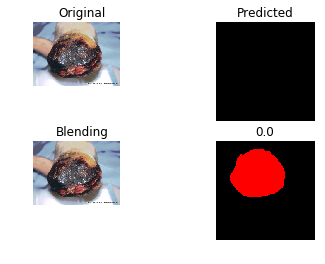

PREDICT... b_12
../testing_data/features/original_augment/b_12.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/b_12_report.png


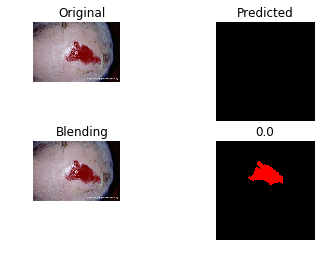

PREDICT... m_03_motoC_to_S8
../testing_data/features/original_augment/m_03_motoC_to_S8.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/m_03_motoC_to_S8_report.png


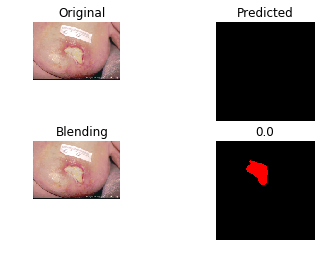

PREDICT... f_41_s8_to_iPad
../testing_data/features/original_augment/f_41_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/f_41_s8_to_iPad_report.png


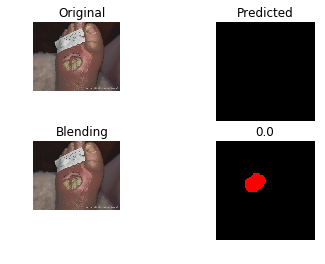

PREDICT... m_03
../testing_data/features/original_augment/m_03.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/m_03_report.png


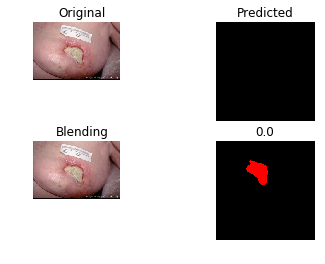

PREDICT... p1_67_s8_to_iPad
../testing_data/features/original_augment/p1_67_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/p1_67_s8_to_iPad_report.png


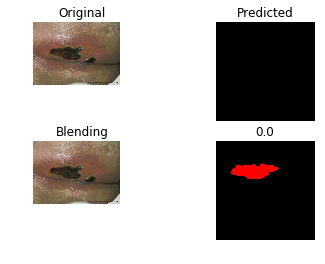

PREDICT... f_50
../testing_data/features/original_augment/f_50.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/f_50_report.png


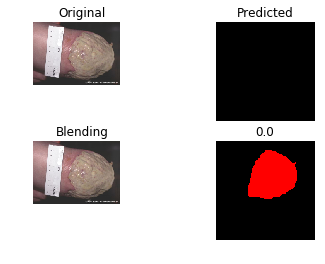

PREDICT... f_35
../testing_data/features/original_augment/f_35.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/f_35_report.png


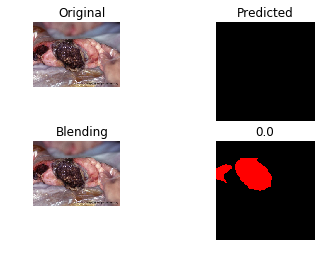

PREDICT... p2_57_motoC_to_S8
../testing_data/features/original_augment/p2_57_motoC_to_S8.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/p2_57_motoC_to_S8_report.png


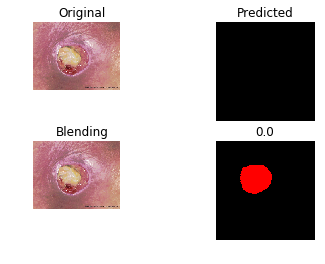

PREDICT... v2_07
../testing_data/features/original_augment/v2_07.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/v2_07_report.png


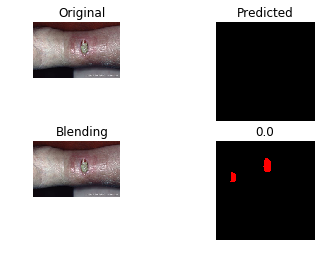

PREDICT... p2_54_motoC_to_S8
../testing_data/features/original_augment/p2_54_motoC_to_S8.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/p2_54_motoC_to_S8_report.png


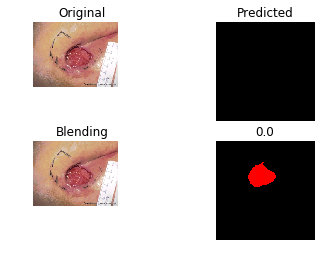

PREDICT... v1_76_motoC_to_S8
../testing_data/features/original_augment/v1_76_motoC_to_S8.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/v1_76_motoC_to_S8_report.png


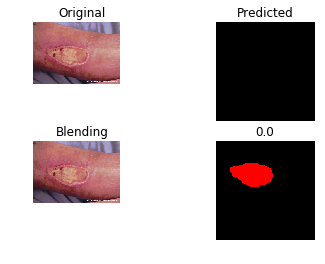

PREDICT... p2_54
../testing_data/features/original_augment/p2_54.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/p2_54_report.png


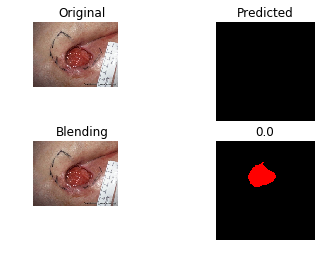

PREDICT... m_47
../testing_data/features/original_augment/m_47.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/m_47_report.png


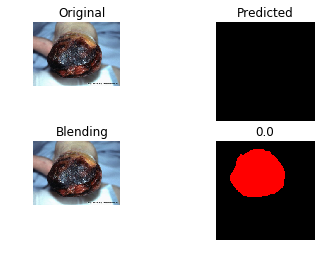

PREDICT... v2_07_motoC_to_S8
../testing_data/features/original_augment/v2_07_motoC_to_S8.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/v2_07_motoC_to_S8_report.png


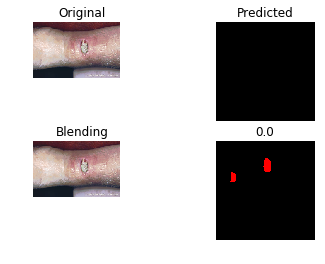

PREDICT... a_04
../testing_data/features/original_augment/a_04.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/a_04_report.png


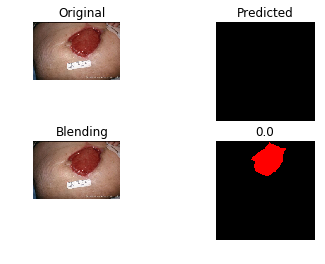

PREDICT... t_25_s8_to_iPad
../testing_data/features/original_augment/t_25_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/t_25_s8_to_iPad_report.png


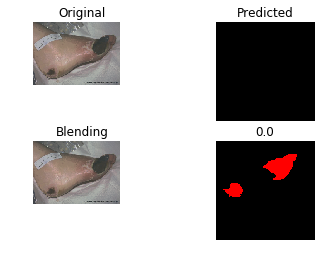

PREDICT... f_41
../testing_data/features/original_augment/f_41.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/f_41_report.png


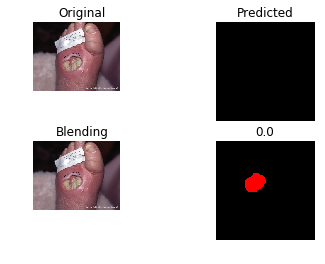

PREDICT... p2_57
../testing_data/features/original_augment/p2_57.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/p2_57_report.png


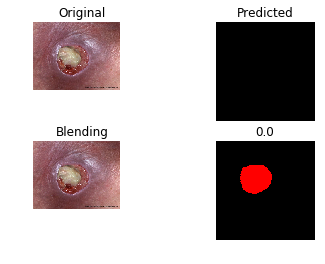

PREDICT... p1_82_s8_to_iPad
../testing_data/features/original_augment/p1_82_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/p1_82_s8_to_iPad_report.png


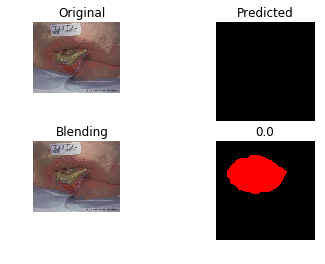

PREDICT... p1_72_motoC_to_S8
../testing_data/features/original_augment/p1_72_motoC_to_S8.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/p1_72_motoC_to_S8_report.png


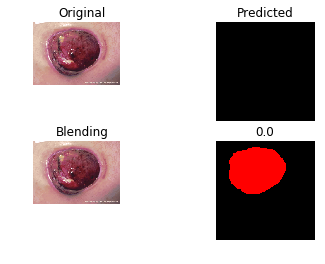

PREDICT... p1_82
../testing_data/features/original_augment/p1_82.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/p1_82_report.png


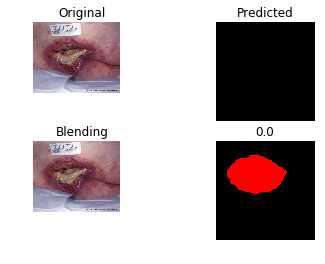

PREDICT... b_20_motoC_to_S8
../testing_data/features/original_augment/b_20_motoC_to_S8.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/b_20_motoC_to_S8_report.png


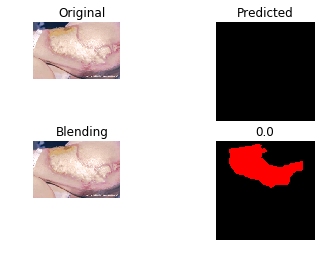

PREDICT... p1_73_s8_to_iPad
../testing_data/features/original_augment/p1_73_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/p1_73_s8_to_iPad_report.png


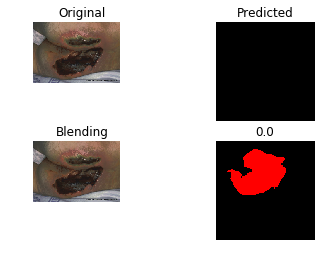

PREDICT... p1_72_s8_to_iPad
../testing_data/features/original_augment/p1_72_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/p1_72_s8_to_iPad_report.png


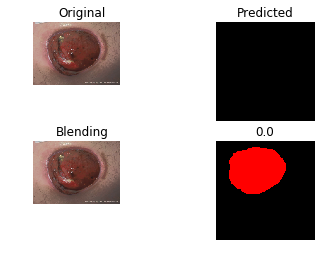

PREDICT... v1_70
../testing_data/features/original_augment/v1_70.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/v1_70_report.png


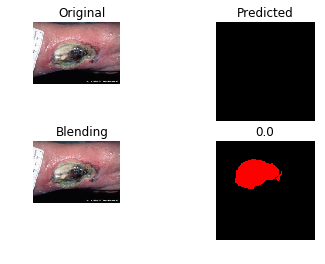

PREDICT... v1_76_s8_to_iPad
../testing_data/features/original_augment/v1_76_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/v1_76_s8_to_iPad_report.png


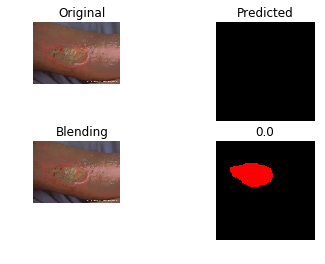

PREDICT... a_05
../testing_data/features/original_augment/a_05.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/a_05_report.png


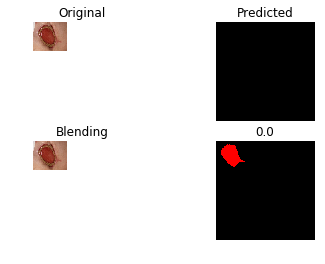

PREDICT... m_43_s8_to_iPad
../testing_data/features/original_augment/m_43_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/m_43_s8_to_iPad_report.png


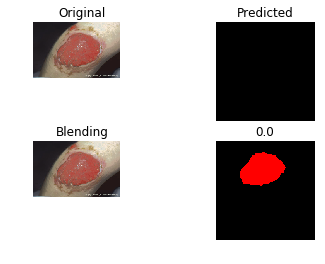

PREDICT... v1_76
../testing_data/features/original_augment/v1_76.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/v1_76_report.png


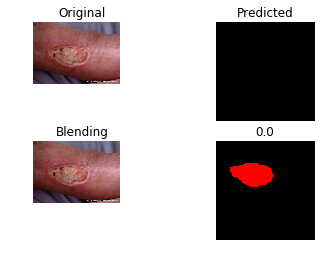

PREDICT... p1_82_motoC_to_S8
../testing_data/features/original_augment/p1_82_motoC_to_S8.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/p1_82_motoC_to_S8_report.png


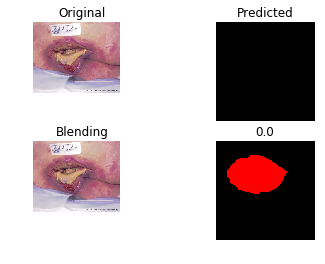

PREDICT... m_47_s8_to_iPad
../testing_data/features/original_augment/m_47_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/m_47_s8_to_iPad_report.png


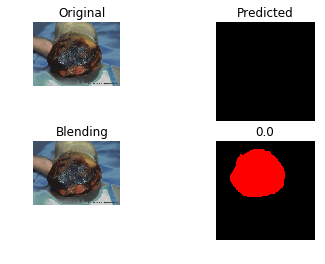

PREDICT... m_25_s8_to_iPad
../testing_data/features/original_augment/m_25_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/m_25_s8_to_iPad_report.png


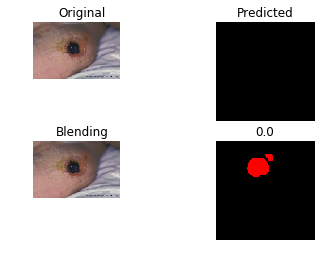

PREDICT... t_25
../testing_data/features/original_augment/t_25.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/t_25_report.png


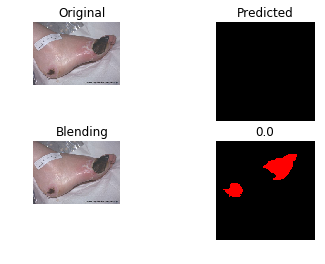

PREDICT... f_50_motoC_to_S8
../testing_data/features/original_augment/f_50_motoC_to_S8.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/f_50_motoC_to_S8_report.png


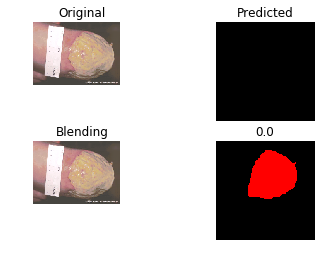

PREDICT... b_11
../testing_data/features/original_augment/b_11.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/b_11_report.png


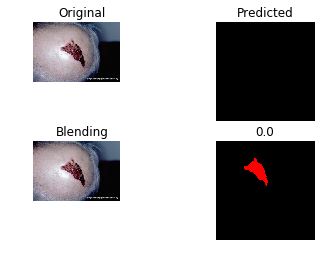

PREDICT... p1_67
../testing_data/features/original_augment/p1_67.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/p1_67_report.png


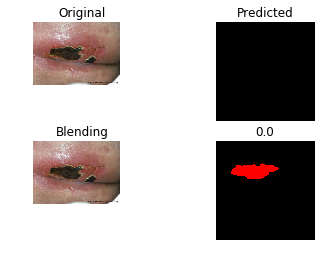

PREDICT... f_18_motoC_to_S8
../testing_data/features/original_augment/f_18_motoC_to_S8.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/f_18_motoC_to_S8_report.png


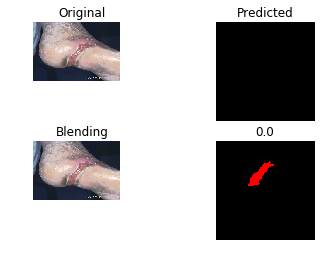

PREDICT... f_41_motoC_to_S8
../testing_data/features/original_augment/f_41_motoC_to_S8.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/f_41_motoC_to_S8_report.png


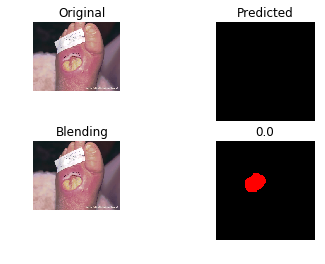

PREDICT... f_50_s8_to_iPad
../testing_data/features/original_augment/f_50_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/f_50_s8_to_iPad_report.png


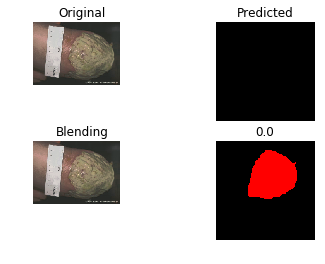

PREDICT... p1_73_motoC_to_S8
../testing_data/features/original_augment/p1_73_motoC_to_S8.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/p1_73_motoC_to_S8_report.png


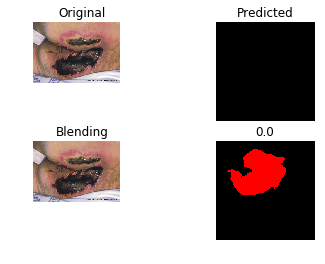

PREDICT... b_20_s8_to_iPad
../testing_data/features/original_augment/b_20_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/b_20_s8_to_iPad_report.png


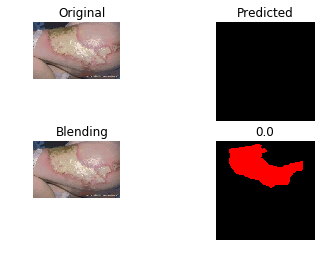

PREDICT... b_05
../testing_data/features/original_augment/b_05.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/b_05_report.png


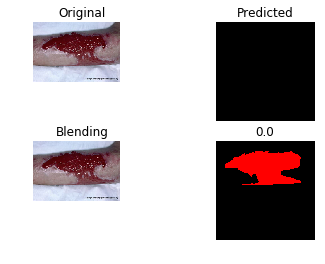

PREDICT... m_03_s8_to_iPad
../testing_data/features/original_augment/m_03_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/m_03_s8_to_iPad_report.png


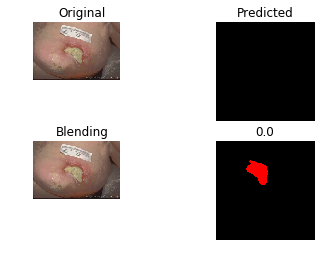

PREDICT... v1_84_motoC_to_S8
../testing_data/features/original_augment/v1_84_motoC_to_S8.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/v1_84_motoC_to_S8_report.png


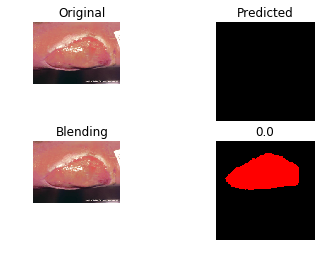

PREDICT... m_43
../testing_data/features/original_augment/m_43.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/m_43_report.png


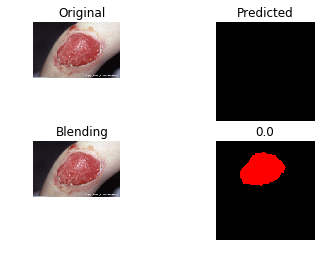

PREDICT... p1_81_s8_to_iPad
../testing_data/features/original_augment/p1_81_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/p1_81_s8_to_iPad_report.png


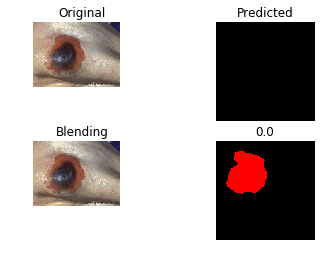

PREDICT... p1_67_motoC_to_S8
../testing_data/features/original_augment/p1_67_motoC_to_S8.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/p1_67_motoC_to_S8_report.png


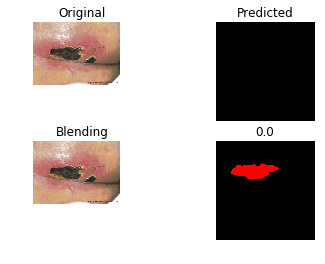

PREDICT... b_05_motoC_to_S8
../testing_data/features/original_augment/b_05_motoC_to_S8.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/b_05_motoC_to_S8_report.png


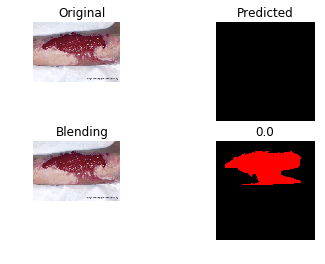

PREDICT... m_43_motoC_to_S8
../testing_data/features/original_augment/m_43_motoC_to_S8.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/m_43_motoC_to_S8_report.png


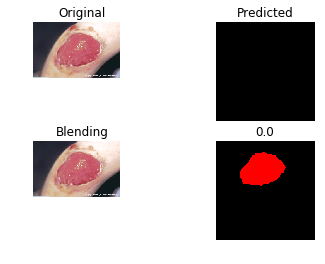

PREDICT... f_35_s8_to_iPad
../testing_data/features/original_augment/f_35_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/f_35_s8_to_iPad_report.png


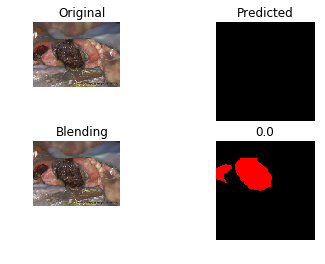

PREDICT... f_35_motoC_to_S8
../testing_data/features/original_augment/f_35_motoC_to_S8.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/f_35_motoC_to_S8_report.png


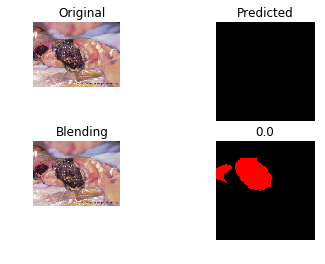

PREDICT... v1_70_s8_to_iPad
../testing_data/features/original_augment/v1_70_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/v1_70_s8_to_iPad_report.png


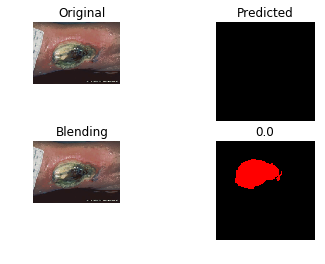

PREDICT... f_18_s8_to_iPad
../testing_data/features/original_augment/f_18_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/f_18_s8_to_iPad_report.png


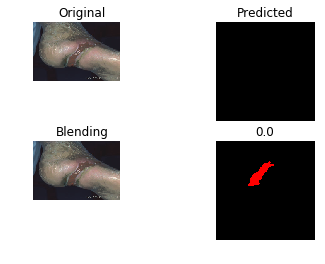

PREDICT... b_11_motoC_to_S8
../testing_data/features/original_augment/b_11_motoC_to_S8.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/b_11_motoC_to_S8_report.png


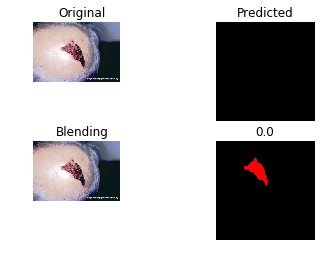

PREDICT... b_12_s8_to_iPad
../testing_data/features/original_augment/b_12_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/b_12_s8_to_iPad_report.png


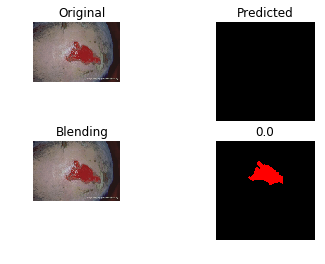

PREDICT... t_25_motoC_to_S8
../testing_data/features/original_augment/t_25_motoC_to_S8.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/t_25_motoC_to_S8_report.png


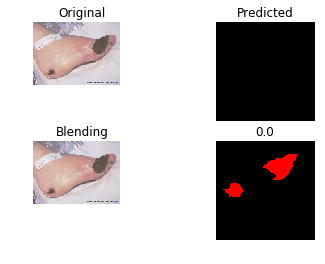

PREDICT... v2_07_s8_to_iPad
../testing_data/features/original_augment/v2_07_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/v2_07_s8_to_iPad_report.png


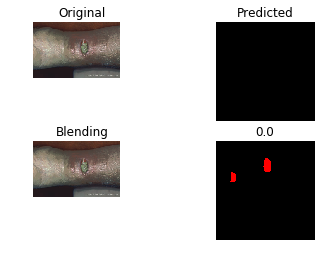

PREDICT... a_04_motoC_to_S8
../testing_data/features/original_augment/a_04_motoC_to_S8.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/a_04_motoC_to_S8_report.png


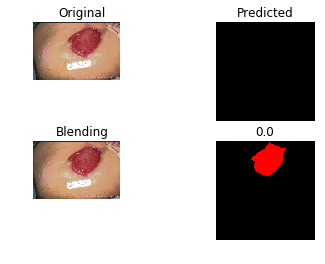

PREDICT... p1_73
../testing_data/features/original_augment/p1_73.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/p1_73_report.png


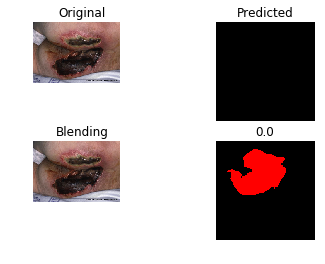

PREDICT... v1_84
../testing_data/features/original_augment/v1_84.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/v1_84_report.png


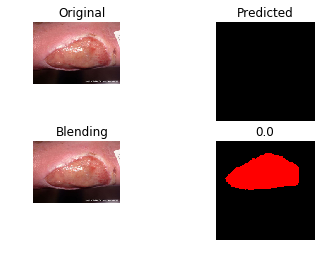

PREDICT... p2_54_s8_to_iPad
../testing_data/features/original_augment/p2_54_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/p2_54_s8_to_iPad_report.png


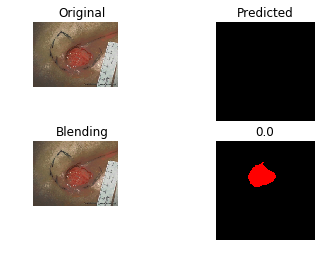

PREDICT... b_20
../testing_data/features/original_augment/b_20.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/b_20_report.png


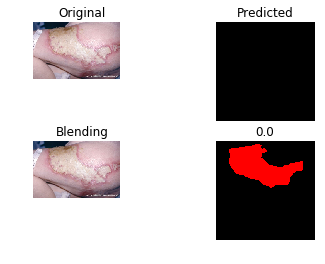

PREDICT... p1_81_motoC_to_S8
../testing_data/features/original_augment/p1_81_motoC_to_S8.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/p1_81_motoC_to_S8_report.png


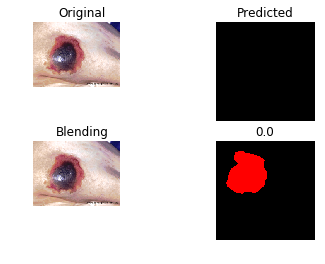

PREDICT... v1_32
../testing_data/features/original_augment/v1_32.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/v1_32_report.png


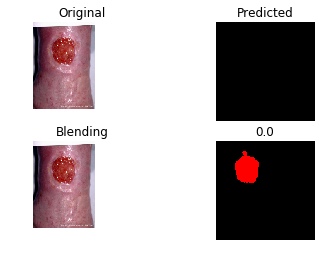

PREDICT... v1_32_motoC_to_S8
../testing_data/features/original_augment/v1_32_motoC_to_S8.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/v1_32_motoC_to_S8_report.png


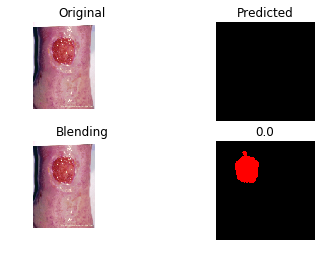

PREDICT... m_25_motoC_to_S8
../testing_data/features/original_augment/m_25_motoC_to_S8.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/m_25_motoC_to_S8_report.png


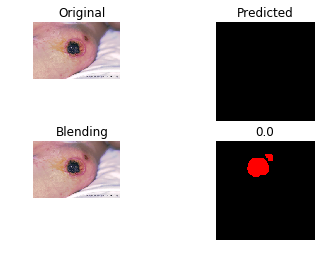

PREDICT... b_12_motoC_to_S8
../testing_data/features/original_augment/b_12_motoC_to_S8.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/b_12_motoC_to_S8_report.png


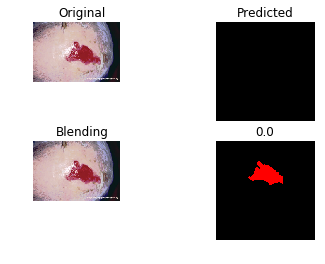

PREDICT... p2_57_s8_to_iPad
../testing_data/features/original_augment/p2_57_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/p2_57_s8_to_iPad_report.png


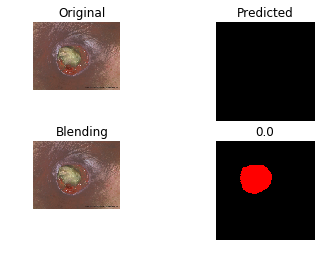

PREDICT... m_25
../testing_data/features/original_augment/m_25.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/m_25_report.png


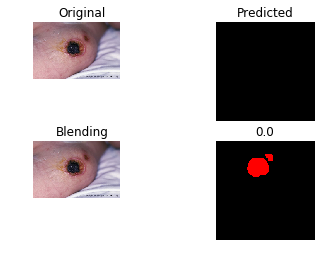

PREDICT... a_04_s8_to_iPad
../testing_data/features/original_augment/a_04_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/a_04_s8_to_iPad_report.png


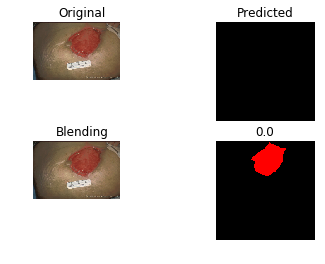

PREDICT... p1_81
../testing_data/features/original_augment/p1_81.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/p1_81_report.png


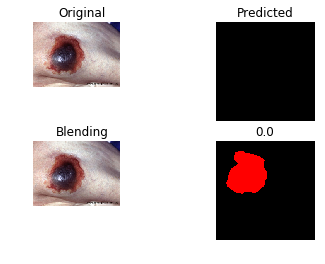

PREDICT... a_05_motoC_to_S8
../testing_data/features/original_augment/a_05_motoC_to_S8.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/a_05_motoC_to_S8_report.png


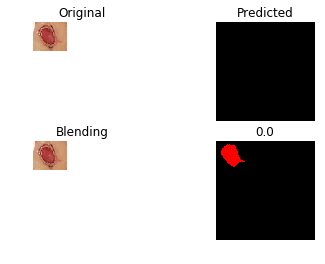

PREDICT... b_11_s8_to_iPad
../testing_data/features/original_augment/b_11_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/b_11_s8_to_iPad_report.png


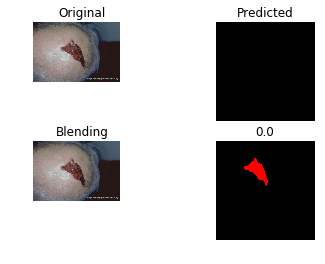

PREDICT... v1_84_s8_to_iPad
../testing_data/features/original_augment/v1_84_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/v1_84_s8_to_iPad_report.png


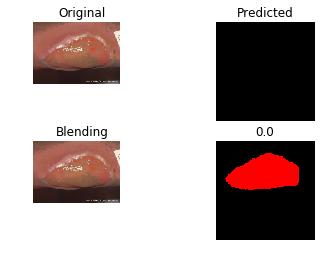

PREDICT... v1_70_motoC_to_S8
../testing_data/features/original_augment/v1_70_motoC_to_S8.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/v1_70_motoC_to_S8_report.png


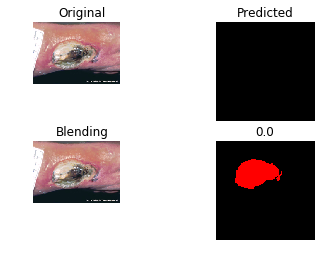

PREDICT... v1_32_s8_to_iPad
../testing_data/features/original_augment/v1_32_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/v1_32_s8_to_iPad_report.png


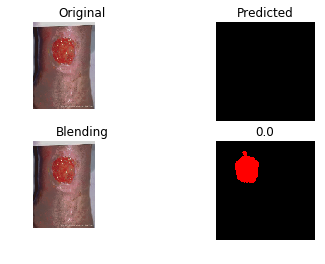

PREDICT... p1_72
../testing_data/features/original_augment/p1_72.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/p1_72_report.png


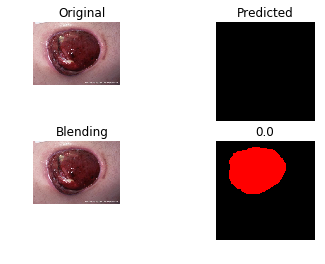

PREDICT... a_05_s8_to_iPad
../testing_data/features/original_augment/a_05_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/a_05_s8_to_iPad_report.png


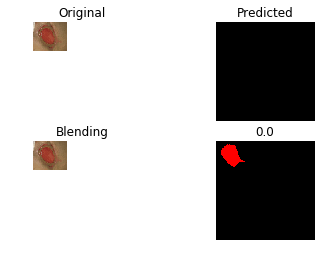

PREDICT... b_05_s8_to_iPad
../testing_data/features/original_augment/b_05_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/b_05_s8_to_iPad_report.png


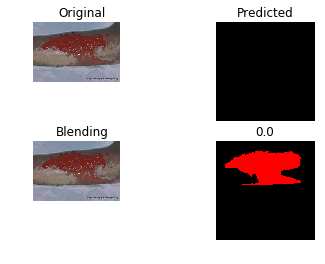

PREDICT... f_18
../testing_data/features/original_augment/f_18.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model8.80/reports/f_18_report.png


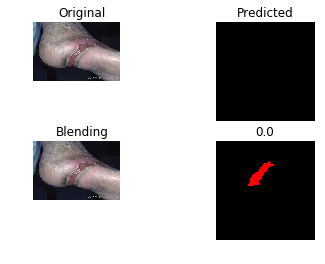

SEGMENTATION REPORT :: iou_avg 0.0, iou_min 0.0
date: 2018-05-08 ,time: 14:55:23


ZeroDivisionError: float division by zero

In [29]:
#k-fold => 1
model_name = 'model8.80.model'
segmentation(root_path, model_name, color_dir_path, gray_dir_path)

Image Dir is ../testing_data/features/original_augment/
Model is ../training_data/model/original_augment/model24.33.model
START : date: 2018-05-08 ,time: 14:55:32
PREDICT... m_47_motoC_to_S8
../testing_data/features/original_augment/m_47_motoC_to_S8.txt
 , IoU = 0.21009289480291238
Saving... ../training_data/model/original_augment/results/model24.33/reports/m_47_motoC_to_S8_report.png


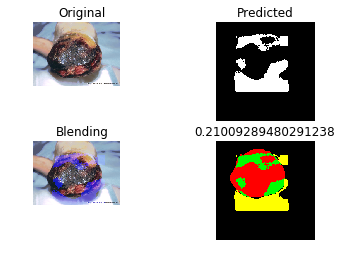

PREDICT... b_12
../testing_data/features/original_augment/b_12.txt
 , IoU = 0.004540295119182747
Saving... ../training_data/model/original_augment/results/model24.33/reports/b_12_report.png


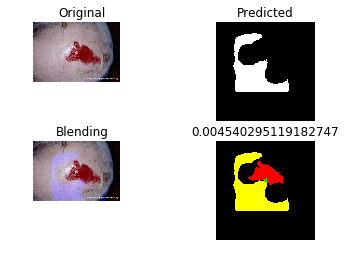

PREDICT... m_03_motoC_to_S8
../testing_data/features/original_augment/m_03_motoC_to_S8.txt
 , IoU = 0.1086762739563215
Saving... ../training_data/model/original_augment/results/model24.33/reports/m_03_motoC_to_S8_report.png


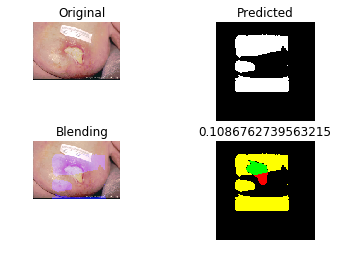

PREDICT... f_41_s8_to_iPad
../testing_data/features/original_augment/f_41_s8_to_iPad.txt
 , IoU = 0.06286701208981002
Saving... ../training_data/model/original_augment/results/model24.33/reports/f_41_s8_to_iPad_report.png


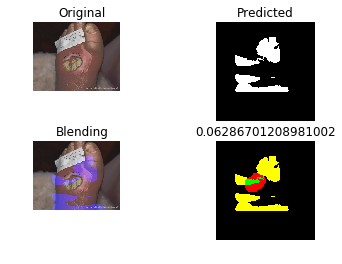

PREDICT... m_03
../testing_data/features/original_augment/m_03.txt
 , IoU = 0.1212043671102013
Saving... ../training_data/model/original_augment/results/model24.33/reports/m_03_report.png


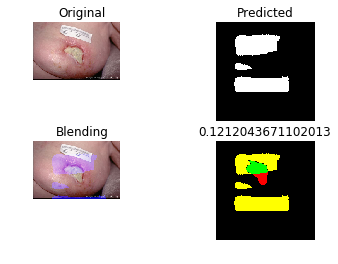

PREDICT... p1_67_s8_to_iPad
../testing_data/features/original_augment/p1_67_s8_to_iPad.txt
 , IoU = 0.1454573983994979
Saving... ../training_data/model/original_augment/results/model24.33/reports/p1_67_s8_to_iPad_report.png


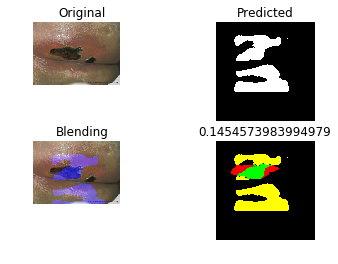

PREDICT... f_50
../testing_data/features/original_augment/f_50.txt
 , IoU = 0.18153465346534653
Saving... ../training_data/model/original_augment/results/model24.33/reports/f_50_report.png


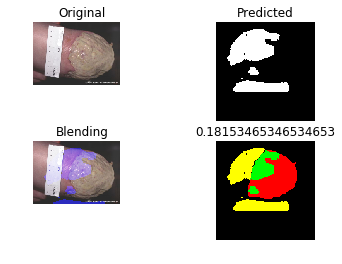

PREDICT... f_35
../testing_data/features/original_augment/f_35.txt
 , IoU = 0.03141767862185823
Saving... ../training_data/model/original_augment/results/model24.33/reports/f_35_report.png


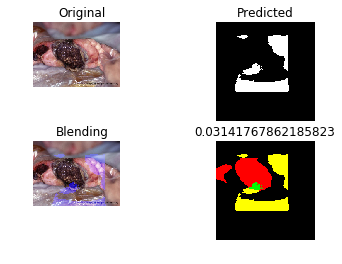

PREDICT... p2_57_motoC_to_S8
../testing_data/features/original_augment/p2_57_motoC_to_S8.txt
 , IoU = 0.17507490980248272
Saving... ../training_data/model/original_augment/results/model24.33/reports/p2_57_motoC_to_S8_report.png


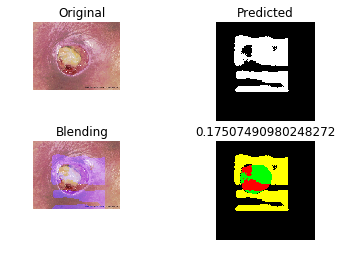

PREDICT... v2_07
../testing_data/features/original_augment/v2_07.txt
 , IoU = 0.009626162062372256
Saving... ../training_data/model/original_augment/results/model24.33/reports/v2_07_report.png


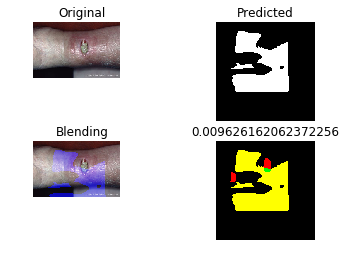

PREDICT... p2_54_motoC_to_S8
../testing_data/features/original_augment/p2_54_motoC_to_S8.txt
 , IoU = 0.06473548211614306
Saving... ../training_data/model/original_augment/results/model24.33/reports/p2_54_motoC_to_S8_report.png


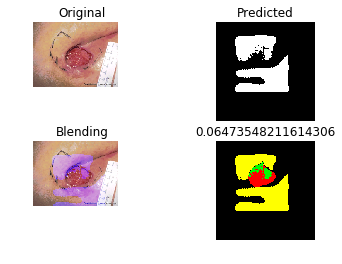

PREDICT... v1_76_motoC_to_S8
../testing_data/features/original_augment/v1_76_motoC_to_S8.txt
 , IoU = 0.15863163972286373
Saving... ../training_data/model/original_augment/results/model24.33/reports/v1_76_motoC_to_S8_report.png


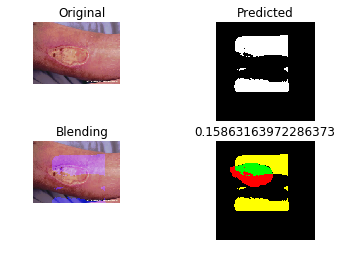

PREDICT... p2_54
../testing_data/features/original_augment/p2_54.txt
 , IoU = 0.00045871559633027525
Saving... ../training_data/model/original_augment/results/model24.33/reports/p2_54_report.png


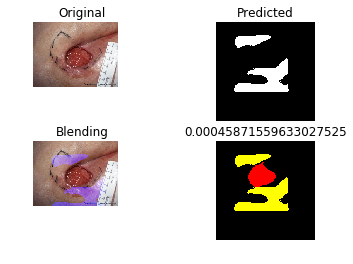

PREDICT... m_47
../testing_data/features/original_augment/m_47.txt
 , IoU = 0.1033665499596014
Saving... ../training_data/model/original_augment/results/model24.33/reports/m_47_report.png


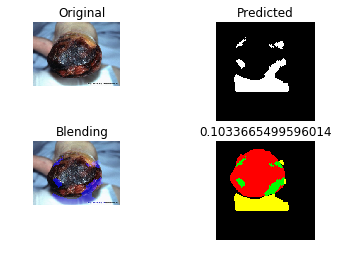

PREDICT... v2_07_motoC_to_S8
../testing_data/features/original_augment/v2_07_motoC_to_S8.txt
 , IoU = 0.016825672159583693
Saving... ../training_data/model/original_augment/results/model24.33/reports/v2_07_motoC_to_S8_report.png


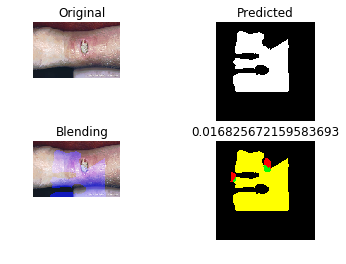

PREDICT... a_04
../testing_data/features/original_augment/a_04.txt
 , IoU = 0.026149146986515683
Saving... ../training_data/model/original_augment/results/model24.33/reports/a_04_report.png


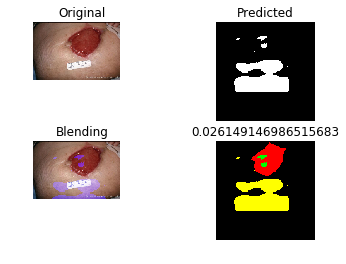

PREDICT... t_25_s8_to_iPad
../testing_data/features/original_augment/t_25_s8_to_iPad.txt
 , IoU = 0.14617719597799278
Saving... ../training_data/model/original_augment/results/model24.33/reports/t_25_s8_to_iPad_report.png


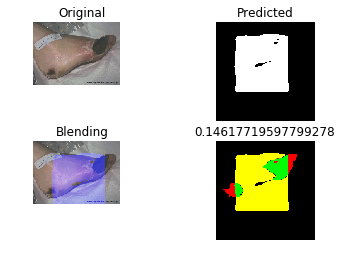

PREDICT... f_41
../testing_data/features/original_augment/f_41.txt
 , IoU = 0.11336775674125071
Saving... ../training_data/model/original_augment/results/model24.33/reports/f_41_report.png


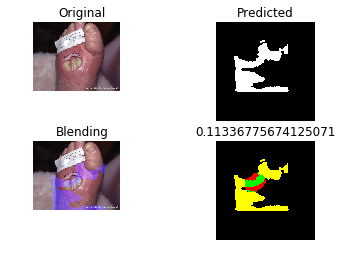

PREDICT... p2_57
../testing_data/features/original_augment/p2_57.txt
 , IoU = 0.09676869298320402
Saving... ../training_data/model/original_augment/results/model24.33/reports/p2_57_report.png


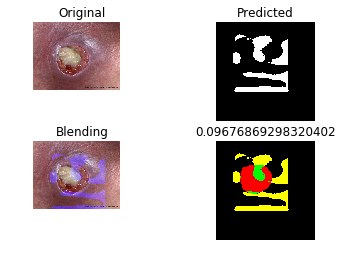

PREDICT... p1_82_s8_to_iPad
../testing_data/features/original_augment/p1_82_s8_to_iPad.txt
 , IoU = 0.3323835153817741
Saving... ../training_data/model/original_augment/results/model24.33/reports/p1_82_s8_to_iPad_report.png


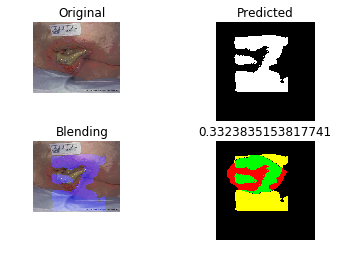

PREDICT... p1_72_motoC_to_S8
../testing_data/features/original_augment/p1_72_motoC_to_S8.txt
 , IoU = 0.13754980079681275
Saving... ../training_data/model/original_augment/results/model24.33/reports/p1_72_motoC_to_S8_report.png


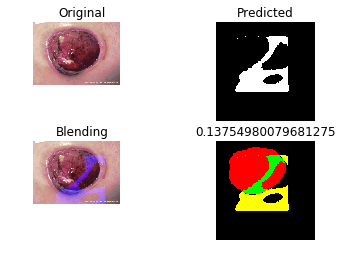

PREDICT... p1_82
../testing_data/features/original_augment/p1_82.txt
 , IoU = 0.31668051516410467
Saving... ../training_data/model/original_augment/results/model24.33/reports/p1_82_report.png


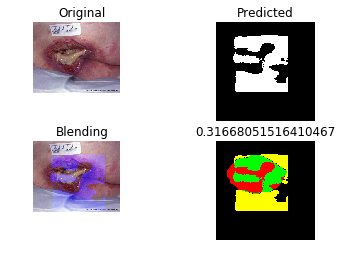

PREDICT... b_20_motoC_to_S8
../testing_data/features/original_augment/b_20_motoC_to_S8.txt
 , IoU = 0.3417590475779666
Saving... ../training_data/model/original_augment/results/model24.33/reports/b_20_motoC_to_S8_report.png


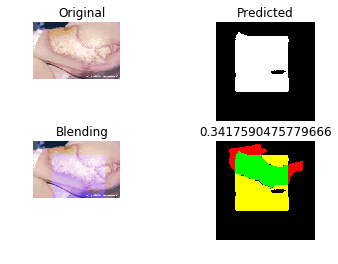

PREDICT... p1_73_s8_to_iPad
../testing_data/features/original_augment/p1_73_s8_to_iPad.txt
 , IoU = 0.13784342688330872
Saving... ../training_data/model/original_augment/results/model24.33/reports/p1_73_s8_to_iPad_report.png


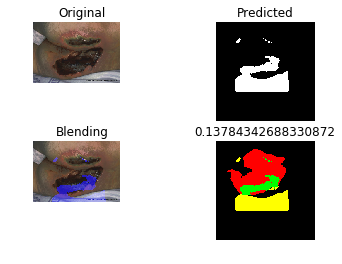

PREDICT... p1_72_s8_to_iPad
../testing_data/features/original_augment/p1_72_s8_to_iPad.txt
 , IoU = 0.14951124405747557
Saving... ../training_data/model/original_augment/results/model24.33/reports/p1_72_s8_to_iPad_report.png


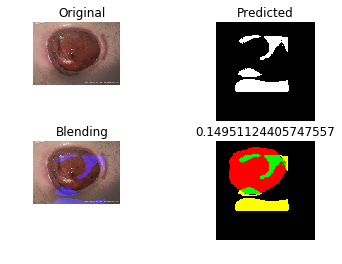

PREDICT... v1_70
../testing_data/features/original_augment/v1_70.txt
 , IoU = 0.08876783796225257
Saving... ../training_data/model/original_augment/results/model24.33/reports/v1_70_report.png


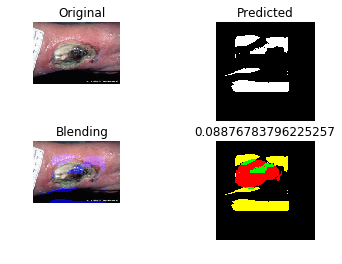

PREDICT... v1_76_s8_to_iPad
../testing_data/features/original_augment/v1_76_s8_to_iPad.txt
 , IoU = 0.1779292343387471
Saving... ../training_data/model/original_augment/results/model24.33/reports/v1_76_s8_to_iPad_report.png


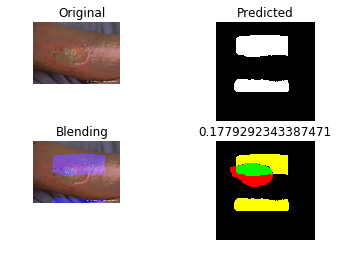

PREDICT... a_05
../testing_data/features/original_augment/a_05.txt
 , IoU = 0.0171900826446281
Saving... ../training_data/model/original_augment/results/model24.33/reports/a_05_report.png


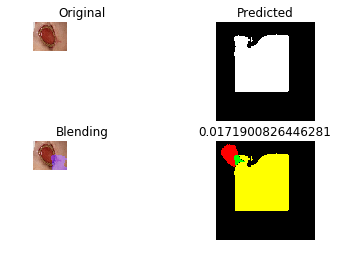

PREDICT... m_43_s8_to_iPad
../testing_data/features/original_augment/m_43_s8_to_iPad.txt
 , IoU = 0.248741402538467
Saving... ../training_data/model/original_augment/results/model24.33/reports/m_43_s8_to_iPad_report.png


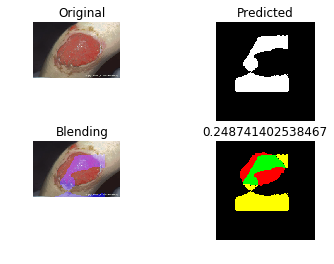

PREDICT... v1_76
../testing_data/features/original_augment/v1_76.txt
 , IoU = 0.13962541314726404
Saving... ../training_data/model/original_augment/results/model24.33/reports/v1_76_report.png


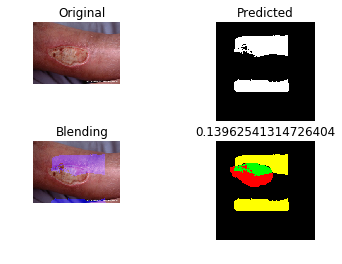

PREDICT... p1_82_motoC_to_S8
../testing_data/features/original_augment/p1_82_motoC_to_S8.txt
 , IoU = 0.42805999032414127
Saving... ../training_data/model/original_augment/results/model24.33/reports/p1_82_motoC_to_S8_report.png


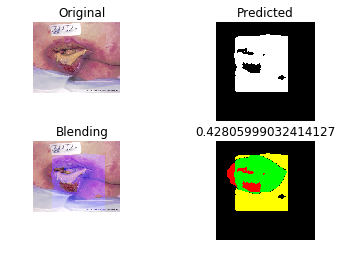

PREDICT... m_47_s8_to_iPad
../testing_data/features/original_augment/m_47_s8_to_iPad.txt
 , IoU = 0.2286928138438423
Saving... ../training_data/model/original_augment/results/model24.33/reports/m_47_s8_to_iPad_report.png


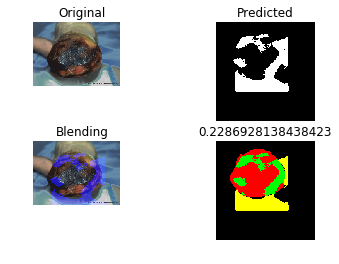

PREDICT... m_25_s8_to_iPad
../testing_data/features/original_augment/m_25_s8_to_iPad.txt
 , IoU = 0.07858048162230671
Saving... ../training_data/model/original_augment/results/model24.33/reports/m_25_s8_to_iPad_report.png


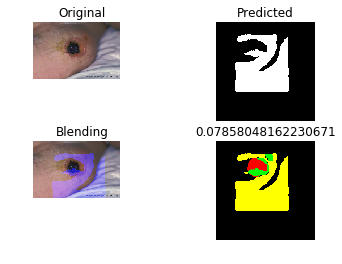

PREDICT... t_25
../testing_data/features/original_augment/t_25.txt
 , IoU = 0.14682669406435342
Saving... ../training_data/model/original_augment/results/model24.33/reports/t_25_report.png


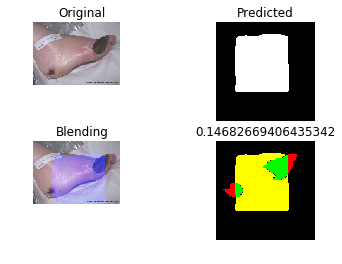

PREDICT... f_50_motoC_to_S8
../testing_data/features/original_augment/f_50_motoC_to_S8.txt
 , IoU = 0.244
Saving... ../training_data/model/original_augment/results/model24.33/reports/f_50_motoC_to_S8_report.png


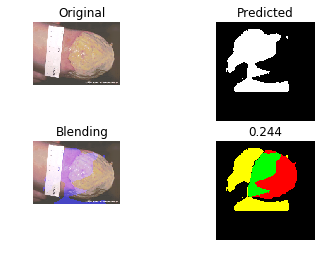

PREDICT... b_11
../testing_data/features/original_augment/b_11.txt
 , IoU = 0.012515788265013204
Saving... ../training_data/model/original_augment/results/model24.33/reports/b_11_report.png


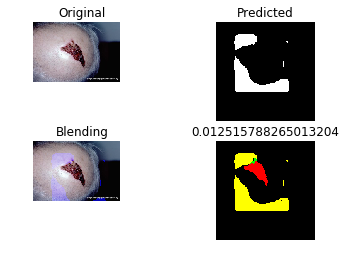

PREDICT... p1_67
../testing_data/features/original_augment/p1_67.txt
 , IoU = 0.07638024076380241
Saving... ../training_data/model/original_augment/results/model24.33/reports/p1_67_report.png


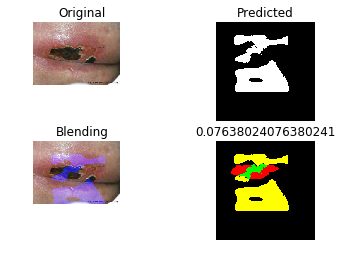

PREDICT... f_18_motoC_to_S8
../testing_data/features/original_augment/f_18_motoC_to_S8.txt
 , IoU = 0.06590959697172122
Saving... ../training_data/model/original_augment/results/model24.33/reports/f_18_motoC_to_S8_report.png


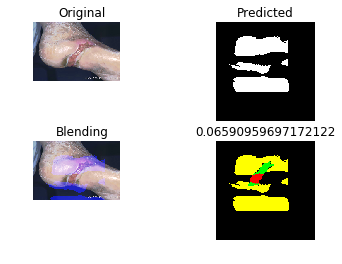

PREDICT... f_41_motoC_to_S8
../testing_data/features/original_augment/f_41_motoC_to_S8.txt
 , IoU = 0.13613702155033772
Saving... ../training_data/model/original_augment/results/model24.33/reports/f_41_motoC_to_S8_report.png


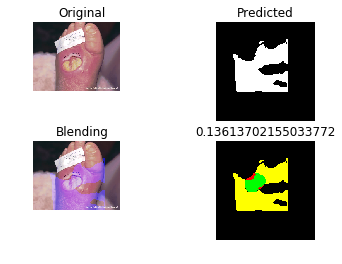

PREDICT... f_50_s8_to_iPad
../testing_data/features/original_augment/f_50_s8_to_iPad.txt
 , IoU = 0.1685622481766716
Saving... ../training_data/model/original_augment/results/model24.33/reports/f_50_s8_to_iPad_report.png


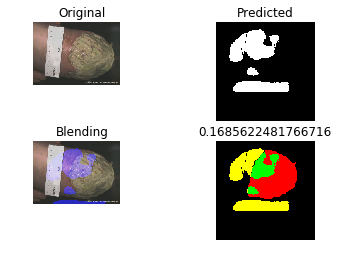

PREDICT... p1_73_motoC_to_S8
../testing_data/features/original_augment/p1_73_motoC_to_S8.txt
 , IoU = 0.1370444627904234
Saving... ../training_data/model/original_augment/results/model24.33/reports/p1_73_motoC_to_S8_report.png


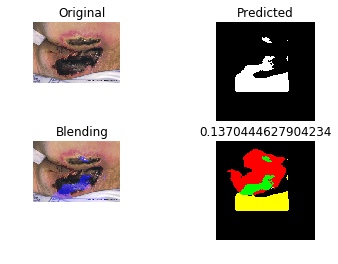

PREDICT... b_20_s8_to_iPad
../testing_data/features/original_augment/b_20_s8_to_iPad.txt
 , IoU = 0.2857207821737153
Saving... ../training_data/model/original_augment/results/model24.33/reports/b_20_s8_to_iPad_report.png


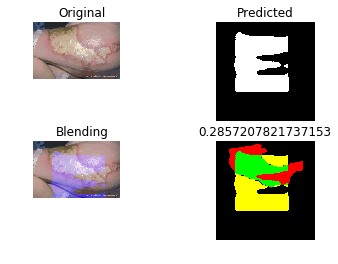

PREDICT... b_05
../testing_data/features/original_augment/b_05.txt
 , IoU = 0.09918137510055364
Saving... ../training_data/model/original_augment/results/model24.33/reports/b_05_report.png


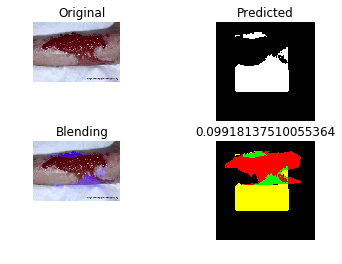

PREDICT... m_03_s8_to_iPad
../testing_data/features/original_augment/m_03_s8_to_iPad.txt
 , IoU = 0.12415817648074598
Saving... ../training_data/model/original_augment/results/model24.33/reports/m_03_s8_to_iPad_report.png


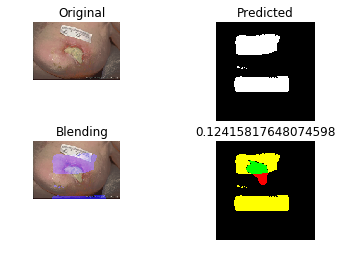

PREDICT... v1_84_motoC_to_S8
../testing_data/features/original_augment/v1_84_motoC_to_S8.txt
 , IoU = 0.20366094058011827
Saving... ../training_data/model/original_augment/results/model24.33/reports/v1_84_motoC_to_S8_report.png


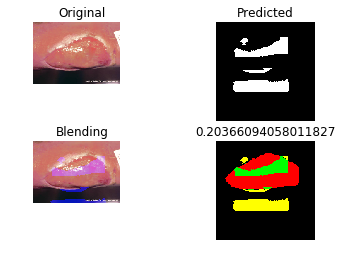

PREDICT... m_43
../testing_data/features/original_augment/m_43.txt
 , IoU = 0.22734905453748996
Saving... ../training_data/model/original_augment/results/model24.33/reports/m_43_report.png


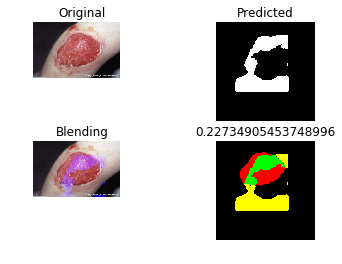

PREDICT... p1_81_s8_to_iPad
../testing_data/features/original_augment/p1_81_s8_to_iPad.txt
 , IoU = 0.21641171008259616
Saving... ../training_data/model/original_augment/results/model24.33/reports/p1_81_s8_to_iPad_report.png


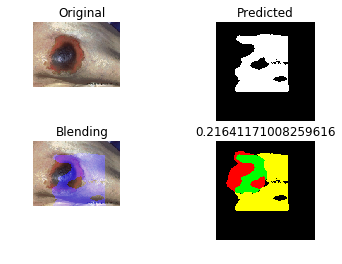

PREDICT... p1_67_motoC_to_S8
../testing_data/features/original_augment/p1_67_motoC_to_S8.txt
 , IoU = 0.11520047875523638
Saving... ../training_data/model/original_augment/results/model24.33/reports/p1_67_motoC_to_S8_report.png


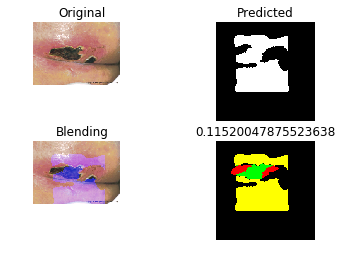

PREDICT... b_05_motoC_to_S8
../testing_data/features/original_augment/b_05_motoC_to_S8.txt
 , IoU = 0.13172804532577903
Saving... ../training_data/model/original_augment/results/model24.33/reports/b_05_motoC_to_S8_report.png


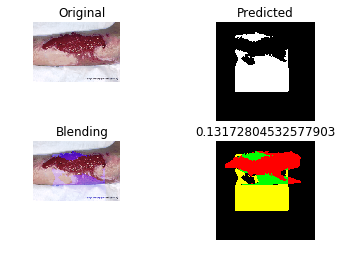

PREDICT... m_43_motoC_to_S8
../testing_data/features/original_augment/m_43_motoC_to_S8.txt
 , IoU = 0.2715737870377046
Saving... ../training_data/model/original_augment/results/model24.33/reports/m_43_motoC_to_S8_report.png


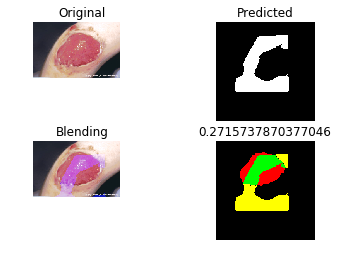

PREDICT... f_35_s8_to_iPad
../testing_data/features/original_augment/f_35_s8_to_iPad.txt
 , IoU = 0.1225756896882801
Saving... ../training_data/model/original_augment/results/model24.33/reports/f_35_s8_to_iPad_report.png


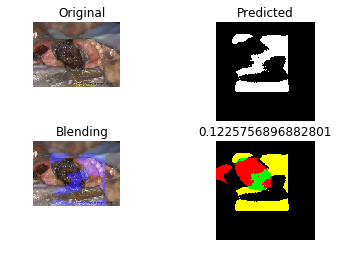

PREDICT... f_35_motoC_to_S8
../testing_data/features/original_augment/f_35_motoC_to_S8.txt
 , IoU = 0.036044362292051754
Saving... ../training_data/model/original_augment/results/model24.33/reports/f_35_motoC_to_S8_report.png


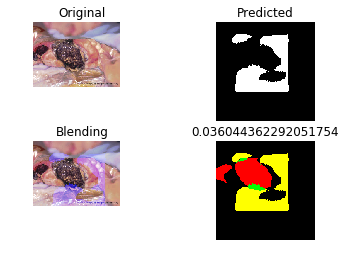

PREDICT... v1_70_s8_to_iPad
../testing_data/features/original_augment/v1_70_s8_to_iPad.txt
 , IoU = 0.090625
Saving... ../training_data/model/original_augment/results/model24.33/reports/v1_70_s8_to_iPad_report.png


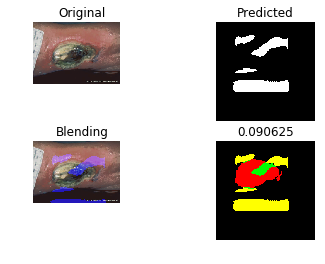

PREDICT... f_18_s8_to_iPad
../testing_data/features/original_augment/f_18_s8_to_iPad.txt
 , IoU = 0.05176848874598071
Saving... ../training_data/model/original_augment/results/model24.33/reports/f_18_s8_to_iPad_report.png


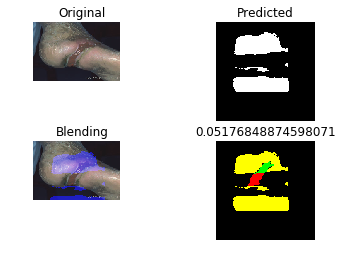

PREDICT... b_11_motoC_to_S8
../testing_data/features/original_augment/b_11_motoC_to_S8.txt
 , IoU = 0.015041782729805013
Saving... ../training_data/model/original_augment/results/model24.33/reports/b_11_motoC_to_S8_report.png


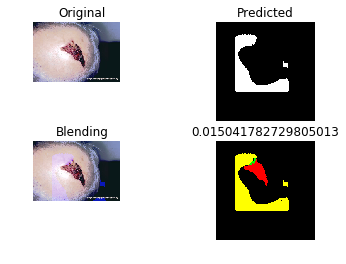

PREDICT... b_12_s8_to_iPad
../testing_data/features/original_augment/b_12_s8_to_iPad.txt
 , IoU = 0.014098827357147698
Saving... ../training_data/model/original_augment/results/model24.33/reports/b_12_s8_to_iPad_report.png


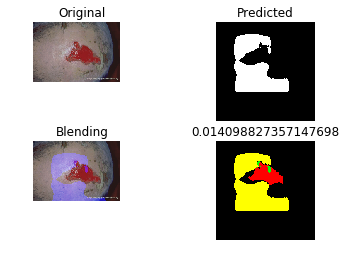

PREDICT... t_25_motoC_to_S8
../testing_data/features/original_augment/t_25_motoC_to_S8.txt
 , IoU = 0.14628475774202548
Saving... ../training_data/model/original_augment/results/model24.33/reports/t_25_motoC_to_S8_report.png


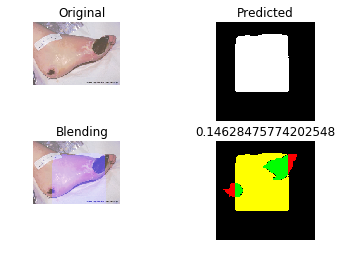

PREDICT... v2_07_s8_to_iPad
../testing_data/features/original_augment/v2_07_s8_to_iPad.txt
 , IoU = 0.009980506822612086
Saving... ../training_data/model/original_augment/results/model24.33/reports/v2_07_s8_to_iPad_report.png


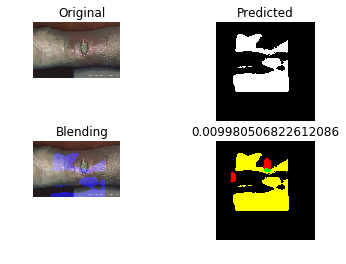

PREDICT... a_04_motoC_to_S8
../testing_data/features/original_augment/a_04_motoC_to_S8.txt
 , IoU = 0.06570532915360501
Saving... ../training_data/model/original_augment/results/model24.33/reports/a_04_motoC_to_S8_report.png


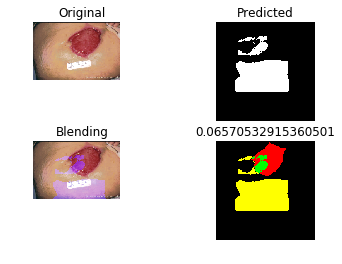

PREDICT... p1_73
../testing_data/features/original_augment/p1_73.txt
 , IoU = 0.08966338993148644
Saving... ../training_data/model/original_augment/results/model24.33/reports/p1_73_report.png


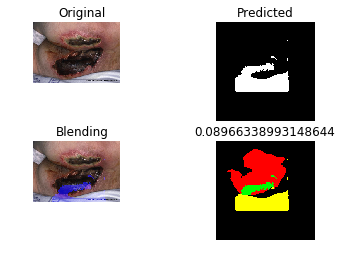

PREDICT... v1_84
../testing_data/features/original_augment/v1_84.txt
 , IoU = 0.23425022182786157
Saving... ../training_data/model/original_augment/results/model24.33/reports/v1_84_report.png


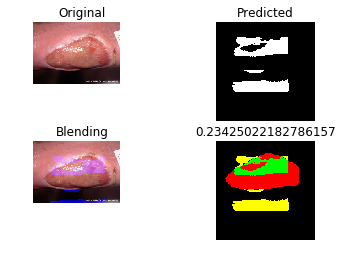

PREDICT... p2_54_s8_to_iPad
../testing_data/features/original_augment/p2_54_s8_to_iPad.txt
 , IoU = 0.1024117441454037
Saving... ../training_data/model/original_augment/results/model24.33/reports/p2_54_s8_to_iPad_report.png


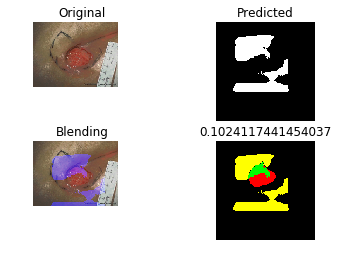

PREDICT... b_20
../testing_data/features/original_augment/b_20.txt
 , IoU = 0.349747079099333
Saving... ../training_data/model/original_augment/results/model24.33/reports/b_20_report.png


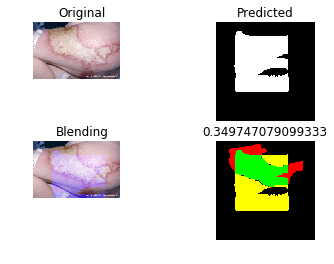

PREDICT... p1_81_motoC_to_S8
../testing_data/features/original_augment/p1_81_motoC_to_S8.txt
 , IoU = 0.2157713531104089
Saving... ../training_data/model/original_augment/results/model24.33/reports/p1_81_motoC_to_S8_report.png


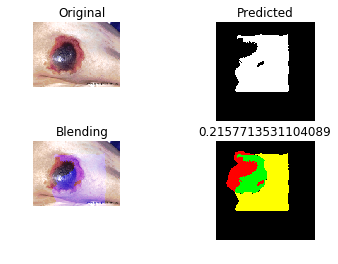

PREDICT... v1_32
../testing_data/features/original_augment/v1_32.txt
 , IoU = 0.014655172413793103
Saving... ../training_data/model/original_augment/results/model24.33/reports/v1_32_report.png


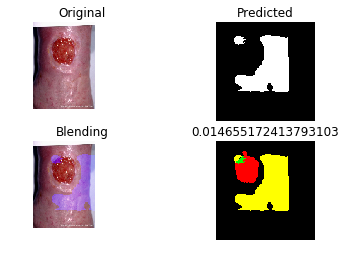

PREDICT... v1_32_motoC_to_S8
../testing_data/features/original_augment/v1_32_motoC_to_S8.txt
 , IoU = 0.018357487922705314
Saving... ../training_data/model/original_augment/results/model24.33/reports/v1_32_motoC_to_S8_report.png


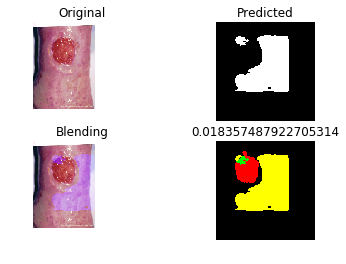

PREDICT... m_25_motoC_to_S8
../testing_data/features/original_augment/m_25_motoC_to_S8.txt
 , IoU = 0.07251347378735913
Saving... ../training_data/model/original_augment/results/model24.33/reports/m_25_motoC_to_S8_report.png


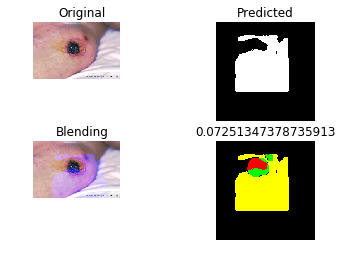

PREDICT... b_12_motoC_to_S8
../testing_data/features/original_augment/b_12_motoC_to_S8.txt
 , IoU = 0.011125027628379872
Saving... ../training_data/model/original_augment/results/model24.33/reports/b_12_motoC_to_S8_report.png


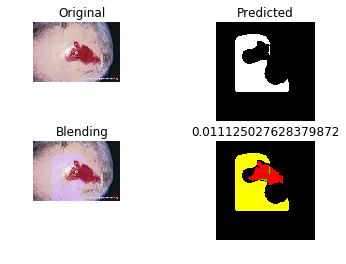

PREDICT... p2_57_s8_to_iPad
../testing_data/features/original_augment/p2_57_s8_to_iPad.txt
 , IoU = 0.11144313587625242
Saving... ../training_data/model/original_augment/results/model24.33/reports/p2_57_s8_to_iPad_report.png


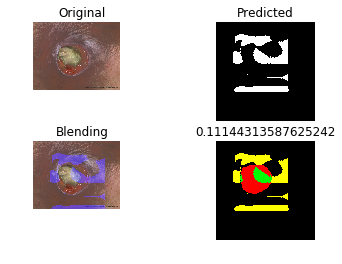

PREDICT... m_25
../testing_data/features/original_augment/m_25.txt
 , IoU = 0.059998814252682754
Saving... ../training_data/model/original_augment/results/model24.33/reports/m_25_report.png


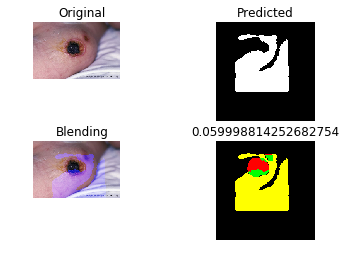

PREDICT... a_04_s8_to_iPad
../testing_data/features/original_augment/a_04_s8_to_iPad.txt
 , IoU = 0.03821656050955414
Saving... ../training_data/model/original_augment/results/model24.33/reports/a_04_s8_to_iPad_report.png


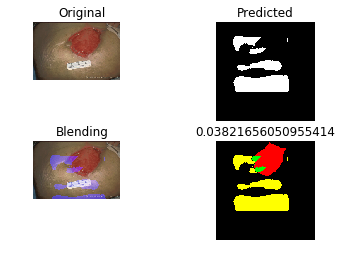

PREDICT... p1_81
../testing_data/features/original_augment/p1_81.txt
 , IoU = 0.1491522129913035
Saving... ../training_data/model/original_augment/results/model24.33/reports/p1_81_report.png


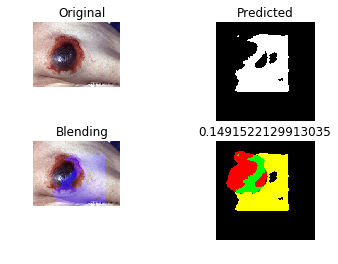

PREDICT... a_05_motoC_to_S8
../testing_data/features/original_augment/a_05_motoC_to_S8.txt
 , IoU = 0.01501929083226162
Saving... ../training_data/model/original_augment/results/model24.33/reports/a_05_motoC_to_S8_report.png


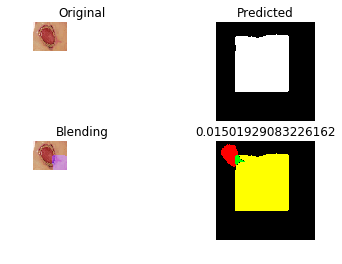

PREDICT... b_11_s8_to_iPad
../testing_data/features/original_augment/b_11_s8_to_iPad.txt
 , IoU = 0.01380268642890227
Saving... ../training_data/model/original_augment/results/model24.33/reports/b_11_s8_to_iPad_report.png


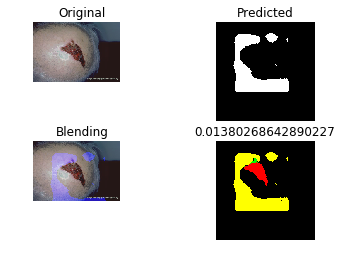

PREDICT... v1_84_s8_to_iPad
../testing_data/features/original_augment/v1_84_s8_to_iPad.txt
 , IoU = 0.20728826903610392
Saving... ../training_data/model/original_augment/results/model24.33/reports/v1_84_s8_to_iPad_report.png


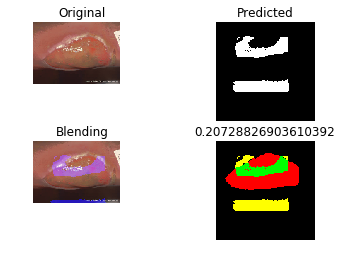

PREDICT... v1_70_motoC_to_S8
../testing_data/features/original_augment/v1_70_motoC_to_S8.txt
 , IoU = 0.20556902505326574
Saving... ../training_data/model/original_augment/results/model24.33/reports/v1_70_motoC_to_S8_report.png


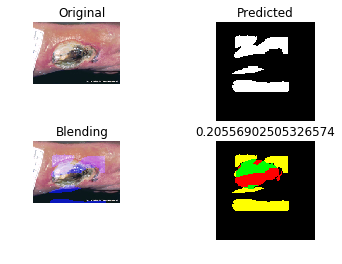

PREDICT... v1_32_s8_to_iPad
../testing_data/features/original_augment/v1_32_s8_to_iPad.txt
 , IoU = 0.05207218229087016
Saving... ../training_data/model/original_augment/results/model24.33/reports/v1_32_s8_to_iPad_report.png


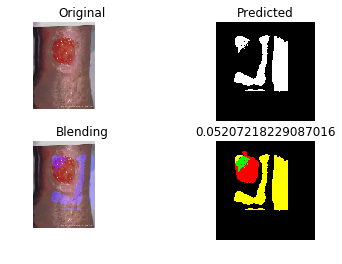

PREDICT... p1_72
../testing_data/features/original_augment/p1_72.txt
 , IoU = 0.1041644477580147
Saving... ../training_data/model/original_augment/results/model24.33/reports/p1_72_report.png


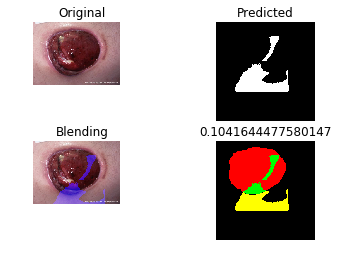

PREDICT... a_05_s8_to_iPad
../testing_data/features/original_augment/a_05_s8_to_iPad.txt
 , IoU = 0.009083728278041074
Saving... ../training_data/model/original_augment/results/model24.33/reports/a_05_s8_to_iPad_report.png


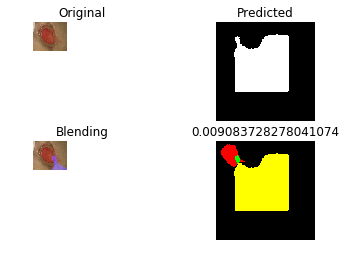

PREDICT... b_05_s8_to_iPad
../testing_data/features/original_augment/b_05_s8_to_iPad.txt
 , IoU = 0.14796891722116234
Saving... ../training_data/model/original_augment/results/model24.33/reports/b_05_s8_to_iPad_report.png


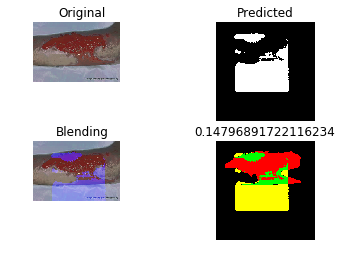

PREDICT... f_18
../testing_data/features/original_augment/f_18.txt
 , IoU = 0.059184378780024194
Saving... ../training_data/model/original_augment/results/model24.33/reports/f_18_report.png


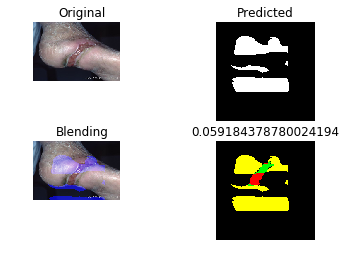

SEGMENTATION REPORT :: iou_avg 0.12464482778172221, iou_min 0.00045871559633027525
date: 2018-05-08 ,time: 14:57:10
	wound	not wound
    wound	176805	790729
not wound	337392	4003490
precision => 18.27
recall => 34.38
f-measure => 23.86
accuracy => 78.75
all sample => 5308416


In [30]:
#k-fold => 2
model_name = 'model24.33.model'
segmentation(root_path, model_name, color_dir_path, gray_dir_path)

Image Dir is ../testing_data/features/original_augment/
Model is ../training_data/model/original_augment/model23.05.model
START : date: 2018-05-08 ,time: 14:57:35
PREDICT... m_47_motoC_to_S8
../testing_data/features/original_augment/m_47_motoC_to_S8.txt
 , IoU = 0.06702412868632708
Saving... ../training_data/model/original_augment/results/model23.05/reports/m_47_motoC_to_S8_report.png


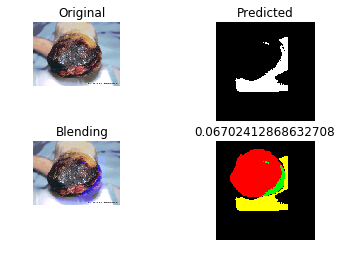

PREDICT... b_12
../testing_data/features/original_augment/b_12.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model23.05/reports/b_12_report.png


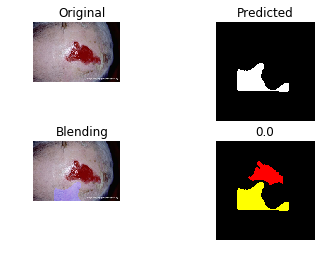

PREDICT... m_03_motoC_to_S8
../testing_data/features/original_augment/m_03_motoC_to_S8.txt
 , IoU = 0.1453619355470663
Saving... ../training_data/model/original_augment/results/model23.05/reports/m_03_motoC_to_S8_report.png


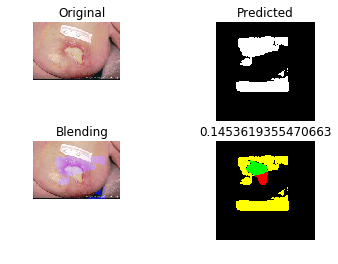

PREDICT... f_41_s8_to_iPad
../testing_data/features/original_augment/f_41_s8_to_iPad.txt
 , IoU = 0.23613787197602226
Saving... ../training_data/model/original_augment/results/model23.05/reports/f_41_s8_to_iPad_report.png


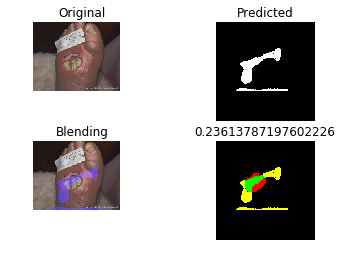

PREDICT... m_03
../testing_data/features/original_augment/m_03.txt
 , IoU = 0.1477475335789849
Saving... ../training_data/model/original_augment/results/model23.05/reports/m_03_report.png


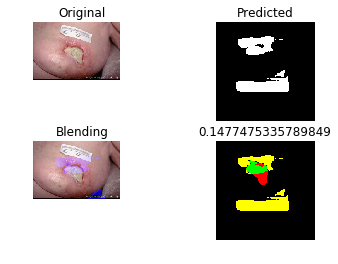

PREDICT... p1_67_s8_to_iPad
../testing_data/features/original_augment/p1_67_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model23.05/reports/p1_67_s8_to_iPad_report.png


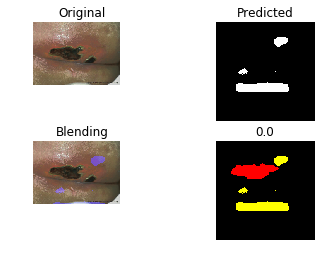

PREDICT... f_50
../testing_data/features/original_augment/f_50.txt
 , IoU = 0.06604152712659075
Saving... ../training_data/model/original_augment/results/model23.05/reports/f_50_report.png


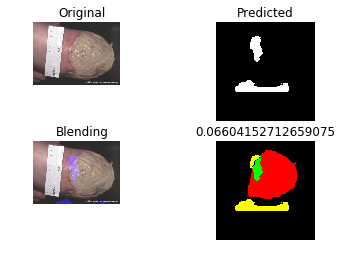

PREDICT... f_35
../testing_data/features/original_augment/f_35.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model23.05/reports/f_35_report.png


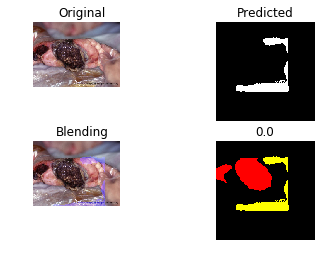

PREDICT... p2_57_motoC_to_S8
../testing_data/features/original_augment/p2_57_motoC_to_S8.txt
 , IoU = 0.08298045602605864
Saving... ../training_data/model/original_augment/results/model23.05/reports/p2_57_motoC_to_S8_report.png


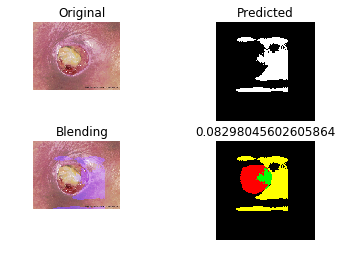

PREDICT... v2_07
../testing_data/features/original_augment/v2_07.txt
 , IoU = 0.007581437973839873
Saving... ../training_data/model/original_augment/results/model23.05/reports/v2_07_report.png


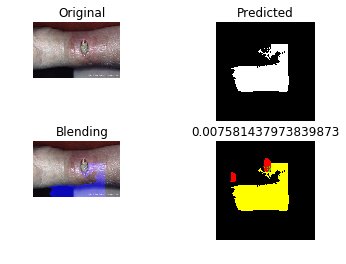

PREDICT... p2_54_motoC_to_S8
../testing_data/features/original_augment/p2_54_motoC_to_S8.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model23.05/reports/p2_54_motoC_to_S8_report.png


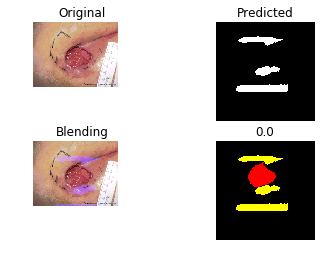

PREDICT... v1_76_motoC_to_S8
../testing_data/features/original_augment/v1_76_motoC_to_S8.txt
 , IoU = 0.07742041083558393
Saving... ../training_data/model/original_augment/results/model23.05/reports/v1_76_motoC_to_S8_report.png


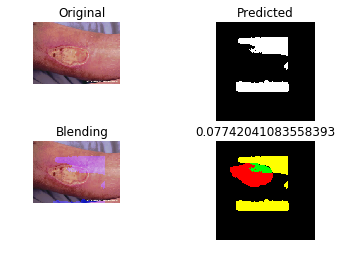

PREDICT... p2_54
../testing_data/features/original_augment/p2_54.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model23.05/reports/p2_54_report.png


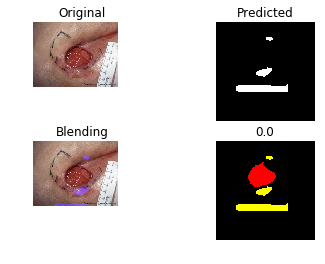

PREDICT... m_47
../testing_data/features/original_augment/m_47.txt
 , IoU = 0.03166986564299424
Saving... ../training_data/model/original_augment/results/model23.05/reports/m_47_report.png


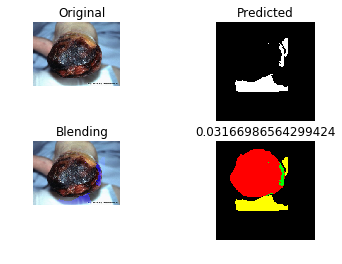

PREDICT... v2_07_motoC_to_S8
../testing_data/features/original_augment/v2_07_motoC_to_S8.txt
 , IoU = 0.025646879756468798
Saving... ../training_data/model/original_augment/results/model23.05/reports/v2_07_motoC_to_S8_report.png


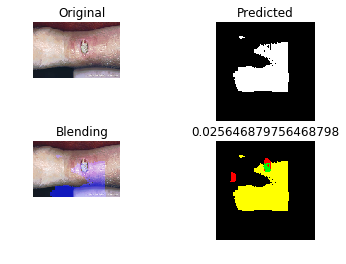

PREDICT... a_04
../testing_data/features/original_augment/a_04.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model23.05/reports/a_04_report.png


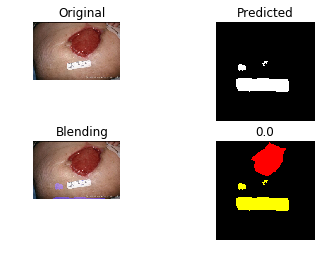

PREDICT... t_25_s8_to_iPad
../testing_data/features/original_augment/t_25_s8_to_iPad.txt
 , IoU = 0.11752392344497607
Saving... ../training_data/model/original_augment/results/model23.05/reports/t_25_s8_to_iPad_report.png


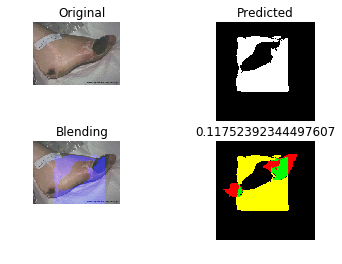

PREDICT... f_41
../testing_data/features/original_augment/f_41.txt
 , IoU = 0.3413087345056212
Saving... ../training_data/model/original_augment/results/model23.05/reports/f_41_report.png


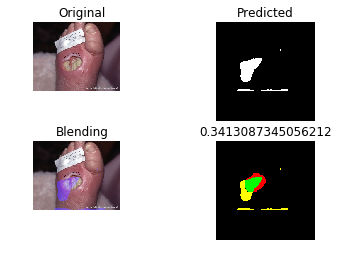

PREDICT... p2_57
../testing_data/features/original_augment/p2_57.txt
 , IoU = 0.013873970640887934
Saving... ../training_data/model/original_augment/results/model23.05/reports/p2_57_report.png


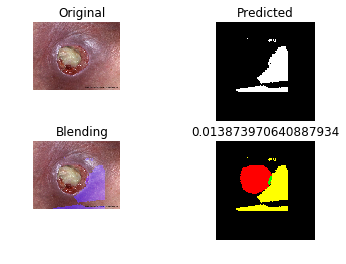

PREDICT... p1_82_s8_to_iPad
../testing_data/features/original_augment/p1_82_s8_to_iPad.txt
 , IoU = 0.22133549473159175
Saving... ../training_data/model/original_augment/results/model23.05/reports/p1_82_s8_to_iPad_report.png


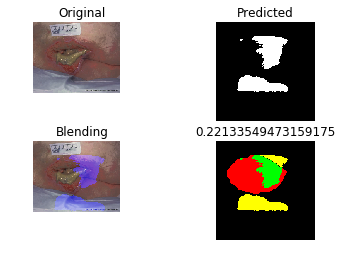

PREDICT... p1_72_motoC_to_S8
../testing_data/features/original_augment/p1_72_motoC_to_S8.txt
 , IoU = 0.09553649956024626
Saving... ../training_data/model/original_augment/results/model23.05/reports/p1_72_motoC_to_S8_report.png


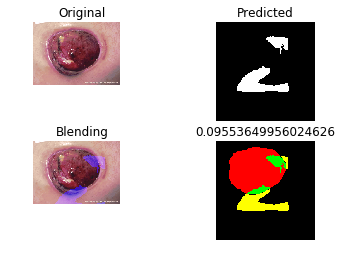

PREDICT... p1_82
../testing_data/features/original_augment/p1_82.txt
 , IoU = 0.10950463640800391
Saving... ../training_data/model/original_augment/results/model23.05/reports/p1_82_report.png


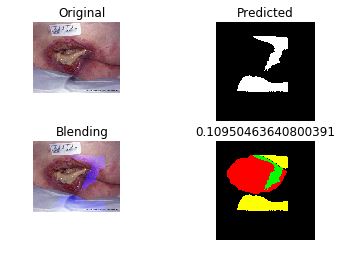

PREDICT... b_20_motoC_to_S8
../testing_data/features/original_augment/b_20_motoC_to_S8.txt
 , IoU = 0.31783610069630425
Saving... ../training_data/model/original_augment/results/model23.05/reports/b_20_motoC_to_S8_report.png


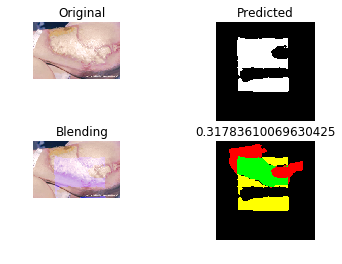

PREDICT... p1_73_s8_to_iPad
../testing_data/features/original_augment/p1_73_s8_to_iPad.txt
 , IoU = 0.0769142331570476
Saving... ../training_data/model/original_augment/results/model23.05/reports/p1_73_s8_to_iPad_report.png


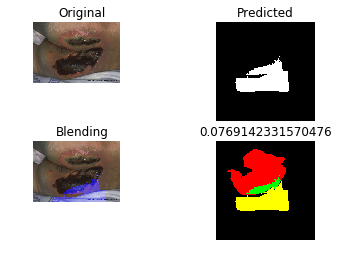

PREDICT... p1_72_s8_to_iPad
../testing_data/features/original_augment/p1_72_s8_to_iPad.txt
 , IoU = 0.07863115344149732
Saving... ../training_data/model/original_augment/results/model23.05/reports/p1_72_s8_to_iPad_report.png


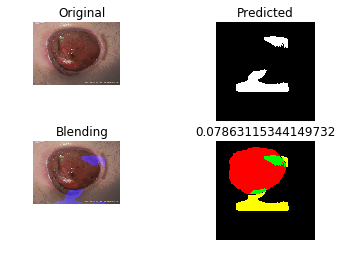

PREDICT... v1_70
../testing_data/features/original_augment/v1_70.txt
 , IoU = 0.004487179487179487
Saving... ../training_data/model/original_augment/results/model23.05/reports/v1_70_report.png


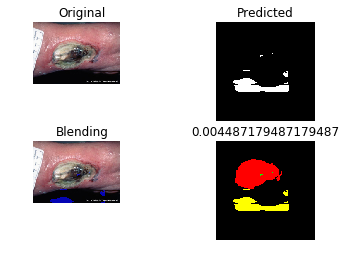

PREDICT... v1_76_s8_to_iPad
../testing_data/features/original_augment/v1_76_s8_to_iPad.txt
 , IoU = 0.05193578847969783
Saving... ../training_data/model/original_augment/results/model23.05/reports/v1_76_s8_to_iPad_report.png


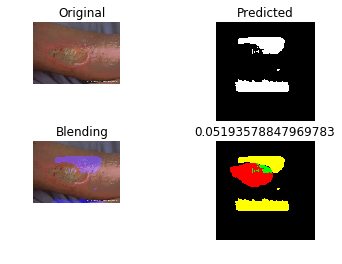

PREDICT... a_05
../testing_data/features/original_augment/a_05.txt
 , IoU = 0.0012039621299184588
Saving... ../training_data/model/original_augment/results/model23.05/reports/a_05_report.png


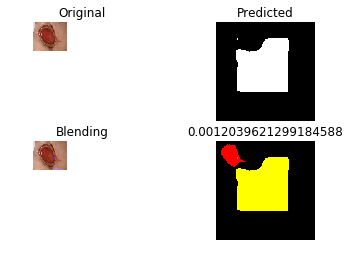

PREDICT... m_43_s8_to_iPad
../testing_data/features/original_augment/m_43_s8_to_iPad.txt
 , IoU = 0.08236332985470017
Saving... ../training_data/model/original_augment/results/model23.05/reports/m_43_s8_to_iPad_report.png


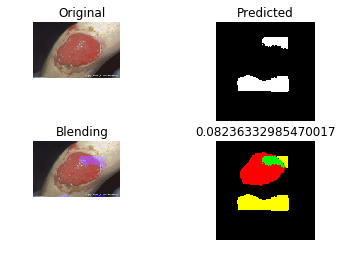

PREDICT... v1_76
../testing_data/features/original_augment/v1_76.txt
 , IoU = 0.009353814468377242
Saving... ../training_data/model/original_augment/results/model23.05/reports/v1_76_report.png


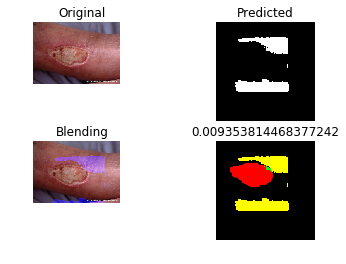

PREDICT... p1_82_motoC_to_S8
../testing_data/features/original_augment/p1_82_motoC_to_S8.txt
 , IoU = 0.24991210594163835
Saving... ../training_data/model/original_augment/results/model23.05/reports/p1_82_motoC_to_S8_report.png


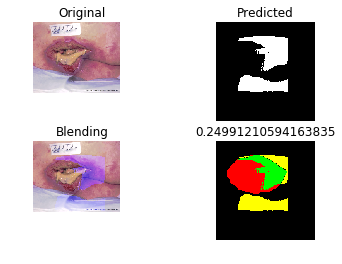

PREDICT... m_47_s8_to_iPad
../testing_data/features/original_augment/m_47_s8_to_iPad.txt
 , IoU = 0.04771172774286826
Saving... ../training_data/model/original_augment/results/model23.05/reports/m_47_s8_to_iPad_report.png


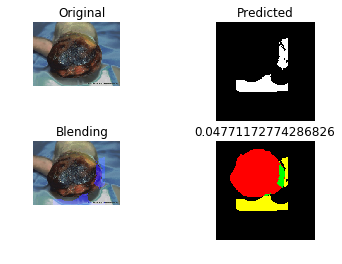

PREDICT... m_25_s8_to_iPad
../testing_data/features/original_augment/m_25_s8_to_iPad.txt
 , IoU = 0.0897822445561139
Saving... ../training_data/model/original_augment/results/model23.05/reports/m_25_s8_to_iPad_report.png


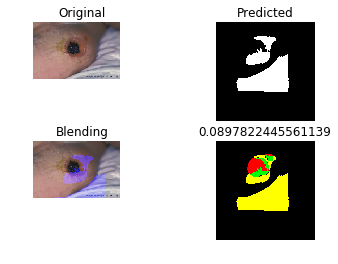

PREDICT... t_25
../testing_data/features/original_augment/t_25.txt
 , IoU = 0.12489880883543425
Saving... ../training_data/model/original_augment/results/model23.05/reports/t_25_report.png


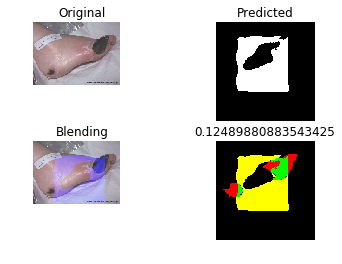

PREDICT... f_50_motoC_to_S8
../testing_data/features/original_augment/f_50_motoC_to_S8.txt
 , IoU = 0.12348524762908325
Saving... ../training_data/model/original_augment/results/model23.05/reports/f_50_motoC_to_S8_report.png


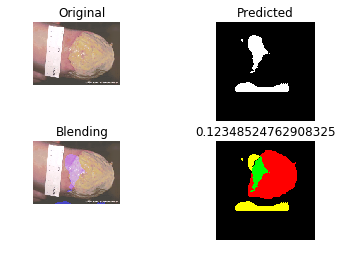

PREDICT... b_11
../testing_data/features/original_augment/b_11.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model23.05/reports/b_11_report.png


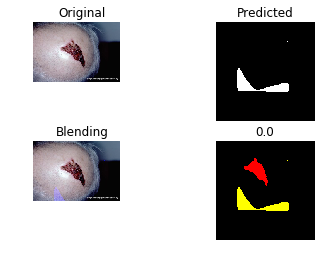

PREDICT... p1_67
../testing_data/features/original_augment/p1_67.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model23.05/reports/p1_67_report.png


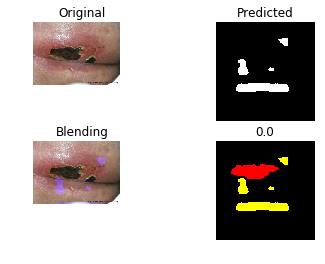

PREDICT... f_18_motoC_to_S8
../testing_data/features/original_augment/f_18_motoC_to_S8.txt
 , IoU = 0.013289036544850499
Saving... ../training_data/model/original_augment/results/model23.05/reports/f_18_motoC_to_S8_report.png


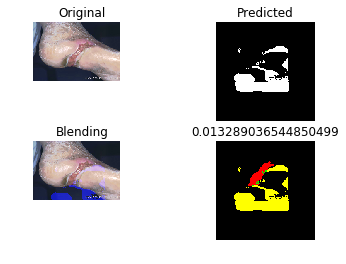

PREDICT... f_41_motoC_to_S8
../testing_data/features/original_augment/f_41_motoC_to_S8.txt
 , IoU = 0.26925082565617936
Saving... ../training_data/model/original_augment/results/model23.05/reports/f_41_motoC_to_S8_report.png


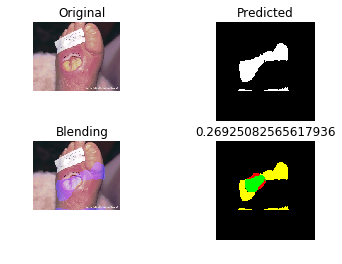

PREDICT... f_50_s8_to_iPad
../testing_data/features/original_augment/f_50_s8_to_iPad.txt
 , IoU = 0.052365762892078685
Saving... ../training_data/model/original_augment/results/model23.05/reports/f_50_s8_to_iPad_report.png


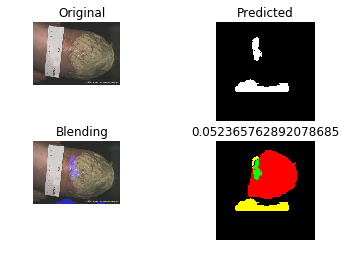

PREDICT... p1_73_motoC_to_S8
../testing_data/features/original_augment/p1_73_motoC_to_S8.txt
 , IoU = 0.08178177094609222
Saving... ../training_data/model/original_augment/results/model23.05/reports/p1_73_motoC_to_S8_report.png


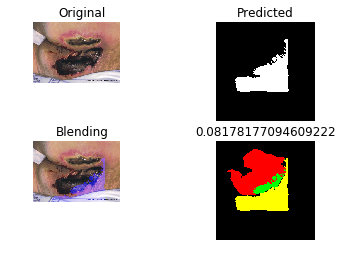

PREDICT... b_20_s8_to_iPad
../testing_data/features/original_augment/b_20_s8_to_iPad.txt
 , IoU = 0.23846535472134944
Saving... ../training_data/model/original_augment/results/model23.05/reports/b_20_s8_to_iPad_report.png


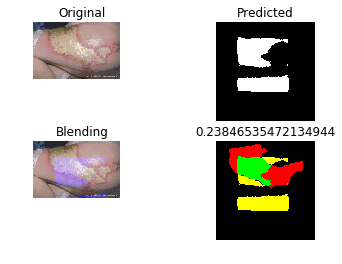

PREDICT... b_05
../testing_data/features/original_augment/b_05.txt
 , IoU = 0.0721745071247316
Saving... ../training_data/model/original_augment/results/model23.05/reports/b_05_report.png


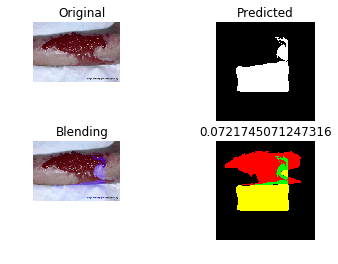

PREDICT... m_03_s8_to_iPad
../testing_data/features/original_augment/m_03_s8_to_iPad.txt
 , IoU = 0.09590126811594203
Saving... ../training_data/model/original_augment/results/model23.05/reports/m_03_s8_to_iPad_report.png


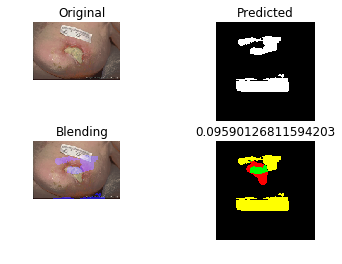

PREDICT... v1_84_motoC_to_S8
../testing_data/features/original_augment/v1_84_motoC_to_S8.txt
 , IoU = 0.014309464434152713
Saving... ../training_data/model/original_augment/results/model23.05/reports/v1_84_motoC_to_S8_report.png


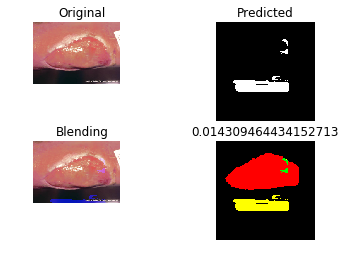

PREDICT... m_43
../testing_data/features/original_augment/m_43.txt
 , IoU = 0.0549394301313769
Saving... ../training_data/model/original_augment/results/model23.05/reports/m_43_report.png


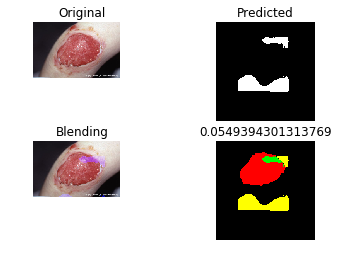

PREDICT... p1_81_s8_to_iPad
../testing_data/features/original_augment/p1_81_s8_to_iPad.txt
 , IoU = 0.16262103727284785
Saving... ../training_data/model/original_augment/results/model23.05/reports/p1_81_s8_to_iPad_report.png


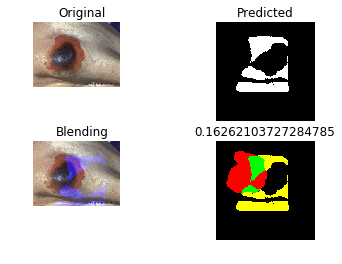

PREDICT... p1_67_motoC_to_S8
../testing_data/features/original_augment/p1_67_motoC_to_S8.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model23.05/reports/p1_67_motoC_to_S8_report.png


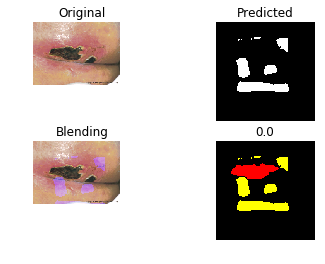

PREDICT... b_05_motoC_to_S8
../testing_data/features/original_augment/b_05_motoC_to_S8.txt
 , IoU = 0.08056848811565792
Saving... ../training_data/model/original_augment/results/model23.05/reports/b_05_motoC_to_S8_report.png


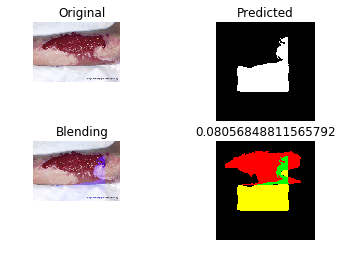

PREDICT... m_43_motoC_to_S8
../testing_data/features/original_augment/m_43_motoC_to_S8.txt
 , IoU = 0.09703038674033149
Saving... ../training_data/model/original_augment/results/model23.05/reports/m_43_motoC_to_S8_report.png


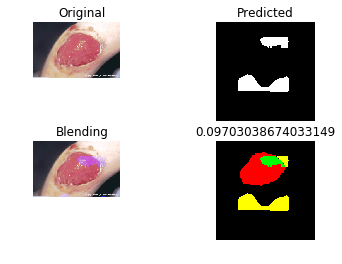

PREDICT... f_35_s8_to_iPad
../testing_data/features/original_augment/f_35_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model23.05/reports/f_35_s8_to_iPad_report.png


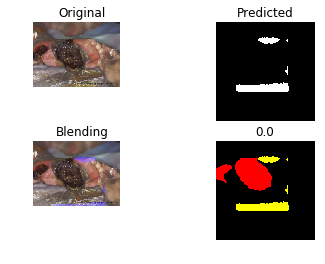

PREDICT... f_35_motoC_to_S8
../testing_data/features/original_augment/f_35_motoC_to_S8.txt
 , IoU = 0.008176376113301211
Saving... ../training_data/model/original_augment/results/model23.05/reports/f_35_motoC_to_S8_report.png


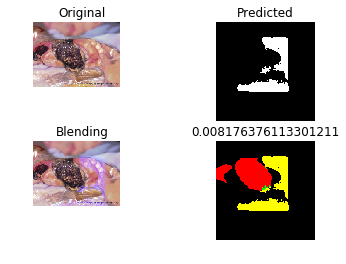

PREDICT... v1_70_s8_to_iPad
../testing_data/features/original_augment/v1_70_s8_to_iPad.txt
 , IoU = 0.008276393032431913
Saving... ../training_data/model/original_augment/results/model23.05/reports/v1_70_s8_to_iPad_report.png


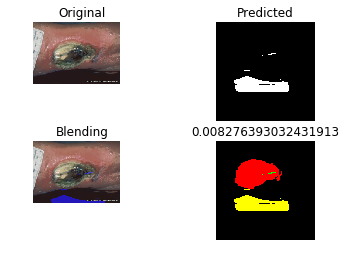

PREDICT... f_18_s8_to_iPad
../testing_data/features/original_augment/f_18_s8_to_iPad.txt
 , IoU = 0.03890489913544669
Saving... ../training_data/model/original_augment/results/model23.05/reports/f_18_s8_to_iPad_report.png


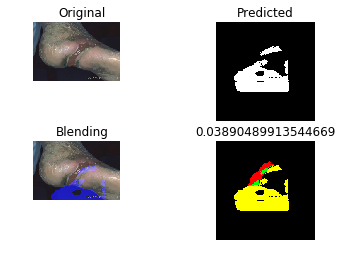

PREDICT... b_11_motoC_to_S8
../testing_data/features/original_augment/b_11_motoC_to_S8.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model23.05/reports/b_11_motoC_to_S8_report.png


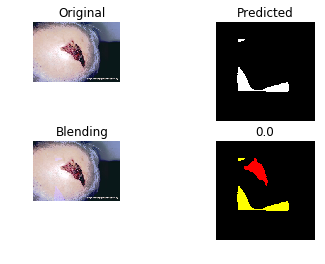

PREDICT... b_12_s8_to_iPad
../testing_data/features/original_augment/b_12_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model23.05/reports/b_12_s8_to_iPad_report.png


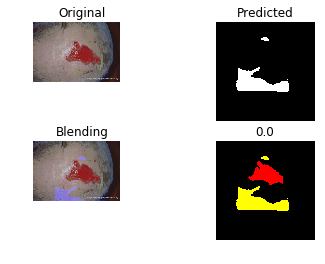

PREDICT... t_25_motoC_to_S8
../testing_data/features/original_augment/t_25_motoC_to_S8.txt
 , IoU = 0.12814760809825584
Saving... ../training_data/model/original_augment/results/model23.05/reports/t_25_motoC_to_S8_report.png


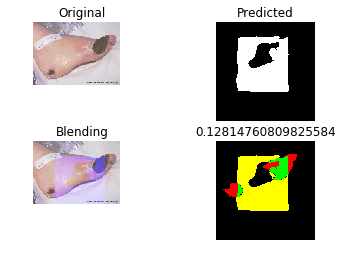

PREDICT... v2_07_s8_to_iPad
../testing_data/features/original_augment/v2_07_s8_to_iPad.txt
 , IoU = 0.0017336745645174605
Saving... ../training_data/model/original_augment/results/model23.05/reports/v2_07_s8_to_iPad_report.png


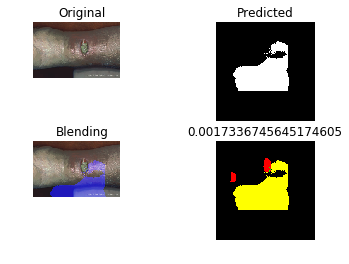

PREDICT... a_04_motoC_to_S8
../testing_data/features/original_augment/a_04_motoC_to_S8.txt
 , IoU = 0.002701242571582928
Saving... ../training_data/model/original_augment/results/model23.05/reports/a_04_motoC_to_S8_report.png


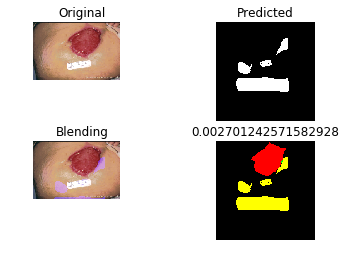

PREDICT... p1_73
../testing_data/features/original_augment/p1_73.txt
 , IoU = 0.03861510381017568
Saving... ../training_data/model/original_augment/results/model23.05/reports/p1_73_report.png


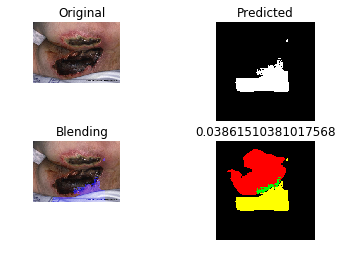

PREDICT... v1_84
../testing_data/features/original_augment/v1_84.txt
 , IoU = 0.00845374422927034
Saving... ../training_data/model/original_augment/results/model23.05/reports/v1_84_report.png


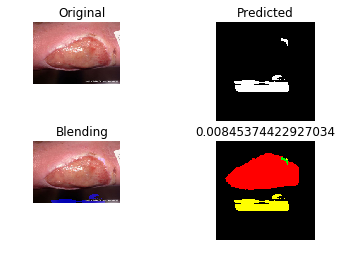

PREDICT... p2_54_s8_to_iPad
../testing_data/features/original_augment/p2_54_s8_to_iPad.txt
 , IoU = 0.0014903129657228018
Saving... ../training_data/model/original_augment/results/model23.05/reports/p2_54_s8_to_iPad_report.png


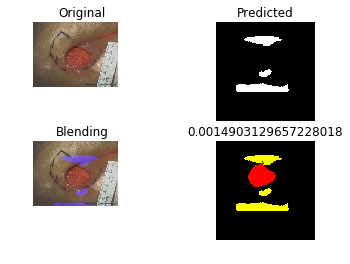

PREDICT... b_20
../testing_data/features/original_augment/b_20.txt
 , IoU = 0.2749616816290782
Saving... ../training_data/model/original_augment/results/model23.05/reports/b_20_report.png


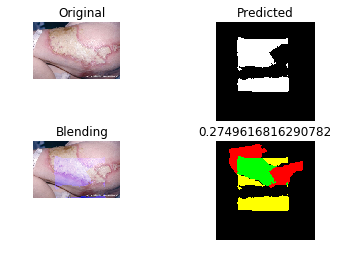

PREDICT... p1_81_motoC_to_S8
../testing_data/features/original_augment/p1_81_motoC_to_S8.txt
 , IoU = 0.15340941675746975
Saving... ../training_data/model/original_augment/results/model23.05/reports/p1_81_motoC_to_S8_report.png


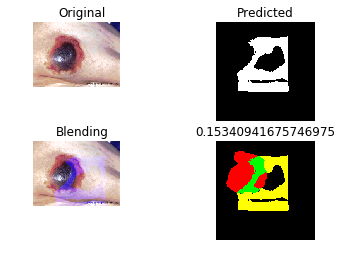

PREDICT... v1_32
../testing_data/features/original_augment/v1_32.txt
 , IoU = 0.011698488025604237
Saving... ../training_data/model/original_augment/results/model23.05/reports/v1_32_report.png


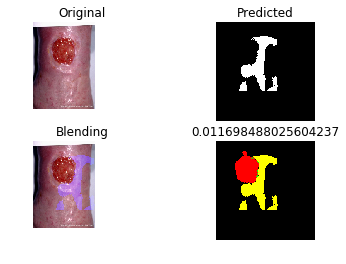

PREDICT... v1_32_motoC_to_S8
../testing_data/features/original_augment/v1_32_motoC_to_S8.txt
 , IoU = 0.049421049226987514
Saving... ../training_data/model/original_augment/results/model23.05/reports/v1_32_motoC_to_S8_report.png


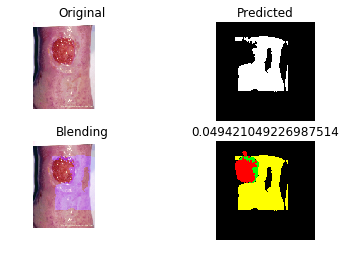

PREDICT... m_25_motoC_to_S8
../testing_data/features/original_augment/m_25_motoC_to_S8.txt
 , IoU = 0.09652142072500916
Saving... ../training_data/model/original_augment/results/model23.05/reports/m_25_motoC_to_S8_report.png


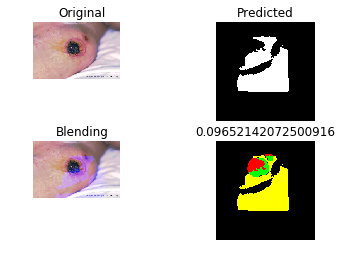

PREDICT... b_12_motoC_to_S8
../testing_data/features/original_augment/b_12_motoC_to_S8.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model23.05/reports/b_12_motoC_to_S8_report.png


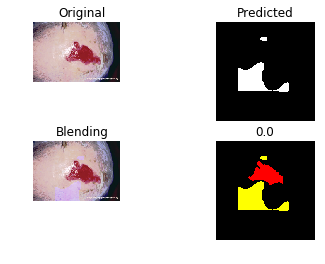

PREDICT... p2_57_s8_to_iPad
../testing_data/features/original_augment/p2_57_s8_to_iPad.txt
 , IoU = 0.017931158767345468
Saving... ../training_data/model/original_augment/results/model23.05/reports/p2_57_s8_to_iPad_report.png


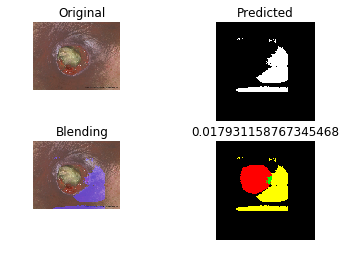

PREDICT... m_25
../testing_data/features/original_augment/m_25.txt
 , IoU = 0.05851655402515185
Saving... ../training_data/model/original_augment/results/model23.05/reports/m_25_report.png


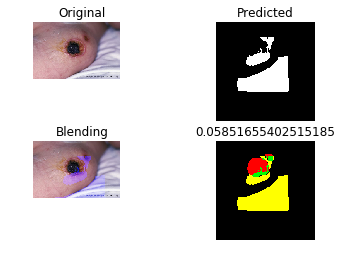

PREDICT... a_04_s8_to_iPad
../testing_data/features/original_augment/a_04_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model23.05/reports/a_04_s8_to_iPad_report.png


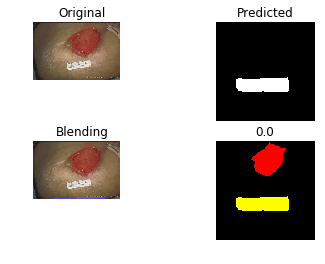

PREDICT... p1_81
../testing_data/features/original_augment/p1_81.txt
 , IoU = 0.0971023427866831
Saving... ../training_data/model/original_augment/results/model23.05/reports/p1_81_report.png


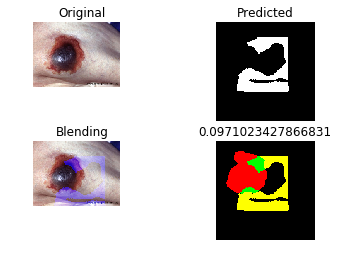

PREDICT... a_05_motoC_to_S8
../testing_data/features/original_augment/a_05_motoC_to_S8.txt
 , IoU = 0.006762513312034079
Saving... ../training_data/model/original_augment/results/model23.05/reports/a_05_motoC_to_S8_report.png


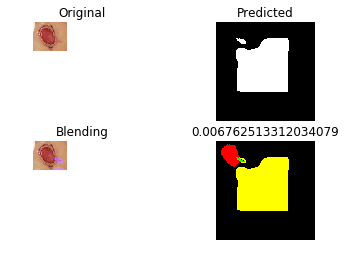

PREDICT... b_11_s8_to_iPad
../testing_data/features/original_augment/b_11_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model23.05/reports/b_11_s8_to_iPad_report.png


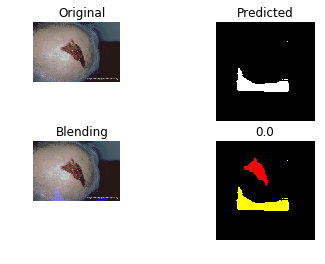

PREDICT... v1_84_s8_to_iPad
../testing_data/features/original_augment/v1_84_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model23.05/reports/v1_84_s8_to_iPad_report.png


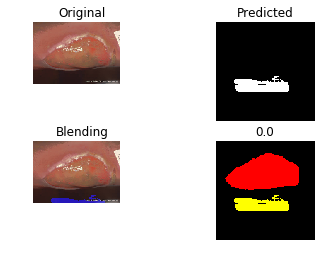

PREDICT... v1_70_motoC_to_S8
../testing_data/features/original_augment/v1_70_motoC_to_S8.txt
 , IoU = 0.0023187821352958966
Saving... ../training_data/model/original_augment/results/model23.05/reports/v1_70_motoC_to_S8_report.png


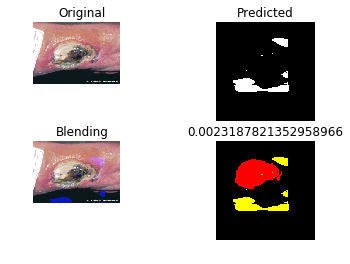

PREDICT... v1_32_s8_to_iPad
../testing_data/features/original_augment/v1_32_s8_to_iPad.txt
 , IoU = 0.013374805598755831
Saving... ../training_data/model/original_augment/results/model23.05/reports/v1_32_s8_to_iPad_report.png


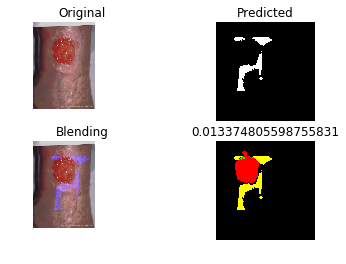

PREDICT... p1_72
../testing_data/features/original_augment/p1_72.txt
 , IoU = 0.07205914809092916
Saving... ../training_data/model/original_augment/results/model23.05/reports/p1_72_report.png


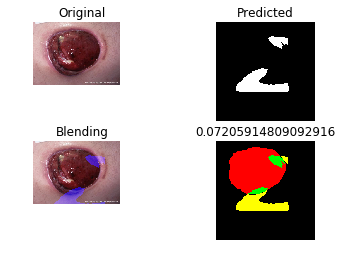

PREDICT... a_05_s8_to_iPad
../testing_data/features/original_augment/a_05_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model23.05/reports/a_05_s8_to_iPad_report.png


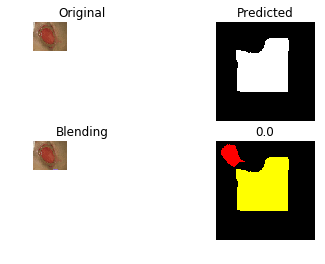

PREDICT... b_05_s8_to_iPad
../testing_data/features/original_augment/b_05_s8_to_iPad.txt
 , IoU = 0.056738981054284876
Saving... ../training_data/model/original_augment/results/model23.05/reports/b_05_s8_to_iPad_report.png


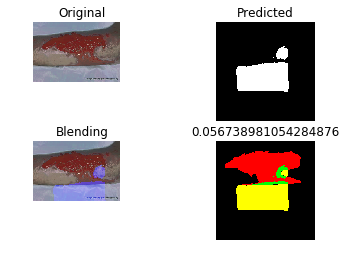

PREDICT... f_18
../testing_data/features/original_augment/f_18.txt
 , IoU = 0.025807172382973968
Saving... ../training_data/model/original_augment/results/model23.05/reports/f_18_report.png


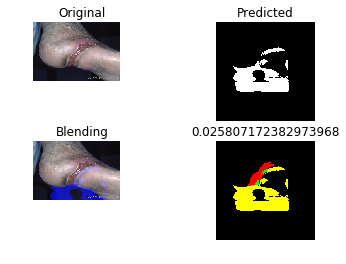

SEGMENTATION REPORT :: iou_avg 0.06729668153821015, iou_min 0.0
date: 2018-05-08 ,time: 14:59:12
	wound	not wound
    wound	75885	518951
not wound	438312	4275268
precision => 12.76
recall => 14.76
f-measure => 13.68
accuracy => 81.97
all sample => 5308416


In [31]:
#k-fold => 3
model_name = 'model23.05.model'
segmentation(root_path, model_name, color_dir_path, gray_dir_path)

Image Dir is ../testing_data/features/original_augment/
Model is ../training_data/model/original_augment/model29.58.model
START : date: 2018-05-08 ,time: 14:59:12
PREDICT... m_47_motoC_to_S8
../testing_data/features/original_augment/m_47_motoC_to_S8.txt
 , IoU = 0.0032761821557278584
Saving... ../training_data/model/original_augment/results/model29.58/reports/m_47_motoC_to_S8_report.png


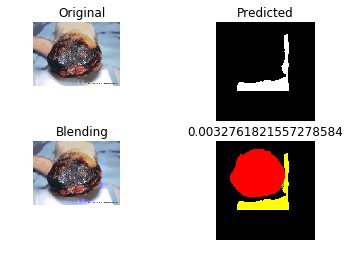

PREDICT... b_12
../testing_data/features/original_augment/b_12.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model29.58/reports/b_12_report.png


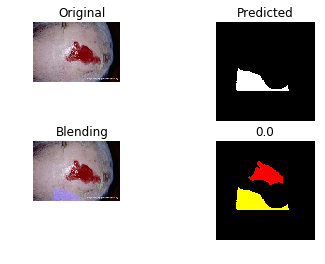

PREDICT... m_03_motoC_to_S8
../testing_data/features/original_augment/m_03_motoC_to_S8.txt
 , IoU = 0.10257266956231206
Saving... ../training_data/model/original_augment/results/model29.58/reports/m_03_motoC_to_S8_report.png


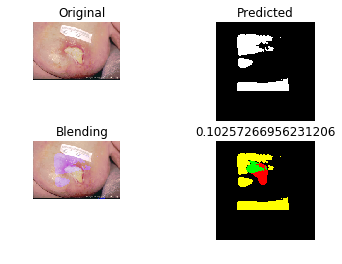

PREDICT... f_41_s8_to_iPad
../testing_data/features/original_augment/f_41_s8_to_iPad.txt
 , IoU = 0.003833375926399182
Saving... ../training_data/model/original_augment/results/model29.58/reports/f_41_s8_to_iPad_report.png


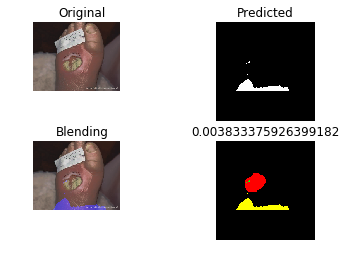

PREDICT... m_03
../testing_data/features/original_augment/m_03.txt
 , IoU = 0.04485351309307752
Saving... ../training_data/model/original_augment/results/model29.58/reports/m_03_report.png


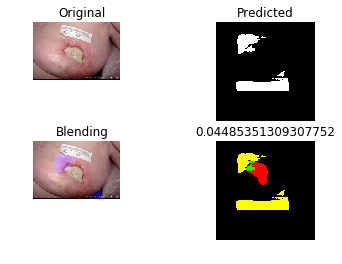

PREDICT... p1_67_s8_to_iPad
../testing_data/features/original_augment/p1_67_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model29.58/reports/p1_67_s8_to_iPad_report.png


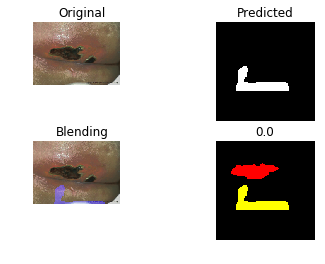

PREDICT... f_50
../testing_data/features/original_augment/f_50.txt
 , IoU = 0.05919661733615222
Saving... ../training_data/model/original_augment/results/model29.58/reports/f_50_report.png


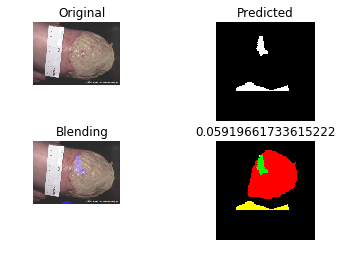

PREDICT... f_35
../testing_data/features/original_augment/f_35.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model29.58/reports/f_35_report.png


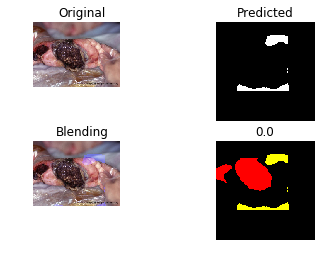

PREDICT... p2_57_motoC_to_S8
../testing_data/features/original_augment/p2_57_motoC_to_S8.txt
 , IoU = 0.053730163956015015
Saving... ../training_data/model/original_augment/results/model29.58/reports/p2_57_motoC_to_S8_report.png


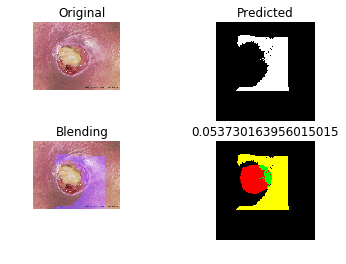

PREDICT... v2_07
../testing_data/features/original_augment/v2_07.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model29.58/reports/v2_07_report.png


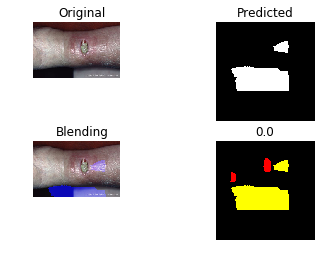

PREDICT... p2_54_motoC_to_S8
../testing_data/features/original_augment/p2_54_motoC_to_S8.txt
 , IoU = 0.014309882983222897
Saving... ../training_data/model/original_augment/results/model29.58/reports/p2_54_motoC_to_S8_report.png


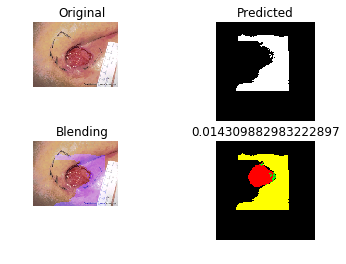

PREDICT... v1_76_motoC_to_S8
../testing_data/features/original_augment/v1_76_motoC_to_S8.txt
 , IoU = 0.17093887456393145
Saving... ../training_data/model/original_augment/results/model29.58/reports/v1_76_motoC_to_S8_report.png


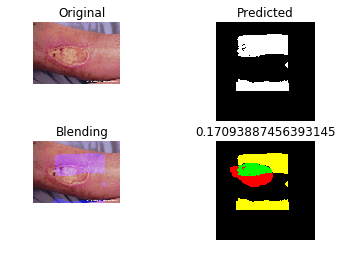

PREDICT... p2_54
../testing_data/features/original_augment/p2_54.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model29.58/reports/p2_54_report.png


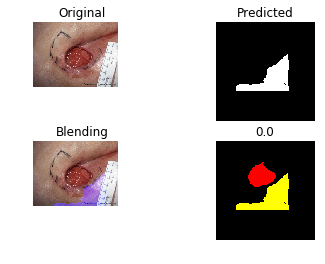

PREDICT... m_47
../testing_data/features/original_augment/m_47.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model29.58/reports/m_47_report.png


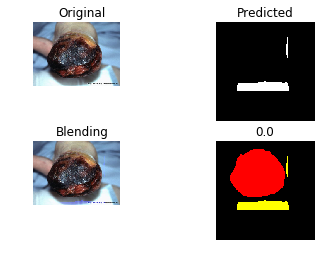

PREDICT... v2_07_motoC_to_S8
../testing_data/features/original_augment/v2_07_motoC_to_S8.txt
 , IoU = 0.03898472528307622
Saving... ../training_data/model/original_augment/results/model29.58/reports/v2_07_motoC_to_S8_report.png


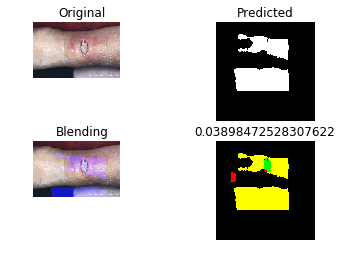

PREDICT... a_04
../testing_data/features/original_augment/a_04.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model29.58/reports/a_04_report.png


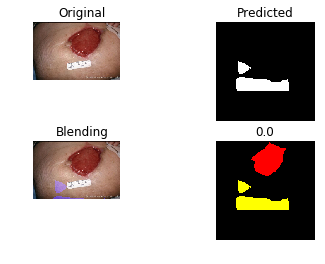

PREDICT... t_25_s8_to_iPad
../testing_data/features/original_augment/t_25_s8_to_iPad.txt
 , IoU = 0.07034012730662895
Saving... ../training_data/model/original_augment/results/model29.58/reports/t_25_s8_to_iPad_report.png


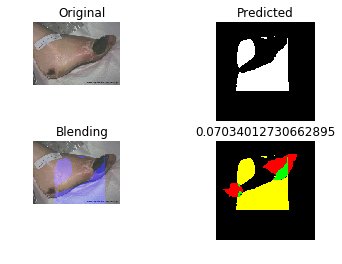

PREDICT... f_41
../testing_data/features/original_augment/f_41.txt
 , IoU = 0.0835509138381201
Saving... ../training_data/model/original_augment/results/model29.58/reports/f_41_report.png


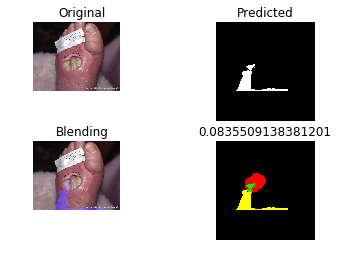

PREDICT... p2_57
../testing_data/features/original_augment/p2_57.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model29.58/reports/p2_57_report.png


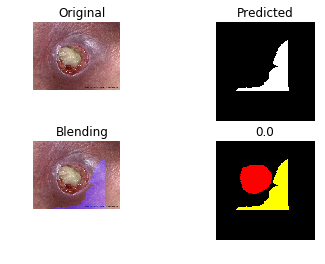

PREDICT... p1_82_s8_to_iPad
../testing_data/features/original_augment/p1_82_s8_to_iPad.txt
 , IoU = 0.09363946633571207
Saving... ../training_data/model/original_augment/results/model29.58/reports/p1_82_s8_to_iPad_report.png


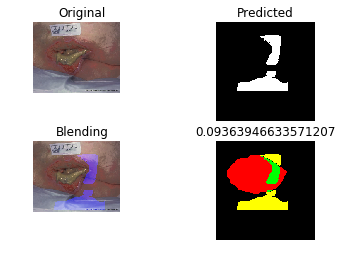

PREDICT... p1_72_motoC_to_S8
../testing_data/features/original_augment/p1_72_motoC_to_S8.txt
 , IoU = 0.059185859667916445
Saving... ../training_data/model/original_augment/results/model29.58/reports/p1_72_motoC_to_S8_report.png


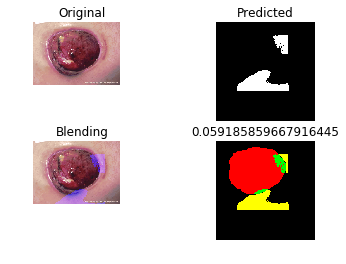

PREDICT... p1_82
../testing_data/features/original_augment/p1_82.txt
 , IoU = 0.030518011130817688
Saving... ../training_data/model/original_augment/results/model29.58/reports/p1_82_report.png


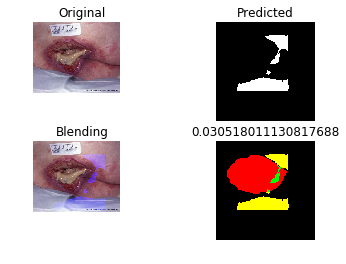

PREDICT... b_20_motoC_to_S8
../testing_data/features/original_augment/b_20_motoC_to_S8.txt
 , IoU = 0.3686398835819344
Saving... ../training_data/model/original_augment/results/model29.58/reports/b_20_motoC_to_S8_report.png


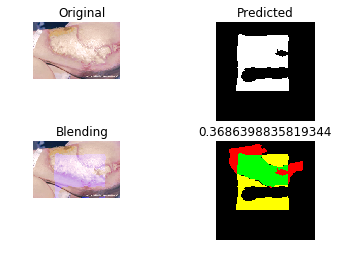

PREDICT... p1_73_s8_to_iPad
../testing_data/features/original_augment/p1_73_s8_to_iPad.txt
 , IoU = 0.024417978335029025
Saving... ../training_data/model/original_augment/results/model29.58/reports/p1_73_s8_to_iPad_report.png


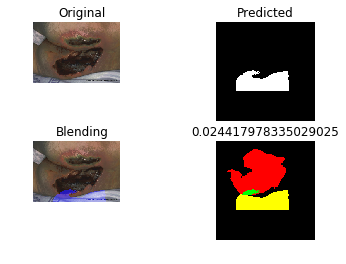

PREDICT... p1_72_s8_to_iPad
../testing_data/features/original_augment/p1_72_s8_to_iPad.txt
 , IoU = 0.051025403905782515
Saving... ../training_data/model/original_augment/results/model29.58/reports/p1_72_s8_to_iPad_report.png


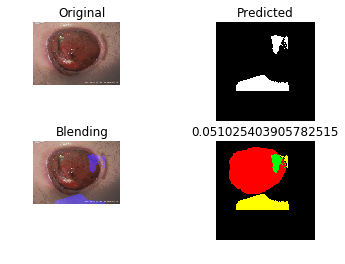

PREDICT... v1_70
../testing_data/features/original_augment/v1_70.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model29.58/reports/v1_70_report.png


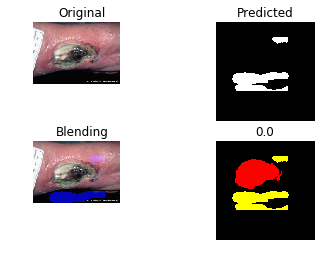

PREDICT... v1_76_s8_to_iPad
../testing_data/features/original_augment/v1_76_s8_to_iPad.txt
 , IoU = 0.17626891257360067
Saving... ../training_data/model/original_augment/results/model29.58/reports/v1_76_s8_to_iPad_report.png


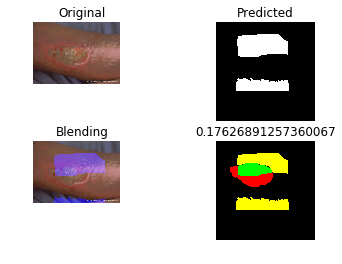

PREDICT... a_05
../testing_data/features/original_augment/a_05.txt
 , IoU = 0.005332834354680264
Saving... ../training_data/model/original_augment/results/model29.58/reports/a_05_report.png


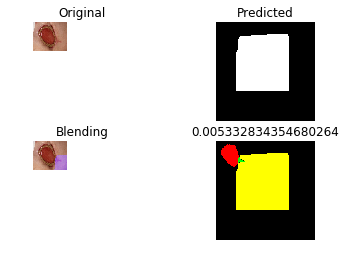

PREDICT... m_43_s8_to_iPad
../testing_data/features/original_augment/m_43_s8_to_iPad.txt
 , IoU = 0.05901716435457324
Saving... ../training_data/model/original_augment/results/model29.58/reports/m_43_s8_to_iPad_report.png


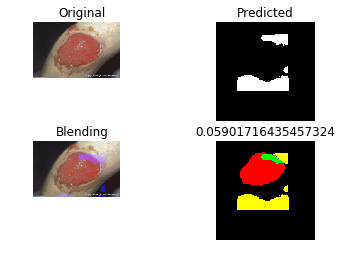

PREDICT... v1_76
../testing_data/features/original_augment/v1_76.txt
 , IoU = 0.13910086890819795
Saving... ../training_data/model/original_augment/results/model29.58/reports/v1_76_report.png


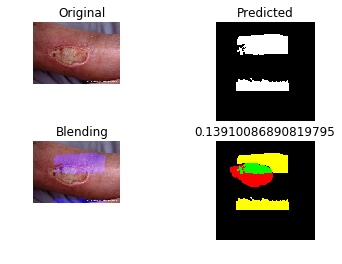

PREDICT... p1_82_motoC_to_S8
../testing_data/features/original_augment/p1_82_motoC_to_S8.txt
 , IoU = 0.157218608210791
Saving... ../training_data/model/original_augment/results/model29.58/reports/p1_82_motoC_to_S8_report.png


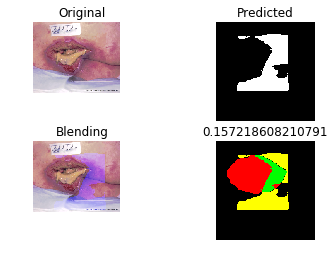

PREDICT... m_47_s8_to_iPad
../testing_data/features/original_augment/m_47_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model29.58/reports/m_47_s8_to_iPad_report.png


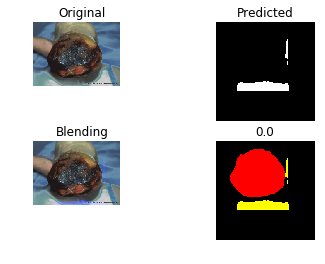

PREDICT... m_25_s8_to_iPad
../testing_data/features/original_augment/m_25_s8_to_iPad.txt
 , IoU = 0.02648542600896861
Saving... ../training_data/model/original_augment/results/model29.58/reports/m_25_s8_to_iPad_report.png


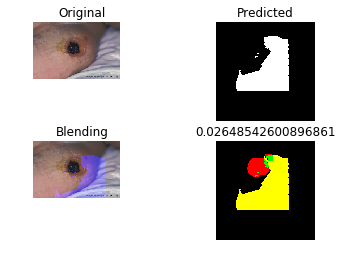

PREDICT... t_25
../testing_data/features/original_augment/t_25.txt
 , IoU = 0.08165693885646286
Saving... ../training_data/model/original_augment/results/model29.58/reports/t_25_report.png


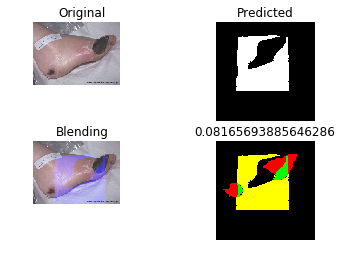

PREDICT... f_50_motoC_to_S8
../testing_data/features/original_augment/f_50_motoC_to_S8.txt
 , IoU = 0.13218142548596112
Saving... ../training_data/model/original_augment/results/model29.58/reports/f_50_motoC_to_S8_report.png


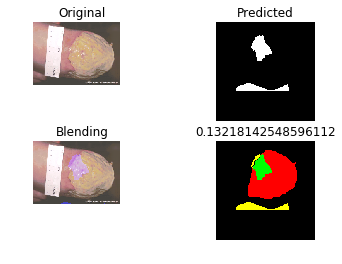

PREDICT... b_11
../testing_data/features/original_augment/b_11.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model29.58/reports/b_11_report.png


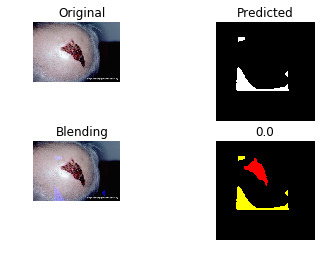

PREDICT... p1_67
../testing_data/features/original_augment/p1_67.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model29.58/reports/p1_67_report.png


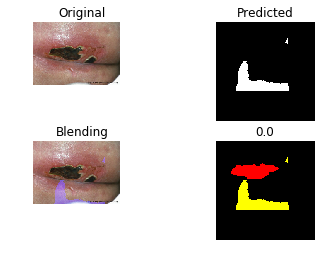

PREDICT... f_18_motoC_to_S8
../testing_data/features/original_augment/f_18_motoC_to_S8.txt
 , IoU = 0.000143000143000143
Saving... ../training_data/model/original_augment/results/model29.58/reports/f_18_motoC_to_S8_report.png


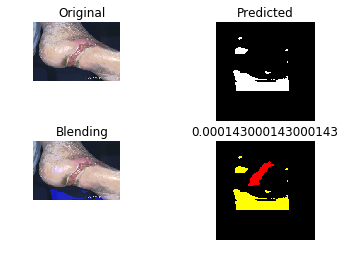

PREDICT... f_41_motoC_to_S8
../testing_data/features/original_augment/f_41_motoC_to_S8.txt
 , IoU = 0.1672546171404856
Saving... ../training_data/model/original_augment/results/model29.58/reports/f_41_motoC_to_S8_report.png


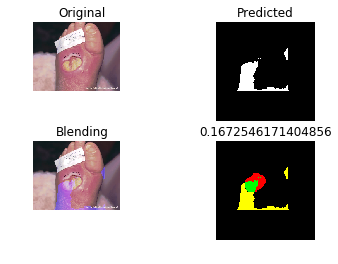

PREDICT... f_50_s8_to_iPad
../testing_data/features/original_augment/f_50_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model29.58/reports/f_50_s8_to_iPad_report.png


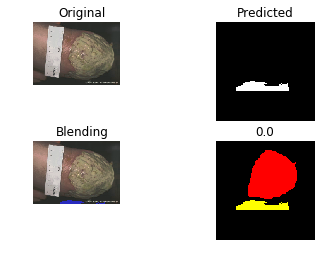

PREDICT... p1_73_motoC_to_S8
../testing_data/features/original_augment/p1_73_motoC_to_S8.txt
 , IoU = 0.0044915558749550845
Saving... ../training_data/model/original_augment/results/model29.58/reports/p1_73_motoC_to_S8_report.png


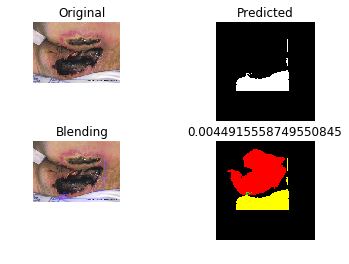

PREDICT... b_20_s8_to_iPad
../testing_data/features/original_augment/b_20_s8_to_iPad.txt
 , IoU = 0.22995428878730842
Saving... ../training_data/model/original_augment/results/model29.58/reports/b_20_s8_to_iPad_report.png


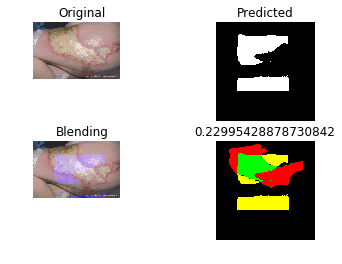

PREDICT... b_05
../testing_data/features/original_augment/b_05.txt
 , IoU = 0.007905735434815448
Saving... ../training_data/model/original_augment/results/model29.58/reports/b_05_report.png


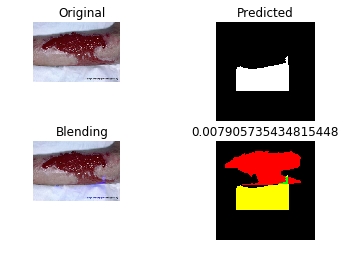

PREDICT... m_03_s8_to_iPad
../testing_data/features/original_augment/m_03_s8_to_iPad.txt
 , IoU = 0.00012884937508053087
Saving... ../training_data/model/original_augment/results/model29.58/reports/m_03_s8_to_iPad_report.png


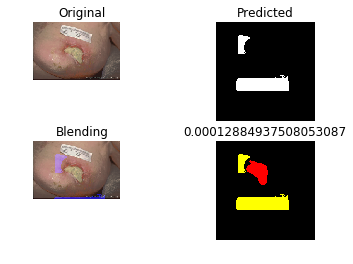

PREDICT... v1_84_motoC_to_S8
../testing_data/features/original_augment/v1_84_motoC_to_S8.txt
 , IoU = 0.007418563141454708
Saving... ../training_data/model/original_augment/results/model29.58/reports/v1_84_motoC_to_S8_report.png


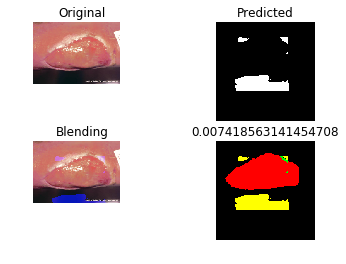

PREDICT... m_43
../testing_data/features/original_augment/m_43.txt
 , IoU = 0.03751984624383722
Saving... ../training_data/model/original_augment/results/model29.58/reports/m_43_report.png


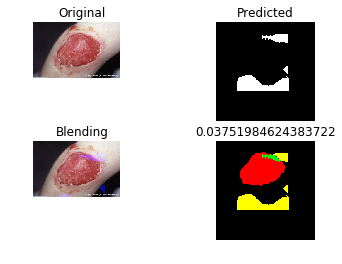

PREDICT... p1_81_s8_to_iPad
../testing_data/features/original_augment/p1_81_s8_to_iPad.txt
 , IoU = 0.12000669493416648
Saving... ../training_data/model/original_augment/results/model29.58/reports/p1_81_s8_to_iPad_report.png


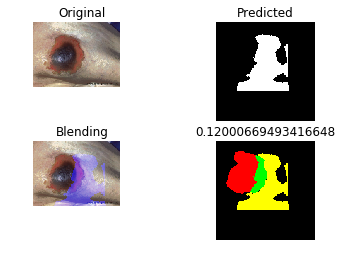

PREDICT... p1_67_motoC_to_S8
../testing_data/features/original_augment/p1_67_motoC_to_S8.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model29.58/reports/p1_67_motoC_to_S8_report.png


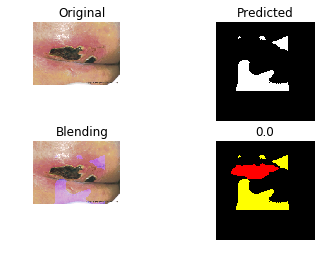

PREDICT... b_05_motoC_to_S8
../testing_data/features/original_augment/b_05_motoC_to_S8.txt
 , IoU = 0.02905881186154914
Saving... ../training_data/model/original_augment/results/model29.58/reports/b_05_motoC_to_S8_report.png


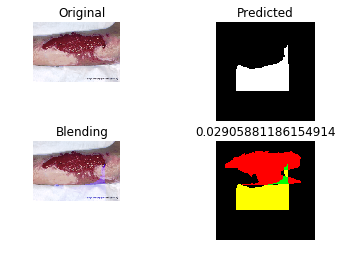

PREDICT... m_43_motoC_to_S8
../testing_data/features/original_augment/m_43_motoC_to_S8.txt
 , IoU = 0.06984653670676068
Saving... ../training_data/model/original_augment/results/model29.58/reports/m_43_motoC_to_S8_report.png


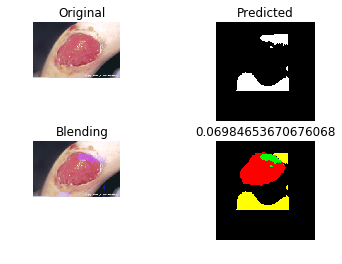

PREDICT... f_35_s8_to_iPad
../testing_data/features/original_augment/f_35_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model29.58/reports/f_35_s8_to_iPad_report.png


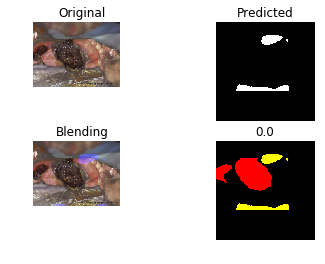

PREDICT... f_35_motoC_to_S8
../testing_data/features/original_augment/f_35_motoC_to_S8.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model29.58/reports/f_35_motoC_to_S8_report.png


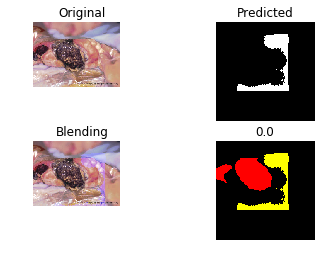

PREDICT... v1_70_s8_to_iPad
../testing_data/features/original_augment/v1_70_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model29.58/reports/v1_70_s8_to_iPad_report.png


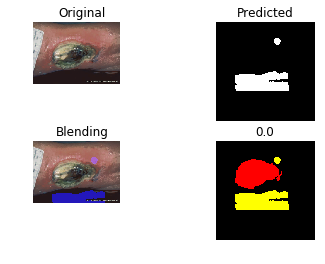

PREDICT... f_18_s8_to_iPad
../testing_data/features/original_augment/f_18_s8_to_iPad.txt
 , IoU = 0.0010864316755190729
Saving... ../training_data/model/original_augment/results/model29.58/reports/f_18_s8_to_iPad_report.png


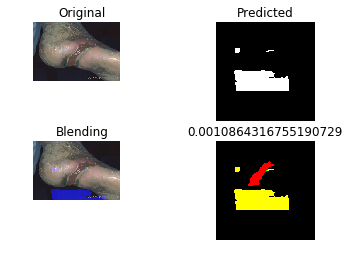

PREDICT... b_11_motoC_to_S8
../testing_data/features/original_augment/b_11_motoC_to_S8.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model29.58/reports/b_11_motoC_to_S8_report.png


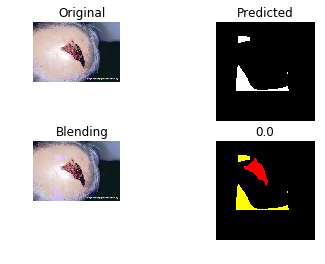

PREDICT... b_12_s8_to_iPad
../testing_data/features/original_augment/b_12_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model29.58/reports/b_12_s8_to_iPad_report.png


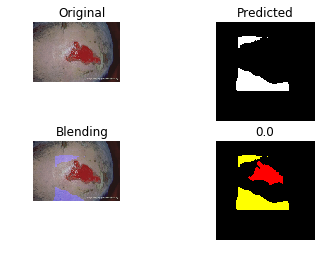

PREDICT... t_25_motoC_to_S8
../testing_data/features/original_augment/t_25_motoC_to_S8.txt
 , IoU = 0.08286662518149761
Saving... ../training_data/model/original_augment/results/model29.58/reports/t_25_motoC_to_S8_report.png


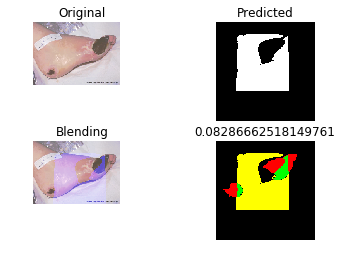

PREDICT... v2_07_s8_to_iPad
../testing_data/features/original_augment/v2_07_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model29.58/reports/v2_07_s8_to_iPad_report.png


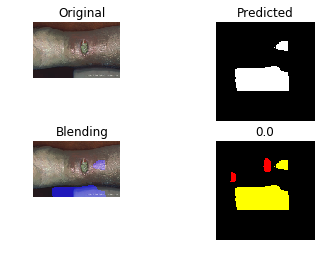

PREDICT... a_04_motoC_to_S8
../testing_data/features/original_augment/a_04_motoC_to_S8.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model29.58/reports/a_04_motoC_to_S8_report.png


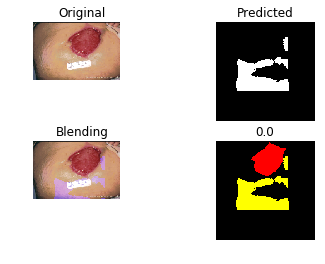

PREDICT... p1_73
../testing_data/features/original_augment/p1_73.txt
 , IoU = 0.008453810340602793
Saving... ../training_data/model/original_augment/results/model29.58/reports/p1_73_report.png


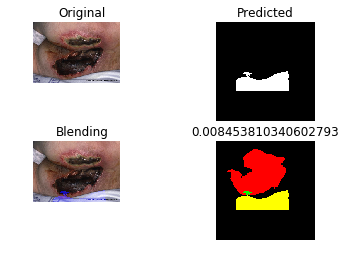

PREDICT... v1_84
../testing_data/features/original_augment/v1_84.txt
 , IoU = 0.029405769034756904
Saving... ../training_data/model/original_augment/results/model29.58/reports/v1_84_report.png


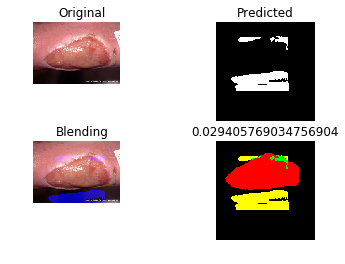

PREDICT... p2_54_s8_to_iPad
../testing_data/features/original_augment/p2_54_s8_to_iPad.txt
 , IoU = 0.01578255151249452
Saving... ../training_data/model/original_augment/results/model29.58/reports/p2_54_s8_to_iPad_report.png


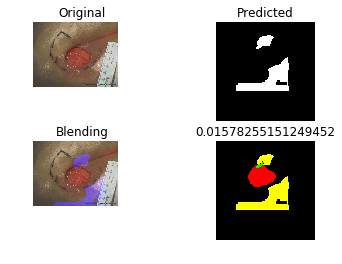

PREDICT... b_20
../testing_data/features/original_augment/b_20.txt
 , IoU = 0.29278835631429195
Saving... ../training_data/model/original_augment/results/model29.58/reports/b_20_report.png


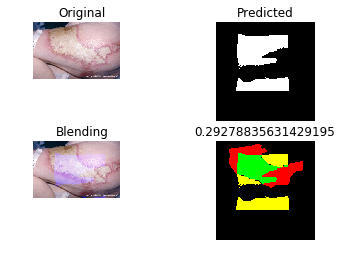

PREDICT... p1_81_motoC_to_S8
../testing_data/features/original_augment/p1_81_motoC_to_S8.txt
 , IoU = 0.10883895491507482
Saving... ../training_data/model/original_augment/results/model29.58/reports/p1_81_motoC_to_S8_report.png


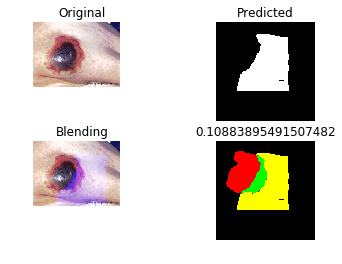

PREDICT... v1_32
../testing_data/features/original_augment/v1_32.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model29.58/reports/v1_32_report.png


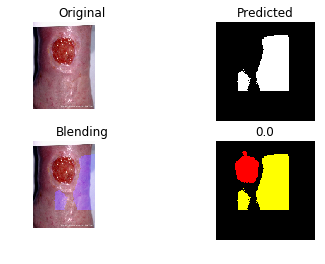

PREDICT... v1_32_motoC_to_S8
../testing_data/features/original_augment/v1_32_motoC_to_S8.txt
 , IoU = 0.008417871789337363
Saving... ../training_data/model/original_augment/results/model29.58/reports/v1_32_motoC_to_S8_report.png


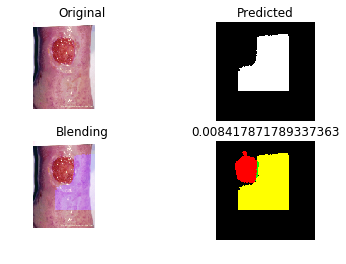

PREDICT... m_25_motoC_to_S8
../testing_data/features/original_augment/m_25_motoC_to_S8.txt
 , IoU = 0.06699405844549533
Saving... ../training_data/model/original_augment/results/model29.58/reports/m_25_motoC_to_S8_report.png


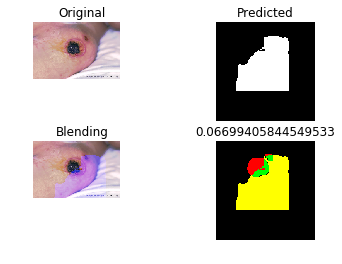

PREDICT... b_12_motoC_to_S8
../testing_data/features/original_augment/b_12_motoC_to_S8.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model29.58/reports/b_12_motoC_to_S8_report.png


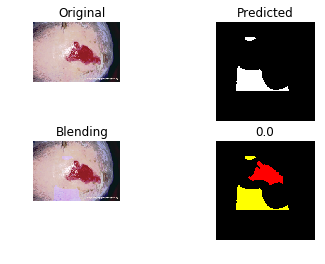

PREDICT... p2_57_s8_to_iPad
../testing_data/features/original_augment/p2_57_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model29.58/reports/p2_57_s8_to_iPad_report.png


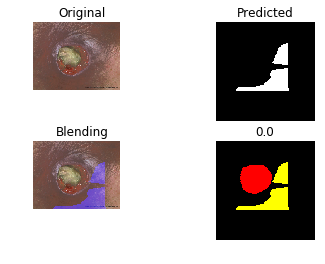

PREDICT... m_25
../testing_data/features/original_augment/m_25.txt
 , IoU = 0.012914166449256458
Saving... ../training_data/model/original_augment/results/model29.58/reports/m_25_report.png


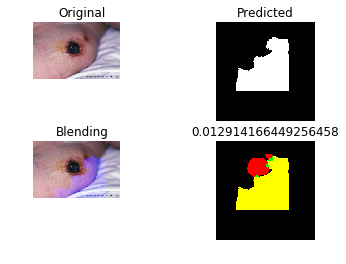

PREDICT... a_04_s8_to_iPad
../testing_data/features/original_augment/a_04_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model29.58/reports/a_04_s8_to_iPad_report.png


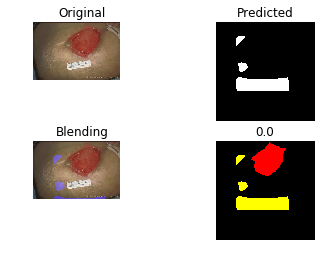

PREDICT... p1_81
../testing_data/features/original_augment/p1_81.txt
 , IoU = 0.04536380876334964
Saving... ../training_data/model/original_augment/results/model29.58/reports/p1_81_report.png


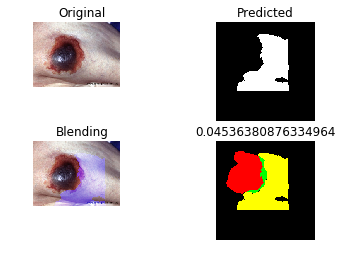

PREDICT... a_05_motoC_to_S8
../testing_data/features/original_augment/a_05_motoC_to_S8.txt
 , IoU = 0.006018194541637508
Saving... ../training_data/model/original_augment/results/model29.58/reports/a_05_motoC_to_S8_report.png


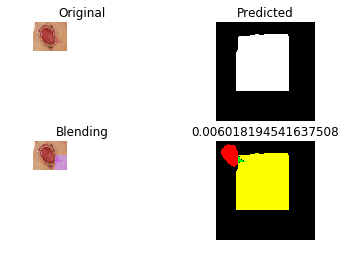

PREDICT... b_11_s8_to_iPad
../testing_data/features/original_augment/b_11_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model29.58/reports/b_11_s8_to_iPad_report.png


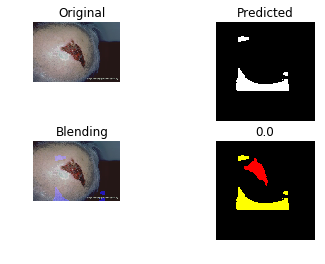

PREDICT... v1_84_s8_to_iPad
../testing_data/features/original_augment/v1_84_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model29.58/reports/v1_84_s8_to_iPad_report.png


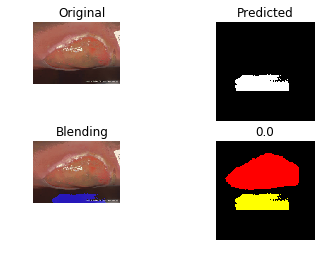

PREDICT... v1_70_motoC_to_S8
../testing_data/features/original_augment/v1_70_motoC_to_S8.txt
 , IoU = 9.125752874612155e-05
Saving... ../training_data/model/original_augment/results/model29.58/reports/v1_70_motoC_to_S8_report.png


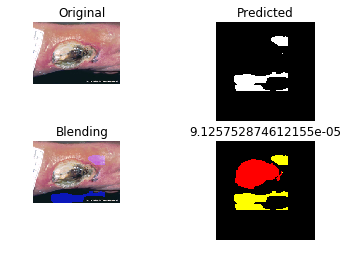

PREDICT... v1_32_s8_to_iPad
../testing_data/features/original_augment/v1_32_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model29.58/reports/v1_32_s8_to_iPad_report.png


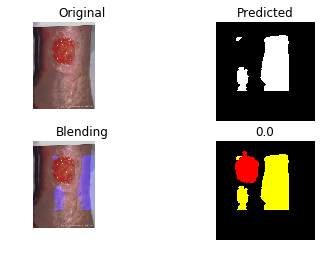

PREDICT... p1_72
../testing_data/features/original_augment/p1_72.txt
 , IoU = 0.019817655729650052
Saving... ../training_data/model/original_augment/results/model29.58/reports/p1_72_report.png


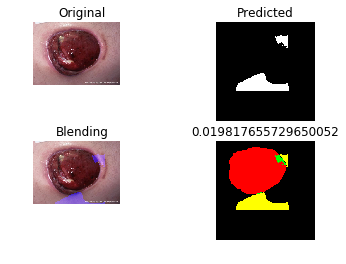

PREDICT... a_05_s8_to_iPad
../testing_data/features/original_augment/a_05_s8_to_iPad.txt
 , IoU = 0.004109200831286605
Saving... ../training_data/model/original_augment/results/model29.58/reports/a_05_s8_to_iPad_report.png


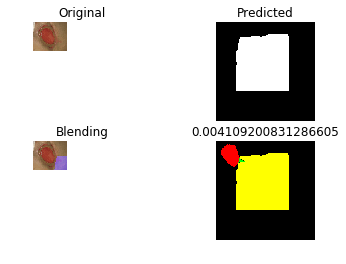

PREDICT... b_05_s8_to_iPad
../testing_data/features/original_augment/b_05_s8_to_iPad.txt
 , IoU = 0.007550588945937783
Saving... ../training_data/model/original_augment/results/model29.58/reports/b_05_s8_to_iPad_report.png


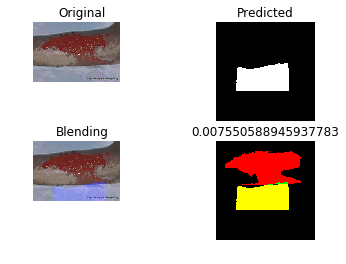

PREDICT... f_18
../testing_data/features/original_augment/f_18.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model29.58/reports/f_18_report.png


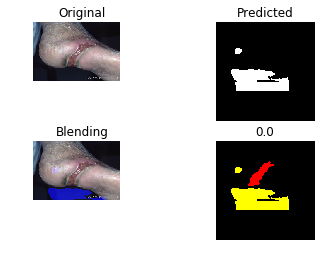

SEGMENTATION REPORT :: iou_avg 0.04240127937478321, iou_min 0.0
date: 2018-05-08 ,time: 15:00:49
	wound	not wound
    wound	53164	576530
not wound	461033	4217689
precision => 8.44
recall => 10.34
f-measure => 9.30
accuracy => 80.45
all sample => 5308416


In [32]:
#k-fold => 4
model_name = 'model29.58.model'
segmentation(root_path, model_name, color_dir_path, gray_dir_path)

Image Dir is ../testing_data/features/original_augment/
Model is ../training_data/model/original_augment/model33.34.model
START : date: 2018-05-08 ,time: 15:00:49
PREDICT... m_47_motoC_to_S8
../testing_data/features/original_augment/m_47_motoC_to_S8.txt
 , IoU = 0.03167489942455569
Saving... ../training_data/model/original_augment/results/model33.34/reports/m_47_motoC_to_S8_report.png


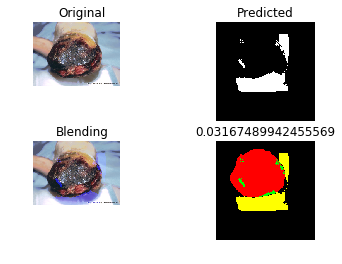

PREDICT... b_12
../testing_data/features/original_augment/b_12.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model33.34/reports/b_12_report.png


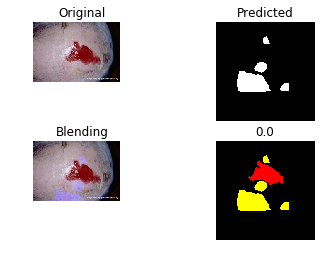

PREDICT... m_03_motoC_to_S8
../testing_data/features/original_augment/m_03_motoC_to_S8.txt
 , IoU = 0.1436682725395733
Saving... ../training_data/model/original_augment/results/model33.34/reports/m_03_motoC_to_S8_report.png


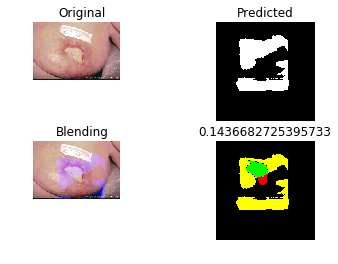

PREDICT... f_41_s8_to_iPad
../testing_data/features/original_augment/f_41_s8_to_iPad.txt
 , IoU = 0.1583308073153481
Saving... ../training_data/model/original_augment/results/model33.34/reports/f_41_s8_to_iPad_report.png


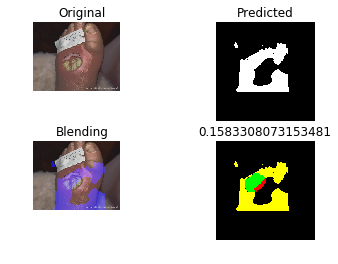

PREDICT... m_03
../testing_data/features/original_augment/m_03.txt
 , IoU = 0.1467341306347746
Saving... ../training_data/model/original_augment/results/model33.34/reports/m_03_report.png


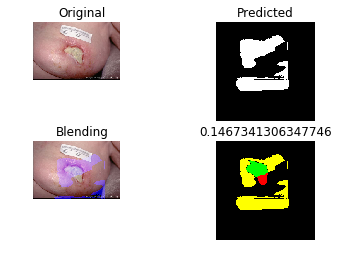

PREDICT... p1_67_s8_to_iPad
../testing_data/features/original_augment/p1_67_s8_to_iPad.txt
 , IoU = 0.01320493178667834
Saving... ../training_data/model/original_augment/results/model33.34/reports/p1_67_s8_to_iPad_report.png


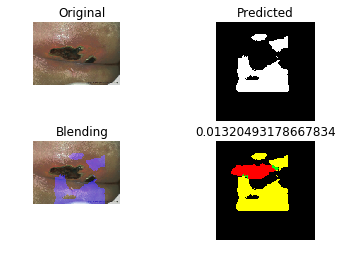

PREDICT... f_50
../testing_data/features/original_augment/f_50.txt
 , IoU = 0.22793770646531383
Saving... ../training_data/model/original_augment/results/model33.34/reports/f_50_report.png


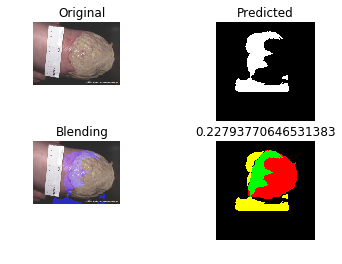

PREDICT... f_35
../testing_data/features/original_augment/f_35.txt
 , IoU = 0.008826548067054397
Saving... ../training_data/model/original_augment/results/model33.34/reports/f_35_report.png


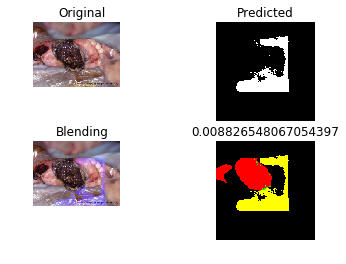

PREDICT... p2_57_motoC_to_S8
../testing_data/features/original_augment/p2_57_motoC_to_S8.txt
 , IoU = 0.22114470431640995
Saving... ../training_data/model/original_augment/results/model33.34/reports/p2_57_motoC_to_S8_report.png


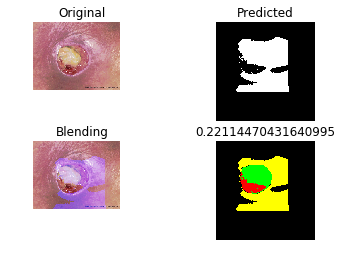

PREDICT... v2_07
../testing_data/features/original_augment/v2_07.txt
 , IoU = 0.02952984680401479
Saving... ../training_data/model/original_augment/results/model33.34/reports/v2_07_report.png


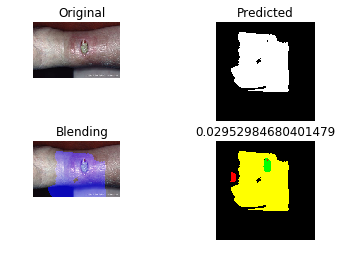

PREDICT... p2_54_motoC_to_S8
../testing_data/features/original_augment/p2_54_motoC_to_S8.txt
 , IoU = 0.0031743447826794724
Saving... ../training_data/model/original_augment/results/model33.34/reports/p2_54_motoC_to_S8_report.png


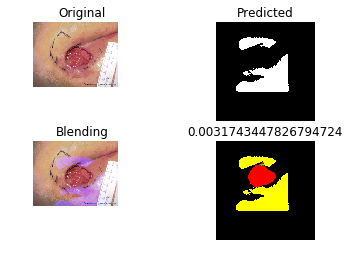

PREDICT... v1_76_motoC_to_S8
../testing_data/features/original_augment/v1_76_motoC_to_S8.txt
 , IoU = 0.17334172633566763
Saving... ../training_data/model/original_augment/results/model33.34/reports/v1_76_motoC_to_S8_report.png


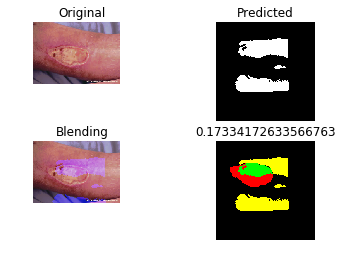

PREDICT... p2_54
../testing_data/features/original_augment/p2_54.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model33.34/reports/p2_54_report.png


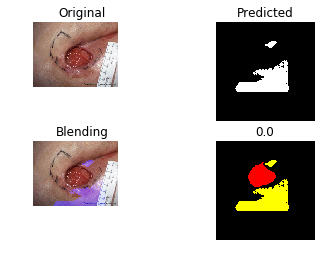

PREDICT... m_47
../testing_data/features/original_augment/m_47.txt
 , IoU = 0.00705895031792219
Saving... ../training_data/model/original_augment/results/model33.34/reports/m_47_report.png


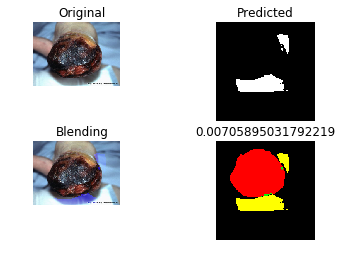

PREDICT... v2_07_motoC_to_S8
../testing_data/features/original_augment/v2_07_motoC_to_S8.txt
 , IoU = 0.02922972902688927
Saving... ../training_data/model/original_augment/results/model33.34/reports/v2_07_motoC_to_S8_report.png


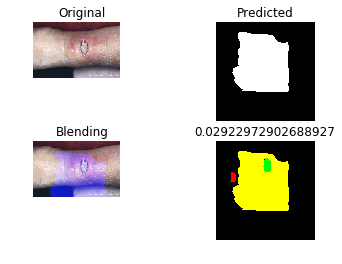

PREDICT... a_04
../testing_data/features/original_augment/a_04.txt
 , IoU = 0.002187545573866122
Saving... ../training_data/model/original_augment/results/model33.34/reports/a_04_report.png


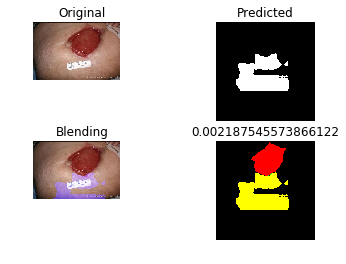

PREDICT... t_25_s8_to_iPad
../testing_data/features/original_augment/t_25_s8_to_iPad.txt
 , IoU = 0.11403783840284311
Saving... ../training_data/model/original_augment/results/model33.34/reports/t_25_s8_to_iPad_report.png


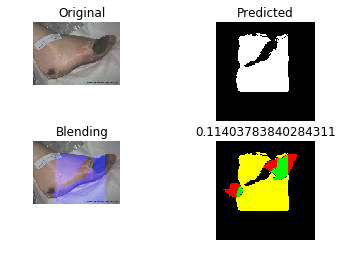

PREDICT... f_41
../testing_data/features/original_augment/f_41.txt
 , IoU = 0.19757146471034656
Saving... ../training_data/model/original_augment/results/model33.34/reports/f_41_report.png


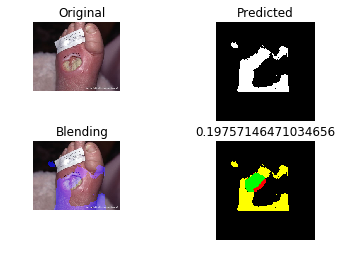

PREDICT... p2_57
../testing_data/features/original_augment/p2_57.txt
 , IoU = 0.16627543035993742
Saving... ../training_data/model/original_augment/results/model33.34/reports/p2_57_report.png


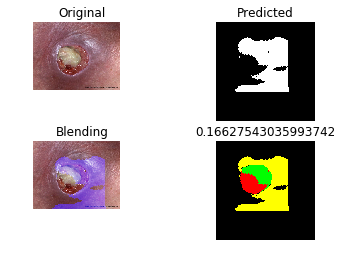

PREDICT... p1_82_s8_to_iPad
../testing_data/features/original_augment/p1_82_s8_to_iPad.txt
 , IoU = 0.39425383542538356
Saving... ../training_data/model/original_augment/results/model33.34/reports/p1_82_s8_to_iPad_report.png


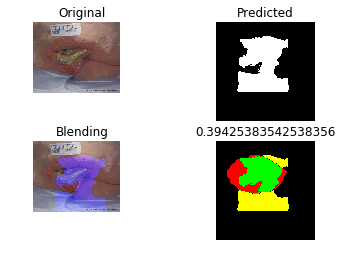

PREDICT... p1_72_motoC_to_S8
../testing_data/features/original_augment/p1_72_motoC_to_S8.txt
 , IoU = 0.056634819532908706
Saving... ../training_data/model/original_augment/results/model33.34/reports/p1_72_motoC_to_S8_report.png


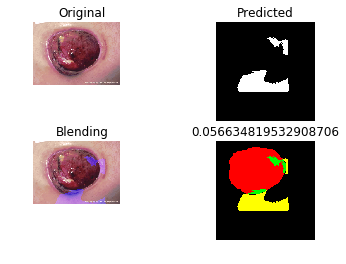

PREDICT... p1_82
../testing_data/features/original_augment/p1_82.txt
 , IoU = 0.22074802699302298
Saving... ../training_data/model/original_augment/results/model33.34/reports/p1_82_report.png


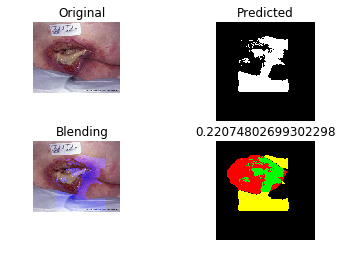

PREDICT... b_20_motoC_to_S8
../testing_data/features/original_augment/b_20_motoC_to_S8.txt
 , IoU = 0.30787719377805994
Saving... ../training_data/model/original_augment/results/model33.34/reports/b_20_motoC_to_S8_report.png


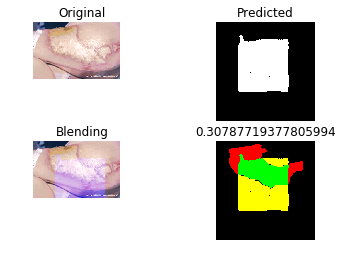

PREDICT... p1_73_s8_to_iPad
../testing_data/features/original_augment/p1_73_s8_to_iPad.txt
 , IoU = 0.14169930374238468
Saving... ../training_data/model/original_augment/results/model33.34/reports/p1_73_s8_to_iPad_report.png


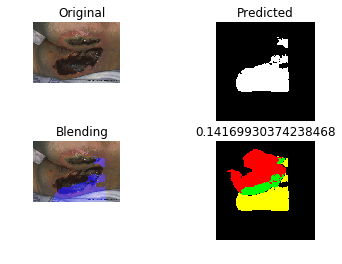

PREDICT... p1_72_s8_to_iPad
../testing_data/features/original_augment/p1_72_s8_to_iPad.txt
 , IoU = 0.07985024873070413
Saving... ../training_data/model/original_augment/results/model33.34/reports/p1_72_s8_to_iPad_report.png


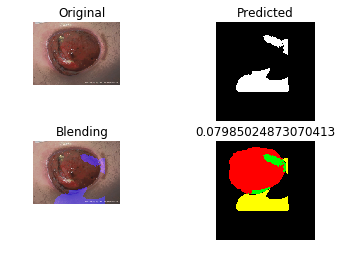

PREDICT... v1_70
../testing_data/features/original_augment/v1_70.txt
 , IoU = 0.13269028126773122
Saving... ../training_data/model/original_augment/results/model33.34/reports/v1_70_report.png


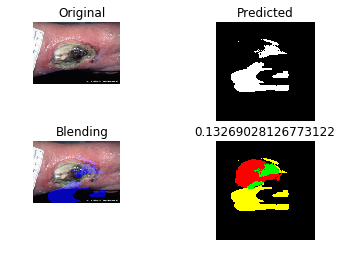

PREDICT... v1_76_s8_to_iPad
../testing_data/features/original_augment/v1_76_s8_to_iPad.txt
 , IoU = 0.1729607250755287
Saving... ../training_data/model/original_augment/results/model33.34/reports/v1_76_s8_to_iPad_report.png


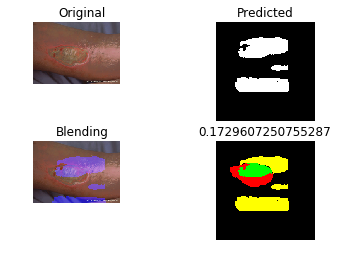

PREDICT... a_05
../testing_data/features/original_augment/a_05.txt
 , IoU = 0.0025164829634103376
Saving... ../training_data/model/original_augment/results/model33.34/reports/a_05_report.png


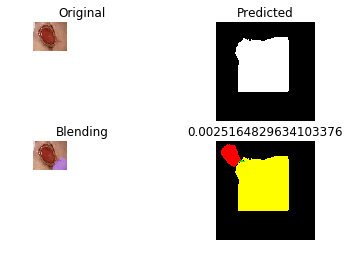

PREDICT... m_43_s8_to_iPad
../testing_data/features/original_augment/m_43_s8_to_iPad.txt
 , IoU = 0.03742963666934718
Saving... ../training_data/model/original_augment/results/model33.34/reports/m_43_s8_to_iPad_report.png


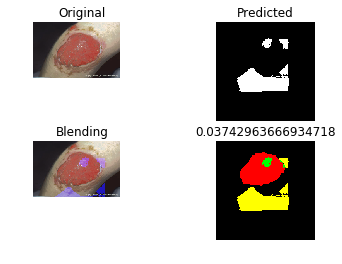

PREDICT... v1_76
../testing_data/features/original_augment/v1_76.txt
 , IoU = 0.1472779369627507
Saving... ../training_data/model/original_augment/results/model33.34/reports/v1_76_report.png


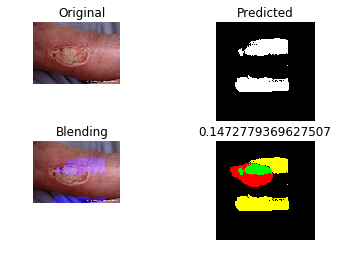

PREDICT... p1_82_motoC_to_S8
../testing_data/features/original_augment/p1_82_motoC_to_S8.txt
 , IoU = 0.4160714285714286
Saving... ../training_data/model/original_augment/results/model33.34/reports/p1_82_motoC_to_S8_report.png


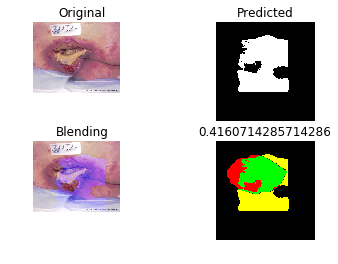

PREDICT... m_47_s8_to_iPad
../testing_data/features/original_augment/m_47_s8_to_iPad.txt
 , IoU = 0.0536565778246248
Saving... ../training_data/model/original_augment/results/model33.34/reports/m_47_s8_to_iPad_report.png


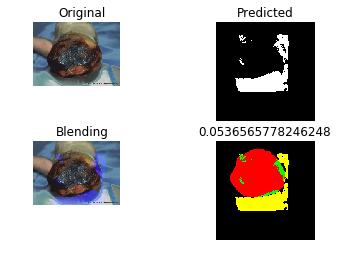

PREDICT... m_25_s8_to_iPad
../testing_data/features/original_augment/m_25_s8_to_iPad.txt
 , IoU = 0.10479836966590501
Saving... ../training_data/model/original_augment/results/model33.34/reports/m_25_s8_to_iPad_report.png


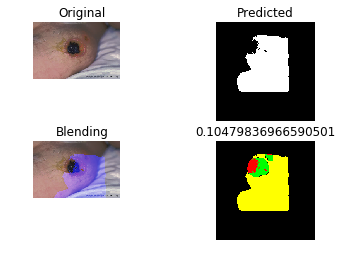

PREDICT... t_25
../testing_data/features/original_augment/t_25.txt
 , IoU = 0.11008746959267118
Saving... ../training_data/model/original_augment/results/model33.34/reports/t_25_report.png


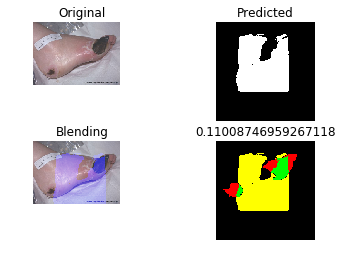

PREDICT... f_50_motoC_to_S8
../testing_data/features/original_augment/f_50_motoC_to_S8.txt
 , IoU = 0.31361934926576446
Saving... ../training_data/model/original_augment/results/model33.34/reports/f_50_motoC_to_S8_report.png


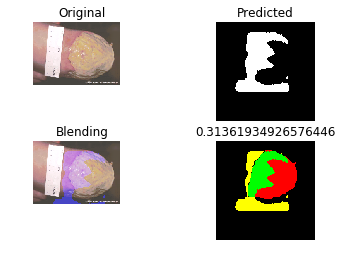

PREDICT... b_11
../testing_data/features/original_augment/b_11.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model33.34/reports/b_11_report.png


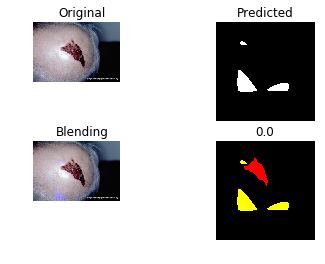

PREDICT... p1_67
../testing_data/features/original_augment/p1_67.txt
 , IoU = 0.0002567833604382436
Saving... ../training_data/model/original_augment/results/model33.34/reports/p1_67_report.png


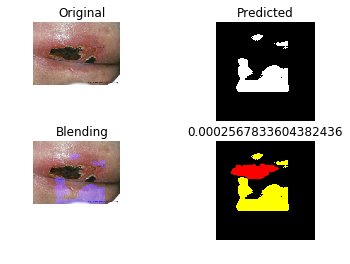

PREDICT... f_18_motoC_to_S8
../testing_data/features/original_augment/f_18_motoC_to_S8.txt
 , IoU = 0.08663033477245381
Saving... ../training_data/model/original_augment/results/model33.34/reports/f_18_motoC_to_S8_report.png


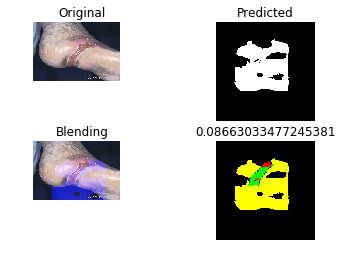

PREDICT... f_41_motoC_to_S8
../testing_data/features/original_augment/f_41_motoC_to_S8.txt
 , IoU = 0.1755172085041472
Saving... ../training_data/model/original_augment/results/model33.34/reports/f_41_motoC_to_S8_report.png


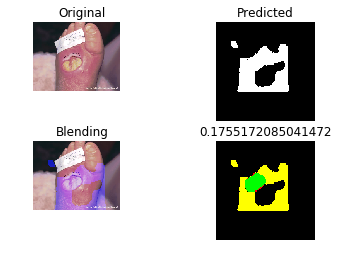

PREDICT... f_50_s8_to_iPad
../testing_data/features/original_augment/f_50_s8_to_iPad.txt
 , IoU = 0.23528397332720166
Saving... ../training_data/model/original_augment/results/model33.34/reports/f_50_s8_to_iPad_report.png


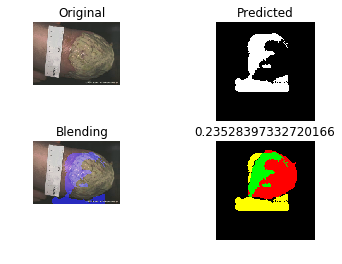

PREDICT... p1_73_motoC_to_S8
../testing_data/features/original_augment/p1_73_motoC_to_S8.txt
 , IoU = 0.13973943158704855
Saving... ../training_data/model/original_augment/results/model33.34/reports/p1_73_motoC_to_S8_report.png


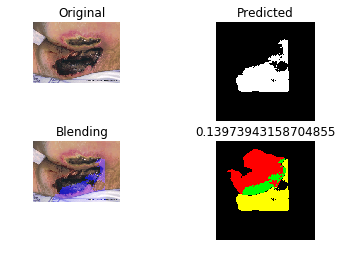

PREDICT... b_20_s8_to_iPad
../testing_data/features/original_augment/b_20_s8_to_iPad.txt
 , IoU = 0.3233327226090143
Saving... ../training_data/model/original_augment/results/model33.34/reports/b_20_s8_to_iPad_report.png


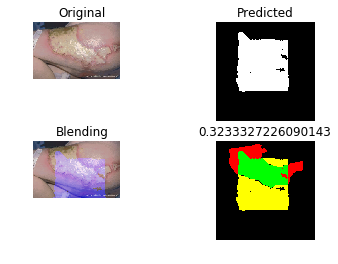

PREDICT... b_05
../testing_data/features/original_augment/b_05.txt
 , IoU = 0.11154319468373124
Saving... ../training_data/model/original_augment/results/model33.34/reports/b_05_report.png


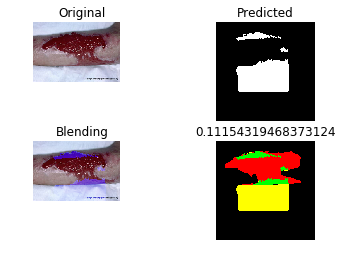

PREDICT... m_03_s8_to_iPad
../testing_data/features/original_augment/m_03_s8_to_iPad.txt
 , IoU = 0.12833244213581851
Saving... ../training_data/model/original_augment/results/model33.34/reports/m_03_s8_to_iPad_report.png


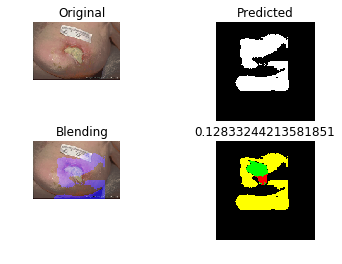

PREDICT... v1_84_motoC_to_S8
../testing_data/features/original_augment/v1_84_motoC_to_S8.txt
 , IoU = 0.06284180676524205
Saving... ../training_data/model/original_augment/results/model33.34/reports/v1_84_motoC_to_S8_report.png


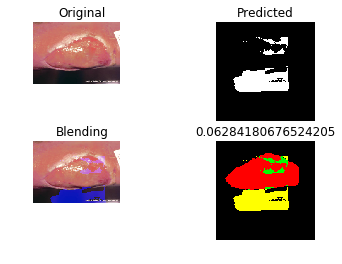

PREDICT... m_43
../testing_data/features/original_augment/m_43.txt
 , IoU = 0.02736668044646548
Saving... ../training_data/model/original_augment/results/model33.34/reports/m_43_report.png


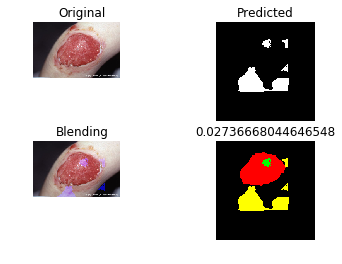

PREDICT... p1_81_s8_to_iPad
../testing_data/features/original_augment/p1_81_s8_to_iPad.txt
 , IoU = 0.18792350549616021
Saving... ../training_data/model/original_augment/results/model33.34/reports/p1_81_s8_to_iPad_report.png


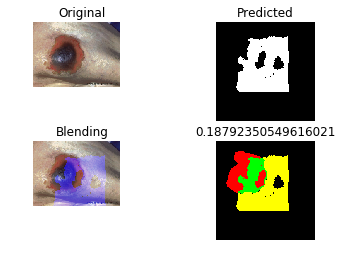

PREDICT... p1_67_motoC_to_S8
../testing_data/features/original_augment/p1_67_motoC_to_S8.txt
 , IoU = 0.008650125199180514
Saving... ../training_data/model/original_augment/results/model33.34/reports/p1_67_motoC_to_S8_report.png


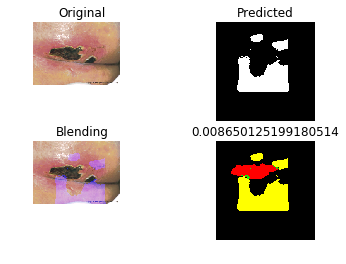

PREDICT... b_05_motoC_to_S8
../testing_data/features/original_augment/b_05_motoC_to_S8.txt
 , IoU = 0.09509716878760975
Saving... ../training_data/model/original_augment/results/model33.34/reports/b_05_motoC_to_S8_report.png


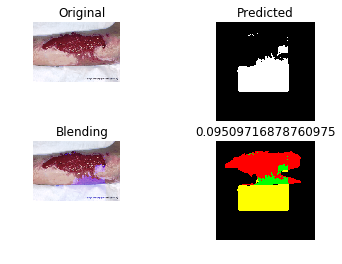

PREDICT... m_43_motoC_to_S8
../testing_data/features/original_augment/m_43_motoC_to_S8.txt
 , IoU = 0.07219338092147956
Saving... ../training_data/model/original_augment/results/model33.34/reports/m_43_motoC_to_S8_report.png


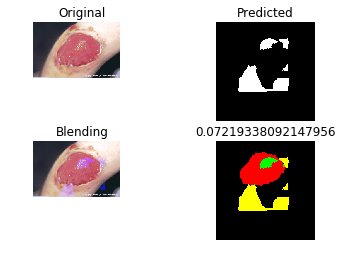

PREDICT... f_35_s8_to_iPad
../testing_data/features/original_augment/f_35_s8_to_iPad.txt
 , IoU = 0.05634078030352374
Saving... ../training_data/model/original_augment/results/model33.34/reports/f_35_s8_to_iPad_report.png


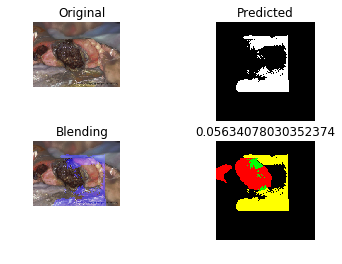

PREDICT... f_35_motoC_to_S8
../testing_data/features/original_augment/f_35_motoC_to_S8.txt
 , IoU = 0.10267135129106017
Saving... ../training_data/model/original_augment/results/model33.34/reports/f_35_motoC_to_S8_report.png


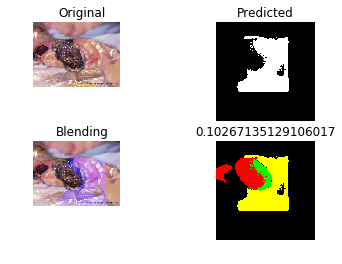

PREDICT... v1_70_s8_to_iPad
../testing_data/features/original_augment/v1_70_s8_to_iPad.txt
 , IoU = 0.18136874073027756
Saving... ../training_data/model/original_augment/results/model33.34/reports/v1_70_s8_to_iPad_report.png


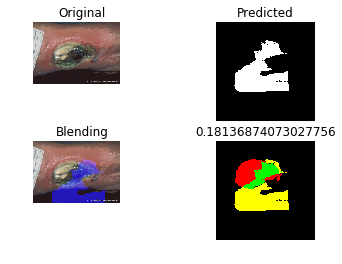

PREDICT... f_18_s8_to_iPad
../testing_data/features/original_augment/f_18_s8_to_iPad.txt
 , IoU = 0.08728448275862069
Saving... ../training_data/model/original_augment/results/model33.34/reports/f_18_s8_to_iPad_report.png


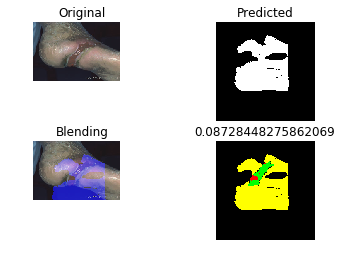

PREDICT... b_11_motoC_to_S8
../testing_data/features/original_augment/b_11_motoC_to_S8.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model33.34/reports/b_11_motoC_to_S8_report.png


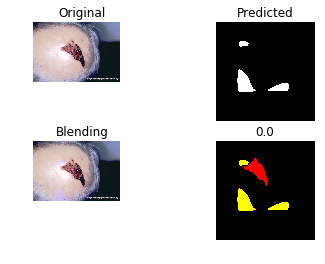

PREDICT... b_12_s8_to_iPad
../testing_data/features/original_augment/b_12_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model33.34/reports/b_12_s8_to_iPad_report.png


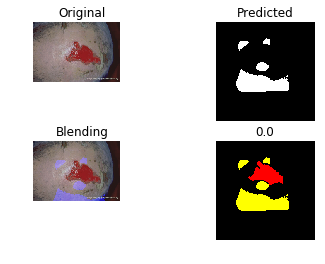

PREDICT... t_25_motoC_to_S8
../testing_data/features/original_augment/t_25_motoC_to_S8.txt
 , IoU = 0.11021789718637613
Saving... ../training_data/model/original_augment/results/model33.34/reports/t_25_motoC_to_S8_report.png


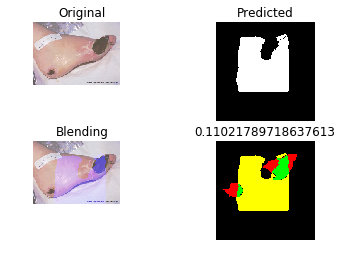

PREDICT... v2_07_s8_to_iPad
../testing_data/features/original_augment/v2_07_s8_to_iPad.txt
 , IoU = 0.029580504237065108
Saving... ../training_data/model/original_augment/results/model33.34/reports/v2_07_s8_to_iPad_report.png


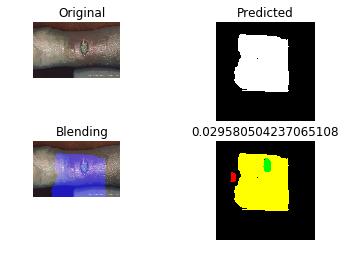

PREDICT... a_04_motoC_to_S8
../testing_data/features/original_augment/a_04_motoC_to_S8.txt
 , IoU = 0.003260869565217391
Saving... ../training_data/model/original_augment/results/model33.34/reports/a_04_motoC_to_S8_report.png


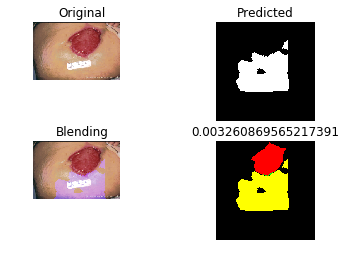

PREDICT... p1_73
../testing_data/features/original_augment/p1_73.txt
 , IoU = 0.07016348773841961
Saving... ../training_data/model/original_augment/results/model33.34/reports/p1_73_report.png


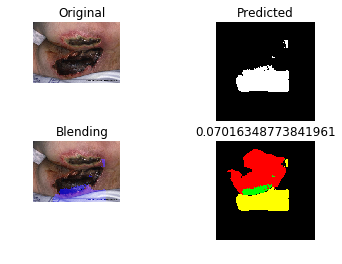

PREDICT... v1_84
../testing_data/features/original_augment/v1_84.txt
 , IoU = 0.06381358513554676
Saving... ../training_data/model/original_augment/results/model33.34/reports/v1_84_report.png


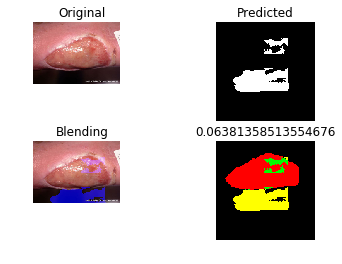

PREDICT... p2_54_s8_to_iPad
../testing_data/features/original_augment/p2_54_s8_to_iPad.txt
 , IoU = 0.0044291338582677165
Saving... ../training_data/model/original_augment/results/model33.34/reports/p2_54_s8_to_iPad_report.png


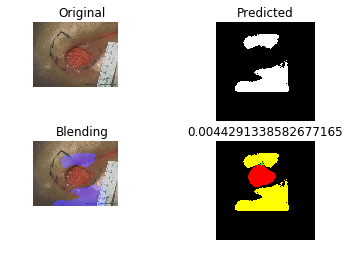

PREDICT... b_20
../testing_data/features/original_augment/b_20.txt
 , IoU = 0.31125243709961936
Saving... ../training_data/model/original_augment/results/model33.34/reports/b_20_report.png


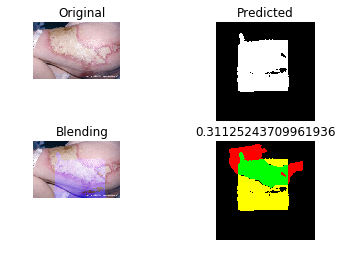

PREDICT... p1_81_motoC_to_S8
../testing_data/features/original_augment/p1_81_motoC_to_S8.txt
 , IoU = 0.1874370340519847
Saving... ../training_data/model/original_augment/results/model33.34/reports/p1_81_motoC_to_S8_report.png


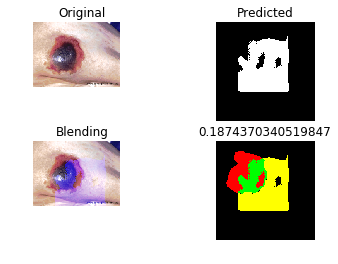

PREDICT... v1_32
../testing_data/features/original_augment/v1_32.txt
 , IoU = 0.0007391976345675694
Saving... ../training_data/model/original_augment/results/model33.34/reports/v1_32_report.png


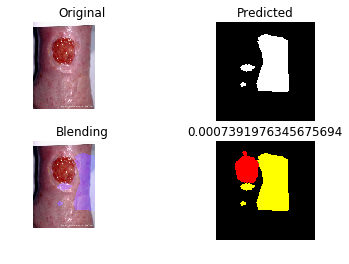

PREDICT... v1_32_motoC_to_S8
../testing_data/features/original_augment/v1_32_motoC_to_S8.txt
 , IoU = 0.011409316623315204
Saving... ../training_data/model/original_augment/results/model33.34/reports/v1_32_motoC_to_S8_report.png


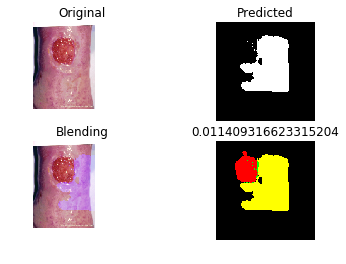

PREDICT... m_25_motoC_to_S8
../testing_data/features/original_augment/m_25_motoC_to_S8.txt
 , IoU = 0.07832455662490163
Saving... ../training_data/model/original_augment/results/model33.34/reports/m_25_motoC_to_S8_report.png


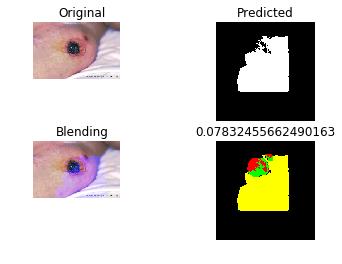

PREDICT... b_12_motoC_to_S8
../testing_data/features/original_augment/b_12_motoC_to_S8.txt
 , IoU = 0.0008263487191594853
Saving... ../training_data/model/original_augment/results/model33.34/reports/b_12_motoC_to_S8_report.png


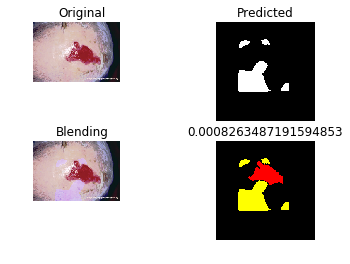

PREDICT... p2_57_s8_to_iPad
../testing_data/features/original_augment/p2_57_s8_to_iPad.txt
 , IoU = 0.1675665494726268
Saving... ../training_data/model/original_augment/results/model33.34/reports/p2_57_s8_to_iPad_report.png


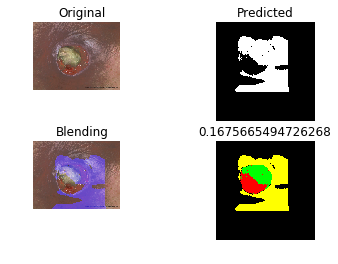

PREDICT... m_25
../testing_data/features/original_augment/m_25.txt
 , IoU = 0.04913512158435698
Saving... ../training_data/model/original_augment/results/model33.34/reports/m_25_report.png


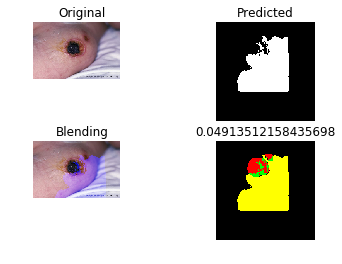

PREDICT... a_04_s8_to_iPad
../testing_data/features/original_augment/a_04_s8_to_iPad.txt
 , IoU = 0.00013026770012375432
Saving... ../training_data/model/original_augment/results/model33.34/reports/a_04_s8_to_iPad_report.png


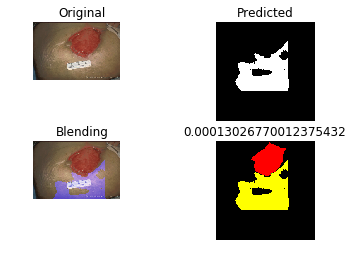

PREDICT... p1_81
../testing_data/features/original_augment/p1_81.txt
 , IoU = 0.060293120534084386
Saving... ../training_data/model/original_augment/results/model33.34/reports/p1_81_report.png


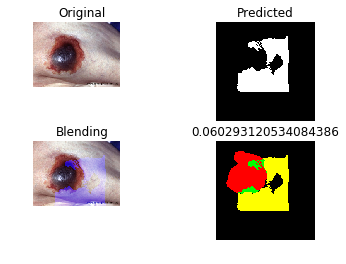

PREDICT... a_05_motoC_to_S8
../testing_data/features/original_augment/a_05_motoC_to_S8.txt
 , IoU = 0.003955537752853996
Saving... ../training_data/model/original_augment/results/model33.34/reports/a_05_motoC_to_S8_report.png


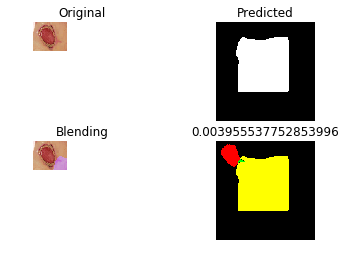

PREDICT... b_11_s8_to_iPad
../testing_data/features/original_augment/b_11_s8_to_iPad.txt
 , IoU = 0.00014830194275545008
Saving... ../training_data/model/original_augment/results/model33.34/reports/b_11_s8_to_iPad_report.png


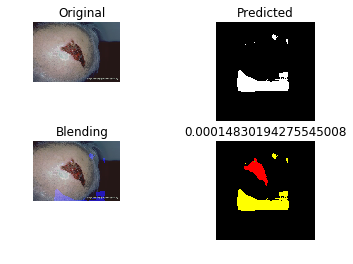

PREDICT... v1_84_s8_to_iPad
../testing_data/features/original_augment/v1_84_s8_to_iPad.txt
 , IoU = 0.0401437050921587
Saving... ../training_data/model/original_augment/results/model33.34/reports/v1_84_s8_to_iPad_report.png


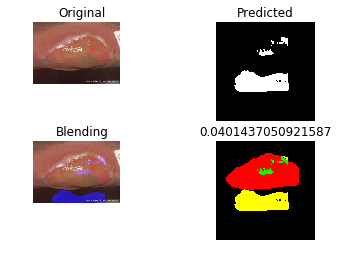

PREDICT... v1_70_motoC_to_S8
../testing_data/features/original_augment/v1_70_motoC_to_S8.txt
 , IoU = 0.1555182671039585
Saving... ../training_data/model/original_augment/results/model33.34/reports/v1_70_motoC_to_S8_report.png


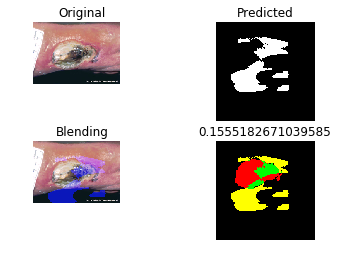

PREDICT... v1_32_s8_to_iPad
../testing_data/features/original_augment/v1_32_s8_to_iPad.txt
 , IoU = 0.0
Saving... ../training_data/model/original_augment/results/model33.34/reports/v1_32_s8_to_iPad_report.png


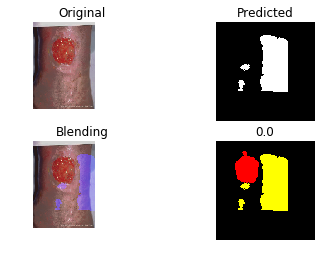

PREDICT... p1_72
../testing_data/features/original_augment/p1_72.txt
 , IoU = 0.025684478101996505
Saving... ../training_data/model/original_augment/results/model33.34/reports/p1_72_report.png


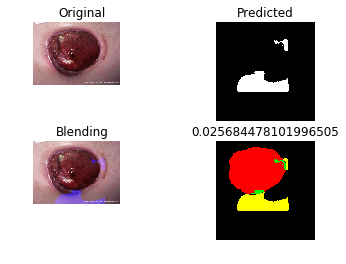

PREDICT... a_05_s8_to_iPad
../testing_data/features/original_augment/a_05_s8_to_iPad.txt
 , IoU = 0.002598328917872427
Saving... ../training_data/model/original_augment/results/model33.34/reports/a_05_s8_to_iPad_report.png


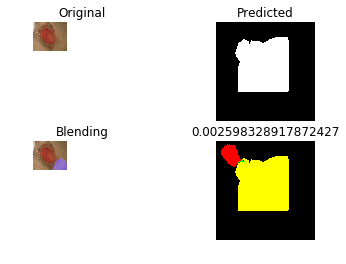

PREDICT... b_05_s8_to_iPad
../testing_data/features/original_augment/b_05_s8_to_iPad.txt
 , IoU = 0.10074608670210172
Saving... ../training_data/model/original_augment/results/model33.34/reports/b_05_s8_to_iPad_report.png


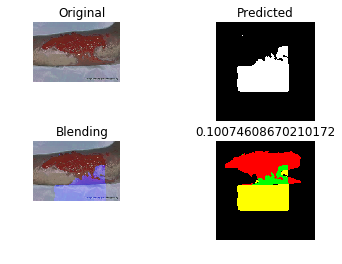

PREDICT... f_18
../testing_data/features/original_augment/f_18.txt
 , IoU = 0.07531380753138076
Saving... ../training_data/model/original_augment/results/model33.34/reports/f_18_report.png


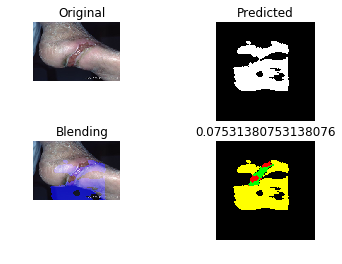

SEGMENTATION REPORT :: iou_avg 0.09877978540142818, iou_min 0.0
date: 2018-05-08 ,time: 15:02:27
	wound	not wound
    wound	133993	745079
not wound	380204	4049140
precision => 15.24
recall => 26.06
f-measure => 19.23
accuracy => 78.80
all sample => 5308416


In [33]:
#winner
#k-fold => 5
model_name = 'model33.34.model'
segmentation(root_path, model_name, color_dir_path, gray_dir_path)

training 200 epoch 

Image Dir is ../testing_data/features/original/
Model is ../training_data/model/original/model70.28.model
START : date: 2018-05-07 ,time: 16:21:37
PREDICT... b_12
../testing_data/features/original/b_12.txt
 , IoU = 0.6928753902923644
Saving... ../training_data/model/original/results/model70.28/reports/b_12_report.png


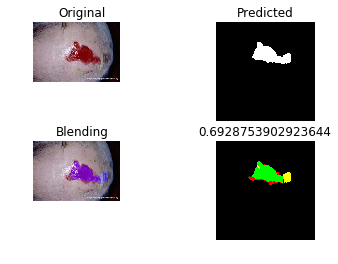

PREDICT... m_03
../testing_data/features/original/m_03.txt
 , IoU = 0.6798892988929889
Saving... ../training_data/model/original/results/model70.28/reports/m_03_report.png


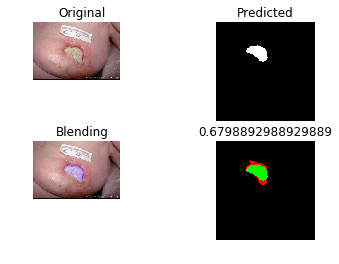

PREDICT... f_50
../testing_data/features/original/f_50.txt
 , IoU = 0.12680710450227178
Saving... ../training_data/model/original/results/model70.28/reports/f_50_report.png


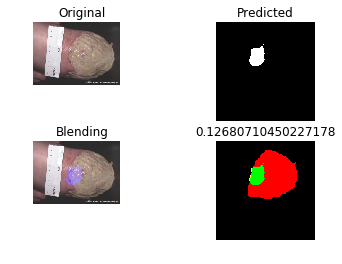

PREDICT... f_35
../testing_data/features/original/f_35.txt
 , IoU = 0.8866373813235086
Saving... ../training_data/model/original/results/model70.28/reports/f_35_report.png


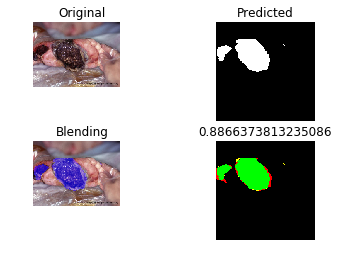

PREDICT... v2_07
../testing_data/features/original/v2_07.txt
 , IoU = 0.4635691657866948
Saving... ../training_data/model/original/results/model70.28/reports/v2_07_report.png


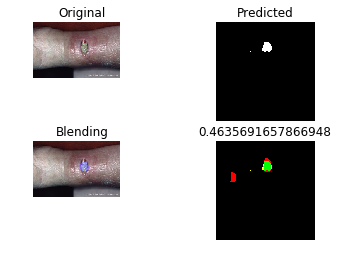

PREDICT... p2_54
../testing_data/features/original/p2_54.txt
 , IoU = 0.8922196025597844
Saving... ../training_data/model/original/results/model70.28/reports/p2_54_report.png


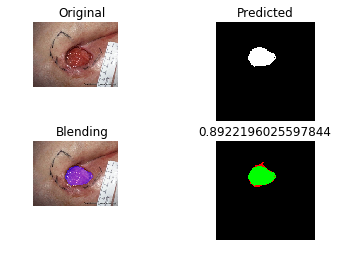

PREDICT... m_47
../testing_data/features/original/m_47.txt
 , IoU = 0.6844978165938864
Saving... ../training_data/model/original/results/model70.28/reports/m_47_report.png


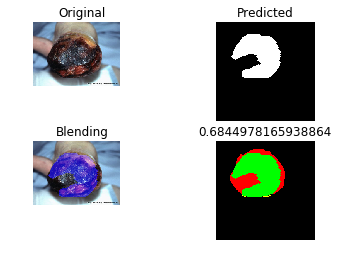

PREDICT... a_04
../testing_data/features/original/a_04.txt
 , IoU = 0.8745579363428334
Saving... ../training_data/model/original/results/model70.28/reports/a_04_report.png


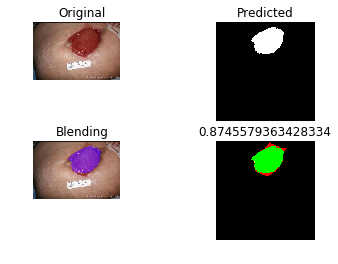

PREDICT... f_41
../testing_data/features/original/f_41.txt
 , IoU = 0.72970247100353
Saving... ../training_data/model/original/results/model70.28/reports/f_41_report.png


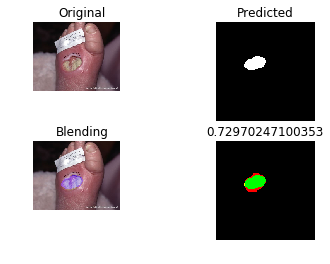

PREDICT... p2_57
../testing_data/features/original/p2_57.txt
 , IoU = 0.9406845585375341
Saving... ../training_data/model/original/results/model70.28/reports/p2_57_report.png


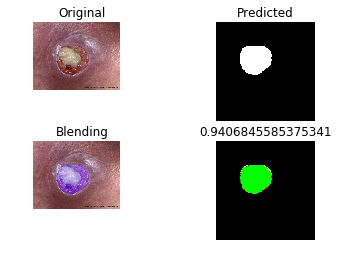

PREDICT... p1_82
../testing_data/features/original/p1_82.txt
 , IoU = 0.4679873930661864
Saving... ../training_data/model/original/results/model70.28/reports/p1_82_report.png


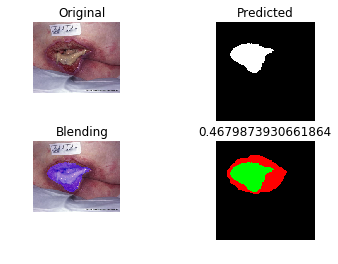

PREDICT... v1_70
../testing_data/features/original/v1_70.txt
 , IoU = 0.8875951634572324
Saving... ../training_data/model/original/results/model70.28/reports/v1_70_report.png


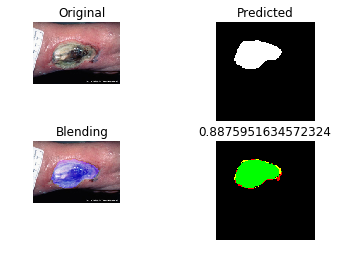

PREDICT... a_05
../testing_data/features/original/a_05.txt
 , IoU = 0.836574074074074
Saving... ../training_data/model/original/results/model70.28/reports/a_05_report.png


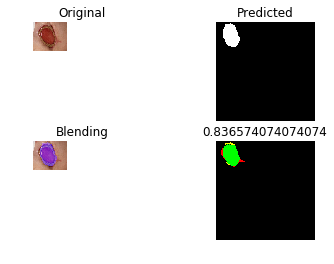

PREDICT... v1_76
../testing_data/features/original/v1_76.txt
 , IoU = 0.21163251817580964
Saving... ../training_data/model/original/results/model70.28/reports/v1_76_report.png


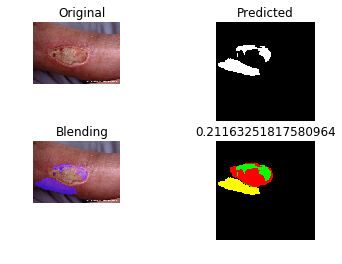

PREDICT... t_25
../testing_data/features/original/t_25.txt
 , IoU = 0.21848928974069898
Saving... ../training_data/model/original/results/model70.28/reports/t_25_report.png


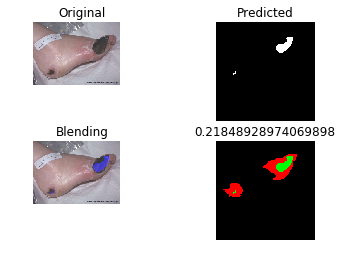

PREDICT... b_11
../testing_data/features/original/b_11.txt
 , IoU = 0.859553620032662
Saving... ../training_data/model/original/results/model70.28/reports/b_11_report.png


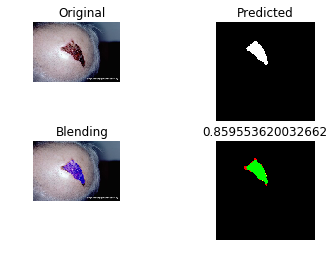

PREDICT... p1_67
../testing_data/features/original/p1_67.txt
 , IoU = 0.6719031676538759
Saving... ../training_data/model/original/results/model70.28/reports/p1_67_report.png


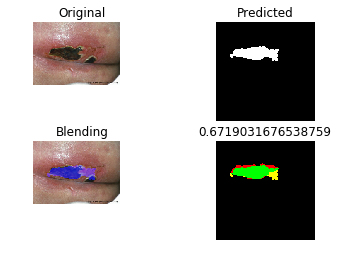

PREDICT... b_05
../testing_data/features/original/b_05.txt
 , IoU = 0.5283915837661766
Saving... ../training_data/model/original/results/model70.28/reports/b_05_report.png


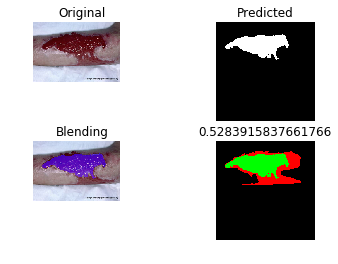

PREDICT... m_43
../testing_data/features/original/m_43.txt
 , IoU = 0.5515118347243125
Saving... ../training_data/model/original/results/model70.28/reports/m_43_report.png


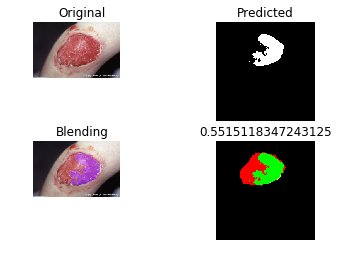

PREDICT... p1_73
../testing_data/features/original/p1_73.txt
 , IoU = 0.7267240685603927
Saving... ../training_data/model/original/results/model70.28/reports/p1_73_report.png


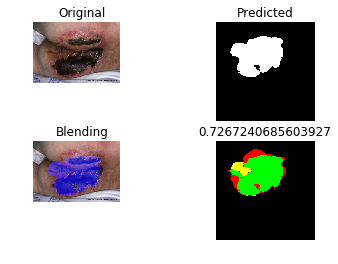

PREDICT... v1_84
../testing_data/features/original/v1_84.txt
 , IoU = 0.4046019612385144
Saving... ../training_data/model/original/results/model70.28/reports/v1_84_report.png


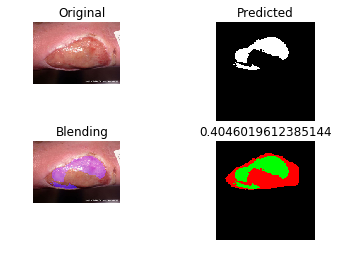

PREDICT... b_20
../testing_data/features/original/b_20.txt
 , IoU = 0.0
Saving... ../training_data/model/original/results/model70.28/reports/b_20_report.png


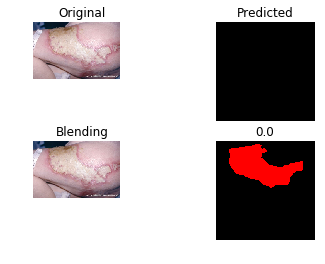

PREDICT... v1_32
../testing_data/features/original/v1_32.txt
 , IoU = 0.9053610503282276
Saving... ../training_data/model/original/results/model70.28/reports/v1_32_report.png


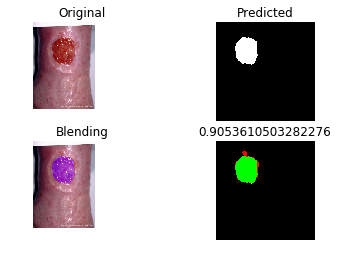

PREDICT... m_25
../testing_data/features/original/m_25.txt
 , IoU = 0.5955710955710956
Saving... ../training_data/model/original/results/model70.28/reports/m_25_report.png


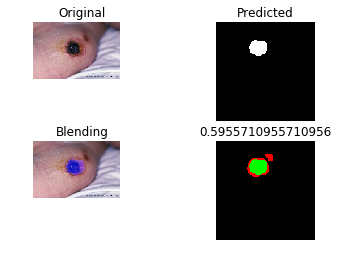

PREDICT... p1_81
../testing_data/features/original/p1_81.txt
 , IoU = 0.35709294199860236
Saving... ../training_data/model/original/results/model70.28/reports/p1_81_report.png


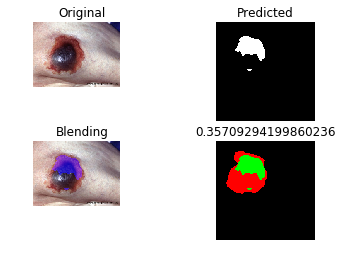

PREDICT... p1_72
../testing_data/features/original/p1_72.txt
 , IoU = 0.745954003407155
Saving... ../training_data/model/original/results/model70.28/reports/p1_72_report.png


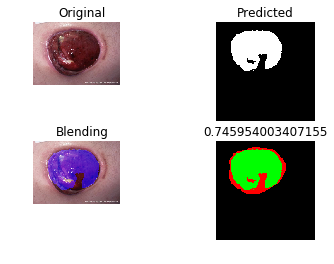

PREDICT... f_18
../testing_data/features/original/f_18.txt
 , IoU = 0.8546546546546546
Saving... ../training_data/model/original/results/model70.28/reports/f_18_report.png


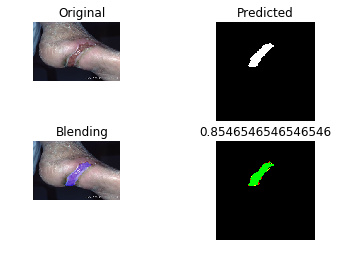

SEGMENTATION REPORT :: iou_avg 0.6220384868994467, iou_min 0.0
date: 2018-05-07 ,time: 16:22:21
	wound	not wound
    wound	98541	5722
not wound	72858	1592351
precision => 94.51
recall => 57.49
f-measure => 71.49
accuracy => 95.56
all sample => 1769472


In [109]:
#k-fold => 1
model_name = 'model70.28.model'
segmentation(root_path, model_name, color_dir_path, gray_dir_path)

Image Dir is ../testing_data/features/original/
Model is ../training_data/model/original/model70.91.model
START : date: 2018-05-07 ,time: 16:22:21
PREDICT... b_12
../testing_data/features/original/b_12.txt
 , IoU = 0.7372041827187672
Saving... ../training_data/model/original/results/model70.91/reports/b_12_report.png


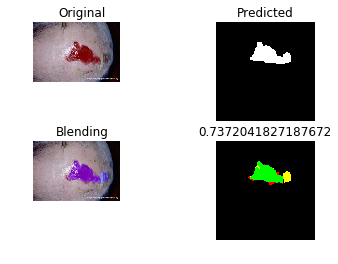

PREDICT... m_03
../testing_data/features/original/m_03.txt
 , IoU = 0.6873857404021938
Saving... ../training_data/model/original/results/model70.91/reports/m_03_report.png


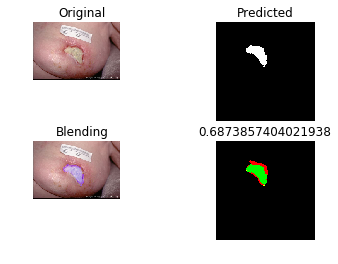

PREDICT... f_50
../testing_data/features/original/f_50.txt
 , IoU = 0.23835774230705942
Saving... ../training_data/model/original/results/model70.91/reports/f_50_report.png


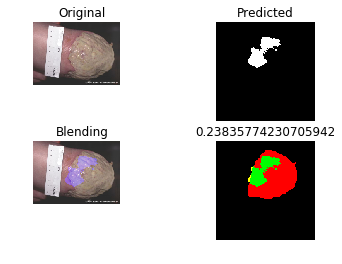

PREDICT... f_35
../testing_data/features/original/f_35.txt
 , IoU = 0.8471057884231536
Saving... ../training_data/model/original/results/model70.91/reports/f_35_report.png


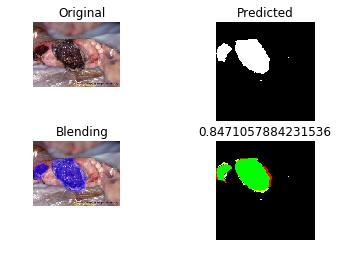

PREDICT... v2_07
../testing_data/features/original/v2_07.txt
 , IoU = 0.6063454759106933
Saving... ../training_data/model/original/results/model70.91/reports/v2_07_report.png


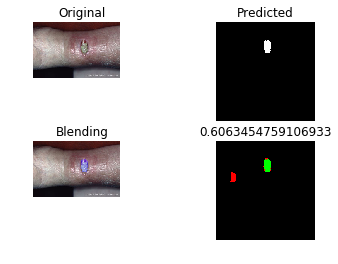

PREDICT... p2_54
../testing_data/features/original/p2_54.txt
 , IoU = 0.8806970509383378
Saving... ../training_data/model/original/results/model70.91/reports/p2_54_report.png


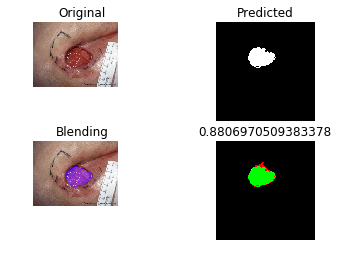

PREDICT... m_47
../testing_data/features/original/m_47.txt
 , IoU = 0.7964461138399307
Saving... ../training_data/model/original/results/model70.91/reports/m_47_report.png


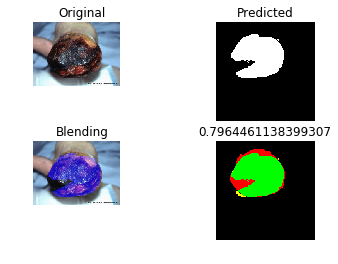

PREDICT... a_04
../testing_data/features/original/a_04.txt
 , IoU = 0.8514131338320865
Saving... ../training_data/model/original/results/model70.91/reports/a_04_report.png


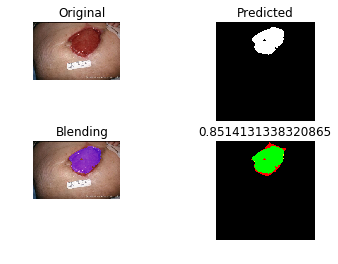

PREDICT... f_41
../testing_data/features/original/f_41.txt
 , IoU = 0.6404160475482912
Saving... ../training_data/model/original/results/model70.91/reports/f_41_report.png


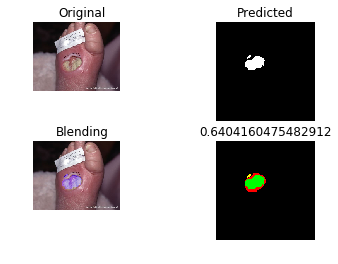

PREDICT... p2_57
../testing_data/features/original/p2_57.txt
 , IoU = 0.9406207827260459
Saving... ../training_data/model/original/results/model70.91/reports/p2_57_report.png


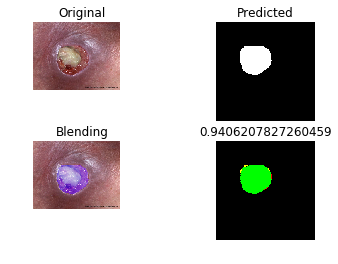

PREDICT... p1_82
../testing_data/features/original/p1_82.txt
 , IoU = 0.5085096803241783
Saving... ../training_data/model/original/results/model70.91/reports/p1_82_report.png


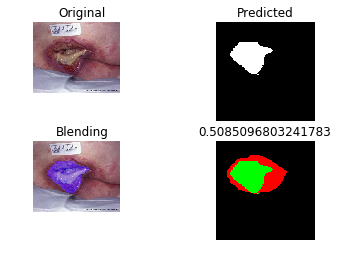

PREDICT... v1_70
../testing_data/features/original/v1_70.txt
 , IoU = 0.8937761819269898
Saving... ../training_data/model/original/results/model70.91/reports/v1_70_report.png


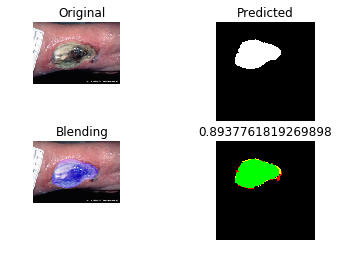

PREDICT... a_05
../testing_data/features/original/a_05.txt
 , IoU = 0.852082336045955
Saving... ../training_data/model/original/results/model70.91/reports/a_05_report.png


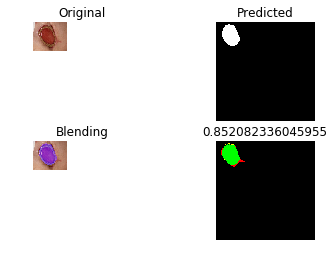

PREDICT... v1_76
../testing_data/features/original/v1_76.txt
 , IoU = 0.39894061890158905
Saving... ../training_data/model/original/results/model70.91/reports/v1_76_report.png


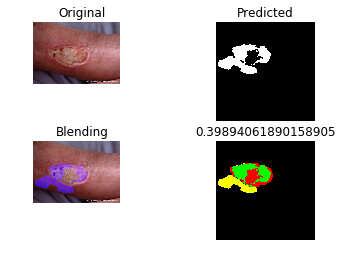

PREDICT... t_25
../testing_data/features/original/t_25.txt
 , IoU = 0.252648185711066
Saving... ../training_data/model/original/results/model70.91/reports/t_25_report.png


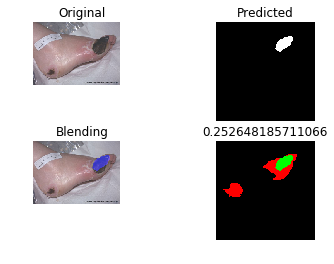

PREDICT... b_11
../testing_data/features/original/b_11.txt
 , IoU = 0.8401639344262295
Saving... ../training_data/model/original/results/model70.91/reports/b_11_report.png


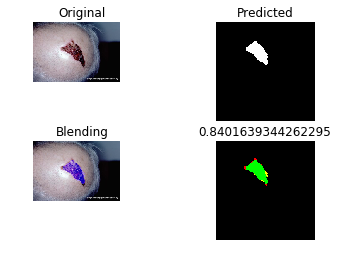

PREDICT... p1_67
../testing_data/features/original/p1_67.txt
 , IoU = 0.6181907813655411
Saving... ../training_data/model/original/results/model70.91/reports/p1_67_report.png


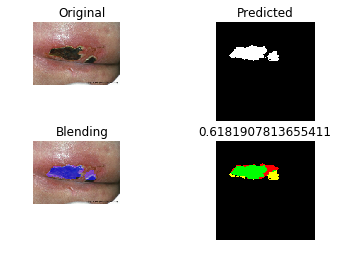

PREDICT... b_05
../testing_data/features/original/b_05.txt
 , IoU = 0.598706632875994
Saving... ../training_data/model/original/results/model70.91/reports/b_05_report.png


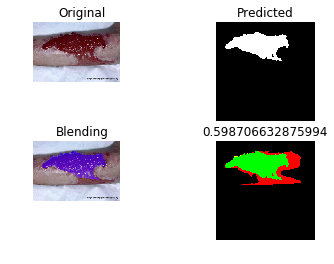

PREDICT... m_43
../testing_data/features/original/m_43.txt
 , IoU = 0.5492533223729278
Saving... ../training_data/model/original/results/model70.91/reports/m_43_report.png


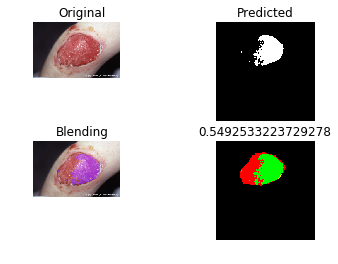

PREDICT... p1_73
../testing_data/features/original/p1_73.txt
 , IoU = 0.7273827778226132
Saving... ../training_data/model/original/results/model70.91/reports/p1_73_report.png


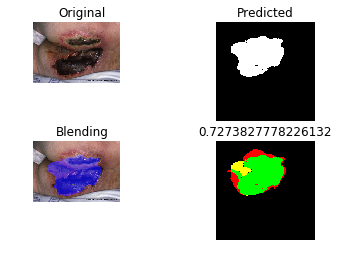

PREDICT... v1_84
../testing_data/features/original/v1_84.txt
 , IoU = 0.48683499343680026
Saving... ../training_data/model/original/results/model70.91/reports/v1_84_report.png


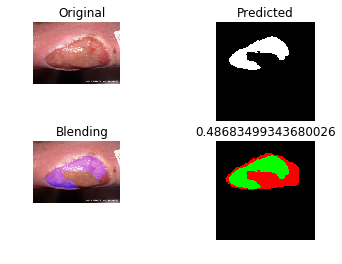

PREDICT... b_20
../testing_data/features/original/b_20.txt
 , IoU = 0.0
Saving... ../training_data/model/original/results/model70.91/reports/b_20_report.png


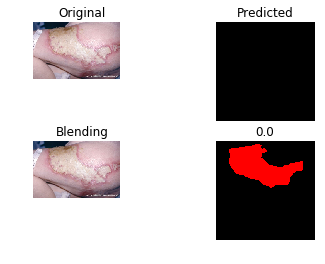

PREDICT... v1_32
../testing_data/features/original/v1_32.txt
 , IoU = 0.9243789243789243
Saving... ../training_data/model/original/results/model70.91/reports/v1_32_report.png


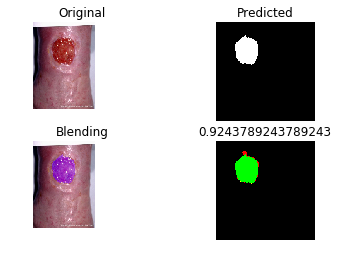

PREDICT... m_25
../testing_data/features/original/m_25.txt
 , IoU = 0.6468762126503687
Saving... ../training_data/model/original/results/model70.91/reports/m_25_report.png


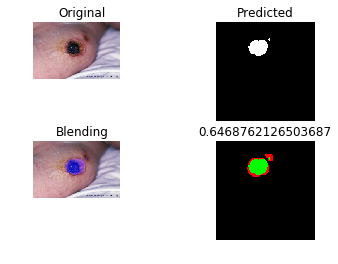

PREDICT... p1_81
../testing_data/features/original/p1_81.txt
 , IoU = 0.42569533341091587
Saving... ../training_data/model/original/results/model70.91/reports/p1_81_report.png


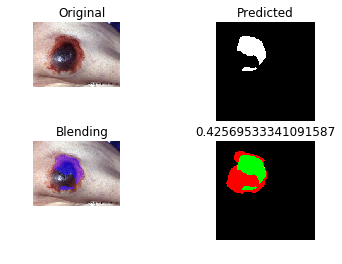

PREDICT... p1_72
../testing_data/features/original/p1_72.txt
 , IoU = 0.7482254400908575
Saving... ../training_data/model/original/results/model70.91/reports/p1_72_report.png


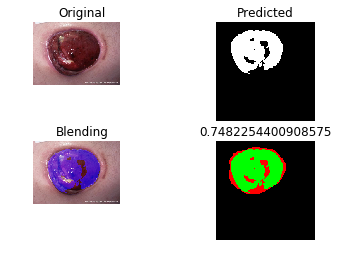

PREDICT... f_18
../testing_data/features/original/f_18.txt
 , IoU = 0.6006904487917146
Saving... ../training_data/model/original/results/model70.91/reports/f_18_report.png


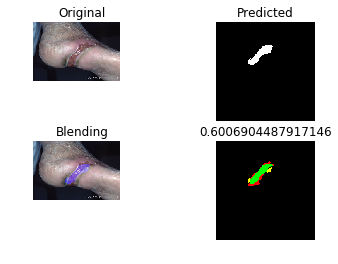

SEGMENTATION REPORT :: iou_avg 0.6406795504881194, iou_min 0.0
date: 2018-05-07 ,time: 16:23:04
	wound	not wound
    wound	105891	6211
not wound	65508	1591862
precision => 94.46
recall => 61.78
f-measure => 74.70
accuracy => 95.95
all sample => 1769472


In [110]:
#k-fold => 2
model_name = 'model70.91.model'
segmentation(root_path, model_name, color_dir_path, gray_dir_path)

Image Dir is ../testing_data/features/original/
Model is ../training_data/model/original/model68.47.model
START : date: 2018-05-07 ,time: 16:23:04
PREDICT... b_12
../testing_data/features/original/b_12.txt
 , IoU = 0.6896834061135371
Saving... ../training_data/model/original/results/model68.47/reports/b_12_report.png


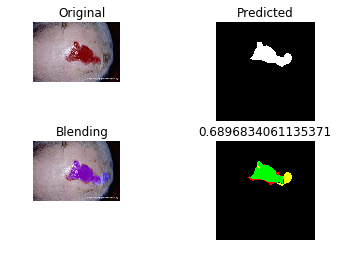

PREDICT... m_03
../testing_data/features/original/m_03.txt
 , IoU = 0.5291666666666667
Saving... ../training_data/model/original/results/model68.47/reports/m_03_report.png


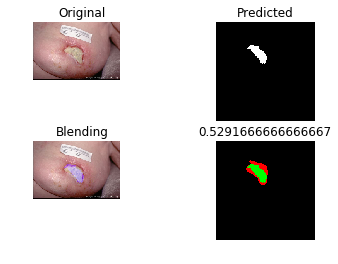

PREDICT... f_50
../testing_data/features/original/f_50.txt
 , IoU = 0.06887670322366235
Saving... ../training_data/model/original/results/model68.47/reports/f_50_report.png


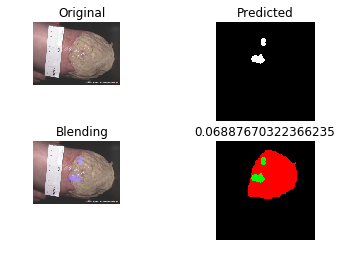

PREDICT... f_35
../testing_data/features/original/f_35.txt
 , IoU = 0.7915705867281578
Saving... ../training_data/model/original/results/model68.47/reports/f_35_report.png


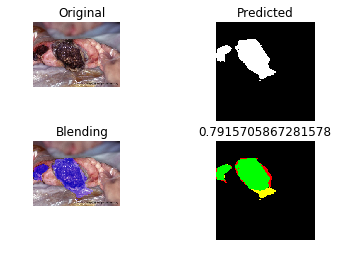

PREDICT... v2_07
../testing_data/features/original/v2_07.txt
 , IoU = 0.5868131868131868
Saving... ../training_data/model/original/results/model68.47/reports/v2_07_report.png


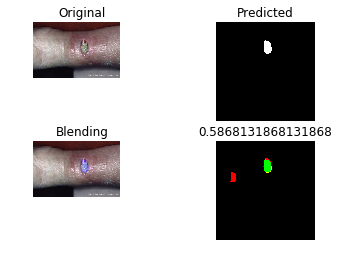

PREDICT... p2_54
../testing_data/features/original/p2_54.txt
 , IoU = 0.8709349593495935
Saving... ../training_data/model/original/results/model68.47/reports/p2_54_report.png


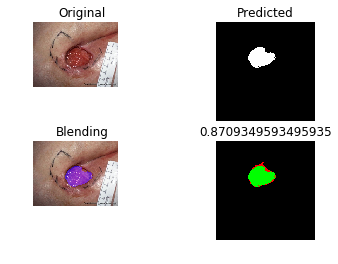

PREDICT... m_47
../testing_data/features/original/m_47.txt
 , IoU = 0.830877092574045
Saving... ../training_data/model/original/results/model68.47/reports/m_47_report.png


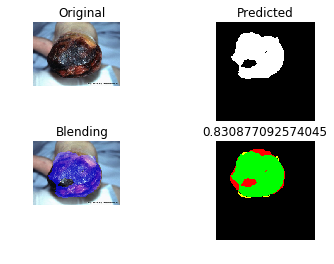

PREDICT... a_04
../testing_data/features/original/a_04.txt
 , IoU = 0.8578816714935871
Saving... ../training_data/model/original/results/model68.47/reports/a_04_report.png


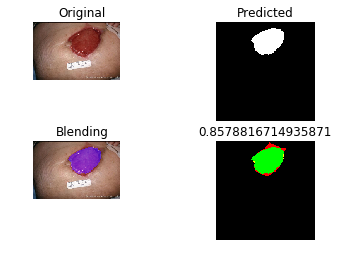

PREDICT... f_41
../testing_data/features/original/f_41.txt
 , IoU = 0.6675010429703796
Saving... ../training_data/model/original/results/model68.47/reports/f_41_report.png


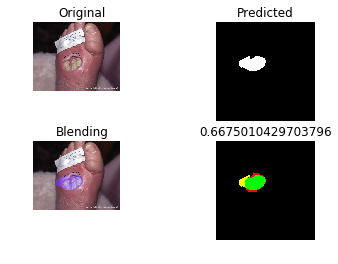

PREDICT... p2_57
../testing_data/features/original/p2_57.txt
 , IoU = 0.9267681634226248
Saving... ../training_data/model/original/results/model68.47/reports/p2_57_report.png


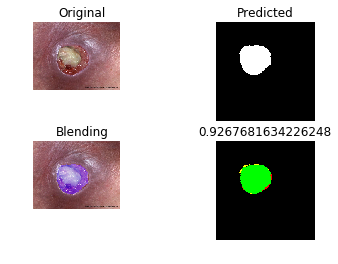

PREDICT... p1_82
../testing_data/features/original/p1_82.txt
 , IoU = 0.48482665466006303
Saving... ../training_data/model/original/results/model68.47/reports/p1_82_report.png


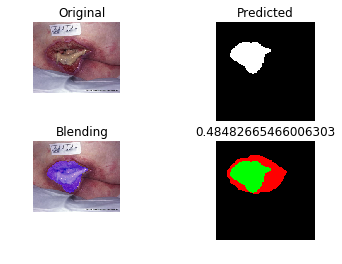

PREDICT... v1_70
../testing_data/features/original/v1_70.txt
 , IoU = 0.902660127805023
Saving... ../training_data/model/original/results/model68.47/reports/v1_70_report.png


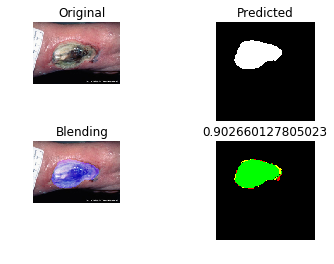

PREDICT... a_05
../testing_data/features/original/a_05.txt
 , IoU = 0.8401177047572339
Saving... ../training_data/model/original/results/model68.47/reports/a_05_report.png


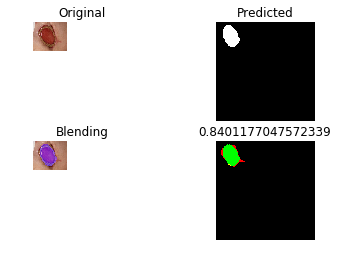

PREDICT... v1_76
../testing_data/features/original/v1_76.txt
 , IoU = 0.3718600708891971
Saving... ../training_data/model/original/results/model68.47/reports/v1_76_report.png


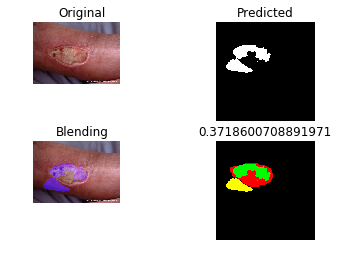

PREDICT... t_25
../testing_data/features/original/t_25.txt
 , IoU = 0.27846674182638104
Saving... ../training_data/model/original/results/model68.47/reports/t_25_report.png


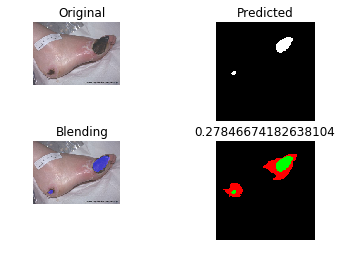

PREDICT... b_11
../testing_data/features/original/b_11.txt
 , IoU = 0.784101599247413
Saving... ../training_data/model/original/results/model68.47/reports/b_11_report.png


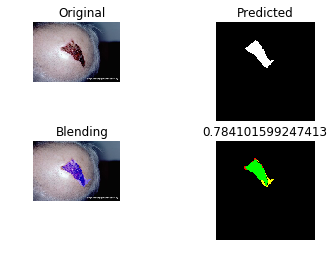

PREDICT... p1_67
../testing_data/features/original/p1_67.txt
 , IoU = 0.7698643410852714
Saving... ../training_data/model/original/results/model68.47/reports/p1_67_report.png


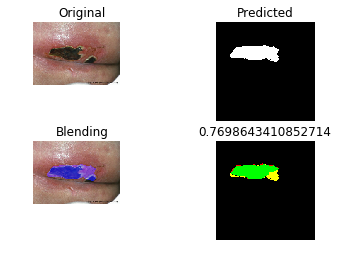

PREDICT... b_05
../testing_data/features/original/b_05.txt
 , IoU = 0.47583414032925436
Saving... ../training_data/model/original/results/model68.47/reports/b_05_report.png


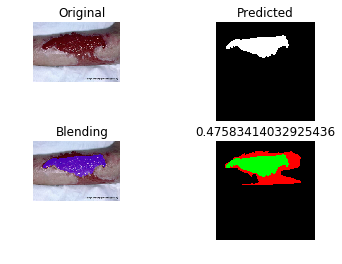

PREDICT... m_43
../testing_data/features/original/m_43.txt
 , IoU = 0.44671965512595985
Saving... ../training_data/model/original/results/model68.47/reports/m_43_report.png


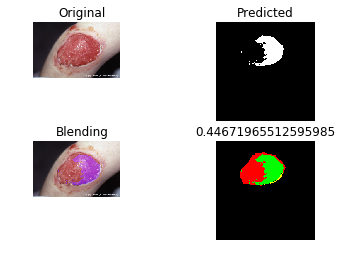

PREDICT... p1_73
../testing_data/features/original/p1_73.txt
 , IoU = 0.7224435590969456
Saving... ../training_data/model/original/results/model68.47/reports/p1_73_report.png


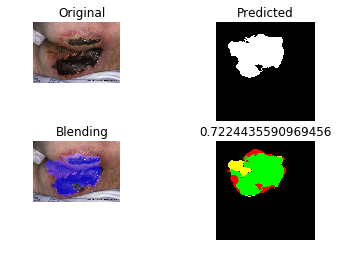

PREDICT... v1_84
../testing_data/features/original/v1_84.txt
 , IoU = 0.4470697243456104
Saving... ../training_data/model/original/results/model68.47/reports/v1_84_report.png


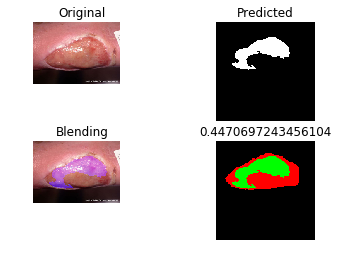

PREDICT... b_20
../testing_data/features/original/b_20.txt
 , IoU = 0.0
Saving... ../training_data/model/original/results/model68.47/reports/b_20_report.png


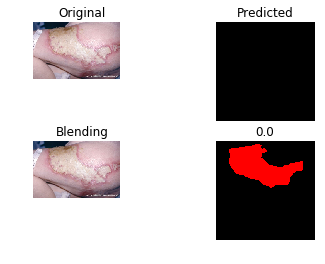

PREDICT... v1_32
../testing_data/features/original/v1_32.txt
 , IoU = 0.8994520547945205
Saving... ../training_data/model/original/results/model68.47/reports/v1_32_report.png


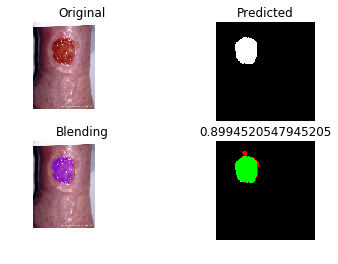

PREDICT... m_25
../testing_data/features/original/m_25.txt
 , IoU = 0.6410256410256411
Saving... ../training_data/model/original/results/model68.47/reports/m_25_report.png


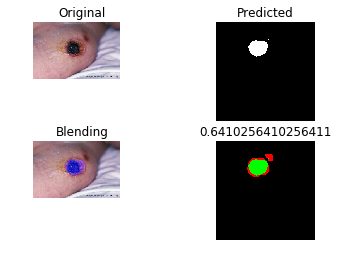

PREDICT... p1_81
../testing_data/features/original/p1_81.txt
 , IoU = 0.39778683750728017
Saving... ../training_data/model/original/results/model68.47/reports/p1_81_report.png


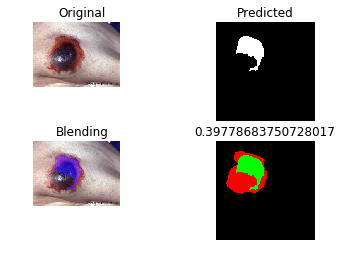

PREDICT... p1_72
../testing_data/features/original/p1_72.txt
 , IoU = 0.7659000567859171
Saving... ../training_data/model/original/results/model68.47/reports/p1_72_report.png


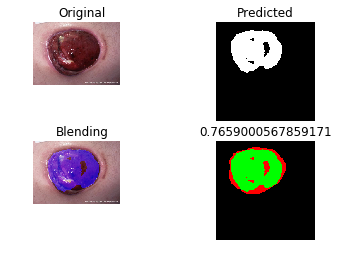

PREDICT... f_18
../testing_data/features/original/f_18.txt
 , IoU = 0.737721021611002
Saving... ../training_data/model/original/results/model68.47/reports/f_18_report.png


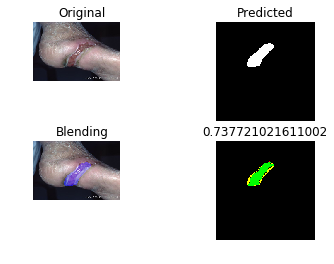

SEGMENTATION REPORT :: iou_avg 0.6217008670462278, iou_min 0.0
date: 2018-05-07 ,time: 16:23:51
	wound	not wound
    wound	102016	7193
not wound	69383	1590880
precision => 93.41
recall => 59.52
f-measure => 72.71
accuracy => 95.67
all sample => 1769472


In [111]:
#k-fold => 3
model_name = 'model68.47.model'
segmentation(root_path, model_name, color_dir_path, gray_dir_path)

Image Dir is ../testing_data/features/original/
Model is ../training_data/model/original/model72.23.model
START : date: 2018-05-07 ,time: 16:23:51
PREDICT... b_12
../testing_data/features/original/b_12.txt
 , IoU = 0.7152279896759393
Saving... ../training_data/model/original/results/model72.23/reports/b_12_report.png


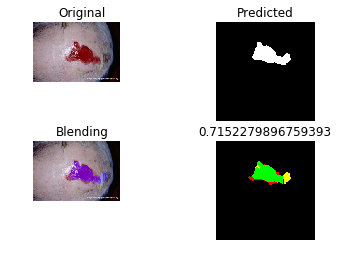

PREDICT... m_03
../testing_data/features/original/m_03.txt
 , IoU = 0.5407407407407407
Saving... ../training_data/model/original/results/model72.23/reports/m_03_report.png


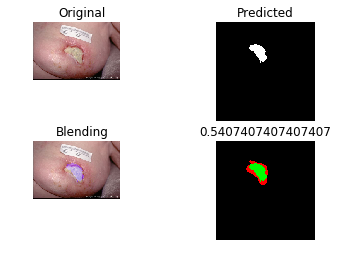

PREDICT... f_50
../testing_data/features/original/f_50.txt
 , IoU = 0.2024770275669197
Saving... ../training_data/model/original/results/model72.23/reports/f_50_report.png


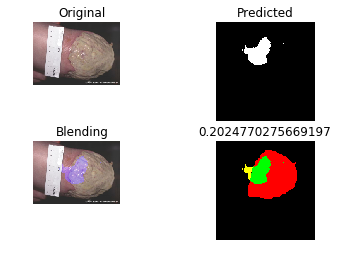

PREDICT... f_35
../testing_data/features/original/f_35.txt
 , IoU = 0.6398677158170829
Saving... ../training_data/model/original/results/model72.23/reports/f_35_report.png


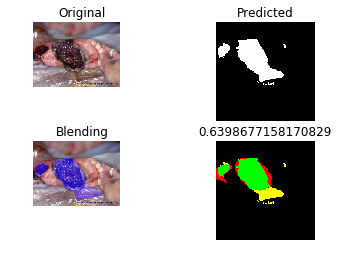

PREDICT... v2_07
../testing_data/features/original/v2_07.txt
 , IoU = 0.5702479338842975
Saving... ../training_data/model/original/results/model72.23/reports/v2_07_report.png


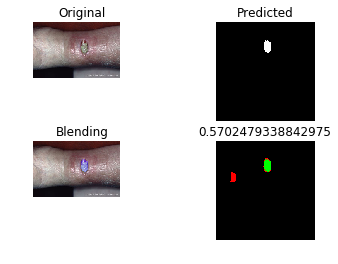

PREDICT... p2_54
../testing_data/features/original/p2_54.txt
 , IoU = 0.6033322652995835
Saving... ../training_data/model/original/results/model72.23/reports/p2_54_report.png


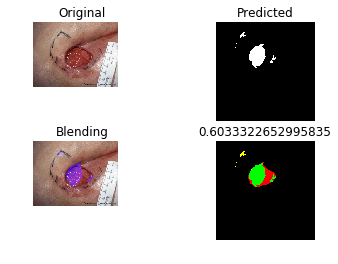

PREDICT... m_47
../testing_data/features/original/m_47.txt
 , IoU = 0.8300136621845114
Saving... ../training_data/model/original/results/model72.23/reports/m_47_report.png


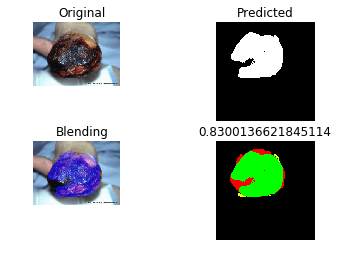

PREDICT... a_04
../testing_data/features/original/a_04.txt
 , IoU = 0.8214211294019588
Saving... ../training_data/model/original/results/model72.23/reports/a_04_report.png


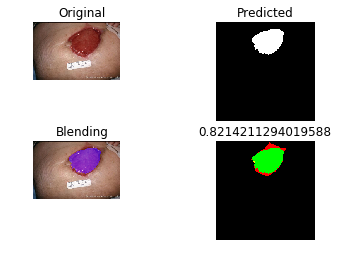

PREDICT... f_41
../testing_data/features/original/f_41.txt
 , IoU = 0.715764705882353
Saving... ../training_data/model/original/results/model72.23/reports/f_41_report.png


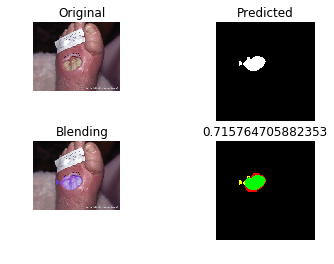

PREDICT... p2_57
../testing_data/features/original/p2_57.txt
 , IoU = 0.9453413732736822
Saving... ../training_data/model/original/results/model72.23/reports/p2_57_report.png


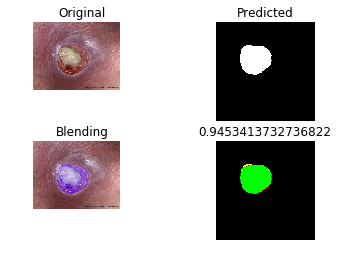

PREDICT... p1_82
../testing_data/features/original/p1_82.txt
 , IoU = 0.5226474561008555
Saving... ../training_data/model/original/results/model72.23/reports/p1_82_report.png


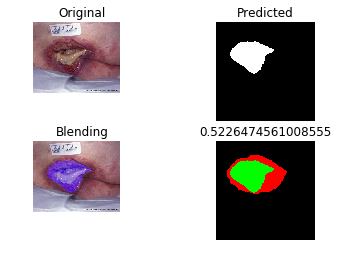

PREDICT... v1_70
../testing_data/features/original/v1_70.txt
 , IoU = 0.9107277954304736
Saving... ../training_data/model/original/results/model72.23/reports/v1_70_report.png


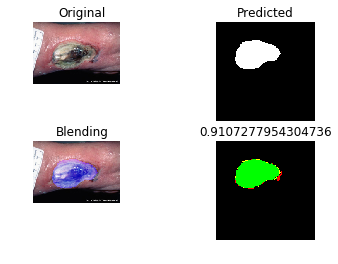

PREDICT... a_05
../testing_data/features/original/a_05.txt
 , IoU = 0.8506429277942631
Saving... ../training_data/model/original/results/model72.23/reports/a_05_report.png


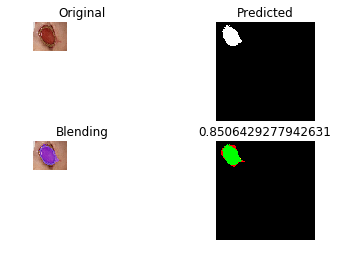

PREDICT... v1_76
../testing_data/features/original/v1_76.txt
 , IoU = 0.220966894377299
Saving... ../training_data/model/original/results/model72.23/reports/v1_76_report.png


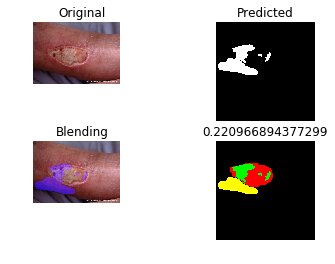

PREDICT... t_25
../testing_data/features/original/t_25.txt
 , IoU = 0.2781785392245266
Saving... ../training_data/model/original/results/model72.23/reports/t_25_report.png


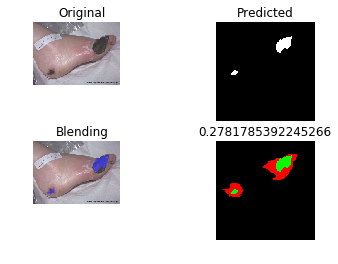

PREDICT... b_11
../testing_data/features/original/b_11.txt
 , IoU = 0.855635757912271
Saving... ../training_data/model/original/results/model72.23/reports/b_11_report.png


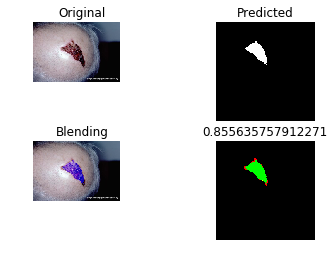

PREDICT... p1_67
../testing_data/features/original/p1_67.txt
 , IoU = 0.7767925006333924
Saving... ../training_data/model/original/results/model72.23/reports/p1_67_report.png


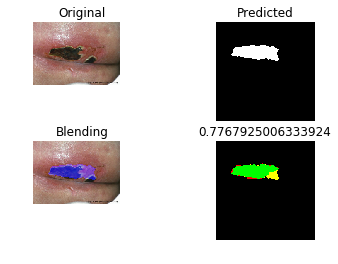

PREDICT... b_05
../testing_data/features/original/b_05.txt
 , IoU = 0.5467429577464789
Saving... ../training_data/model/original/results/model72.23/reports/b_05_report.png


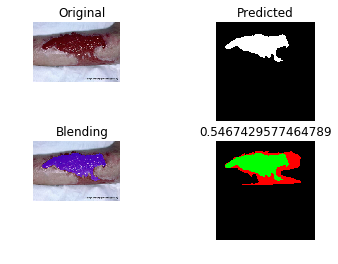

PREDICT... m_43
../testing_data/features/original/m_43.txt
 , IoU = 0.5233808116097823
Saving... ../training_data/model/original/results/model72.23/reports/m_43_report.png


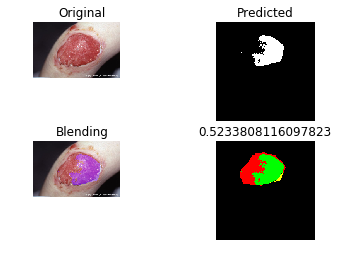

PREDICT... p1_73
../testing_data/features/original/p1_73.txt
 , IoU = 0.7223135321280426
Saving... ../training_data/model/original/results/model72.23/reports/p1_73_report.png


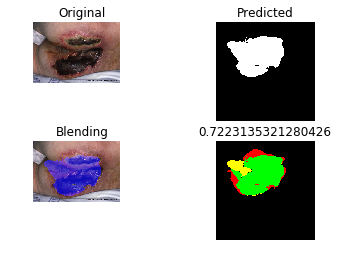

PREDICT... v1_84
../testing_data/features/original/v1_84.txt
 , IoU = 0.4455239417071478
Saving... ../training_data/model/original/results/model72.23/reports/v1_84_report.png


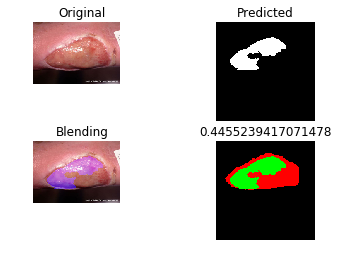

PREDICT... b_20
../testing_data/features/original/b_20.txt
 , IoU = 0.0
Saving... ../training_data/model/original/results/model72.23/reports/b_20_report.png


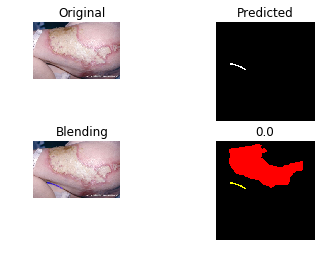

PREDICT... v1_32
../testing_data/features/original/v1_32.txt
 , IoU = 0.8986338797814207
Saving... ../training_data/model/original/results/model72.23/reports/v1_32_report.png


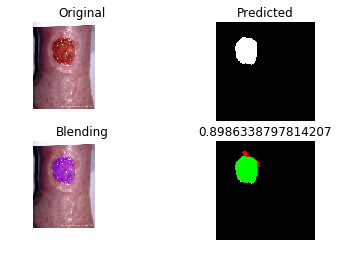

PREDICT... m_25
../testing_data/features/original/m_25.txt
 , IoU = 0.5733695652173914
Saving... ../training_data/model/original/results/model72.23/reports/m_25_report.png


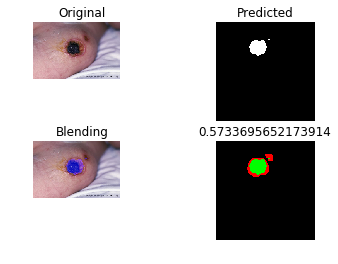

PREDICT... p1_81
../testing_data/features/original/p1_81.txt
 , IoU = 0.37673226971002677
Saving... ../training_data/model/original/results/model72.23/reports/p1_81_report.png


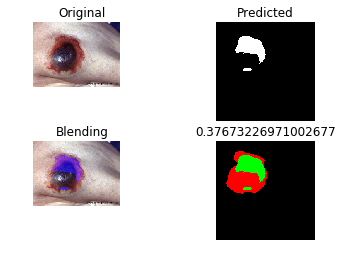

PREDICT... p1_72
../testing_data/features/original/p1_72.txt
 , IoU = 0.7741821020509545
Saving... ../training_data/model/original/results/model72.23/reports/p1_72_report.png


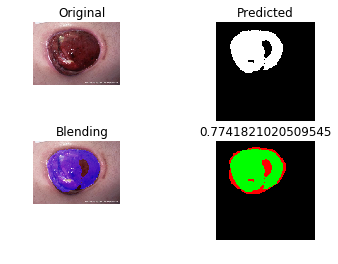

PREDICT... f_18
../testing_data/features/original/f_18.txt
 , IoU = 0.753
Saving... ../training_data/model/original/results/model72.23/reports/f_18_report.png


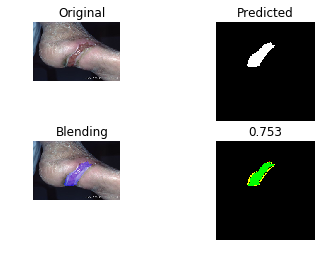

SEGMENTATION REPORT :: iou_avg 0.6153298324130146, iou_min 0.0
date: 2018-05-07 ,time: 16:24:34
	wound	not wound
    wound	102634	8962
not wound	68765	1589111
precision => 91.97
recall => 59.88
f-measure => 72.53
accuracy => 95.61
all sample => 1769472


In [112]:
#k-fold => 4
model_name = 'model72.23.model'
segmentation(root_path, model_name, color_dir_path, gray_dir_path)

Image Dir is ../testing_data/features/original/
Model is ../training_data/model/original/model71.28.model
START : date: 2018-05-07 ,time: 16:54:21
PREDICT... b_12
../testing_data/features/original/b_12.txt
 , IoU = 0.715758068890697
Saving... ../training_data/model/original/results/model71.28/reports/b_12_report.png


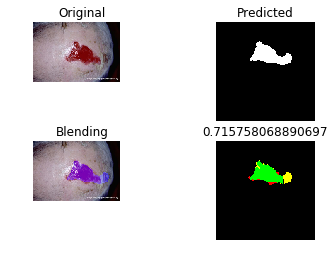

PREDICT... m_03
../testing_data/features/original/m_03.txt
 , IoU = 0.7613186813186813
Saving... ../training_data/model/original/results/model71.28/reports/m_03_report.png


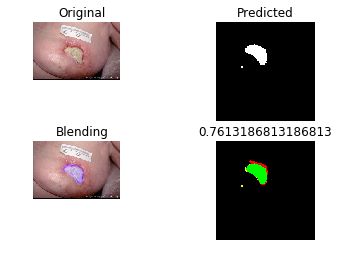

PREDICT... f_50
../testing_data/features/original/f_50.txt
 , IoU = 0.35262851922597793
Saving... ../training_data/model/original/results/model71.28/reports/f_50_report.png


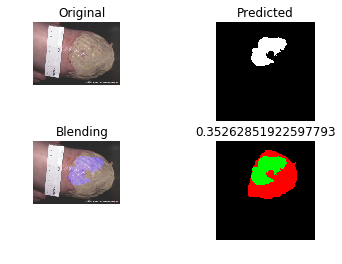

PREDICT... f_35
../testing_data/features/original/f_35.txt
 , IoU = 0.8349146110056926
Saving... ../training_data/model/original/results/model71.28/reports/f_35_report.png


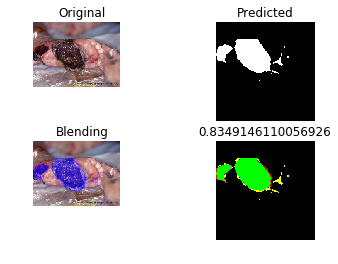

PREDICT... v2_07
../testing_data/features/original/v2_07.txt
 , IoU = 0.5913513513513513
Saving... ../training_data/model/original/results/model71.28/reports/v2_07_report.png


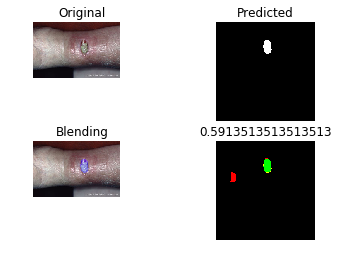

PREDICT... p2_54
../testing_data/features/original/p2_54.txt
 , IoU = 0.8818970861748295
Saving... ../training_data/model/original/results/model71.28/reports/p2_54_report.png


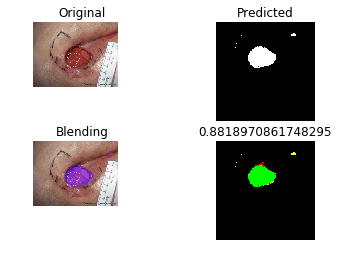

PREDICT... m_47
../testing_data/features/original/m_47.txt
 , IoU = 0.8067070995362112
Saving... ../training_data/model/original/results/model71.28/reports/m_47_report.png


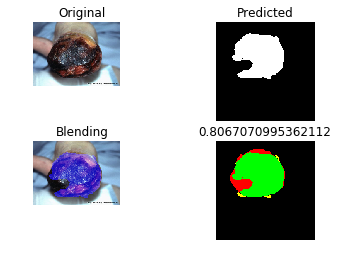

PREDICT... a_04
../testing_data/features/original/a_04.txt
 , IoU = 0.8508627773212818
Saving... ../training_data/model/original/results/model71.28/reports/a_04_report.png


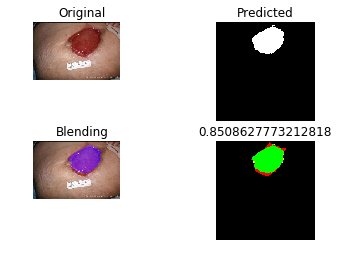

PREDICT... f_41
../testing_data/features/original/f_41.txt
 , IoU = 0.7298369325694138
Saving... ../training_data/model/original/results/model71.28/reports/f_41_report.png


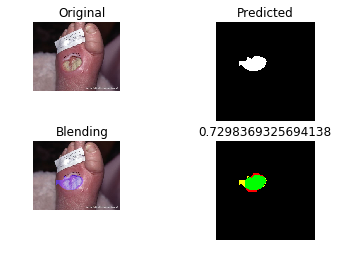

PREDICT... p2_57
../testing_data/features/original/p2_57.txt
 , IoU = 0.8551576696953501
Saving... ../training_data/model/original/results/model71.28/reports/p2_57_report.png


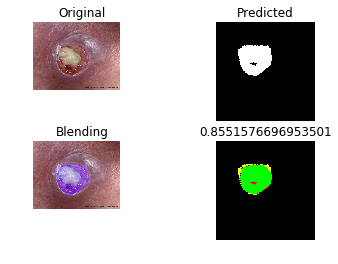

PREDICT... p1_82
../testing_data/features/original/p1_82.txt
 , IoU = 0.5283477321814255
Saving... ../training_data/model/original/results/model71.28/reports/p1_82_report.png


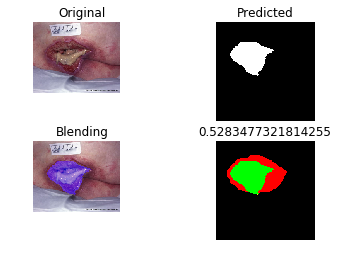

PREDICT... v1_70
../testing_data/features/original/v1_70.txt
 , IoU = 0.7656230510165898
Saving... ../training_data/model/original/results/model71.28/reports/v1_70_report.png


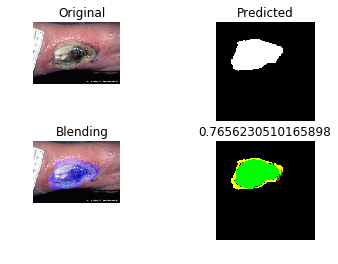

PREDICT... a_05
../testing_data/features/original/a_05.txt
 , IoU = 0.8143041792330892
Saving... ../training_data/model/original/results/model71.28/reports/a_05_report.png


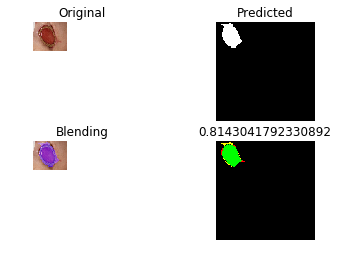

PREDICT... v1_76
../testing_data/features/original/v1_76.txt
 , IoU = 0.4759216589861751
Saving... ../training_data/model/original/results/model71.28/reports/v1_76_report.png


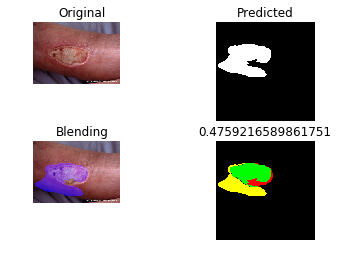

PREDICT... t_25
../testing_data/features/original/t_25.txt
 , IoU = 0.2520856820744081
Saving... ../training_data/model/original/results/model71.28/reports/t_25_report.png


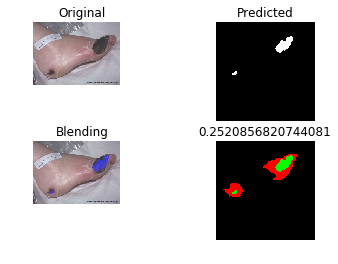

PREDICT... b_11
../testing_data/features/original/b_11.txt
 , IoU = 0.8143198090692124
Saving... ../training_data/model/original/results/model71.28/reports/b_11_report.png


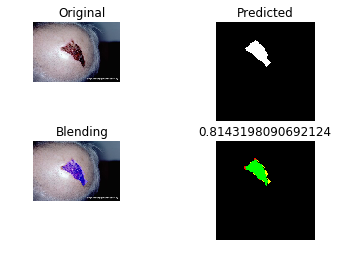

PREDICT... p1_67
../testing_data/features/original/p1_67.txt
 , IoU = 0.7479806138933764
Saving... ../training_data/model/original/results/model71.28/reports/p1_67_report.png


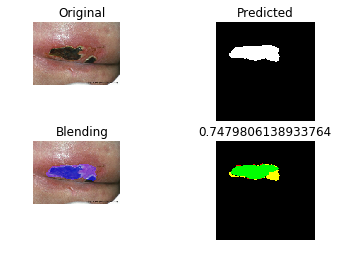

PREDICT... b_05
../testing_data/features/original/b_05.txt
 , IoU = 0.5804380332483068
Saving... ../training_data/model/original/results/model71.28/reports/b_05_report.png


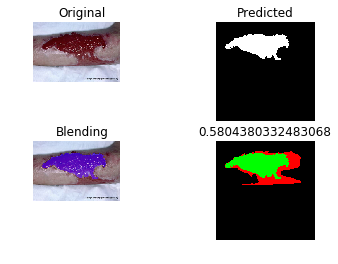

PREDICT... m_43
../testing_data/features/original/m_43.txt
 , IoU = 0.7467480753915583
Saving... ../training_data/model/original/results/model71.28/reports/m_43_report.png


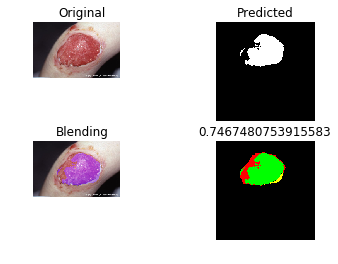

PREDICT... p1_73
../testing_data/features/original/p1_73.txt
 , IoU = 0.7268454307289258
Saving... ../training_data/model/original/results/model71.28/reports/p1_73_report.png


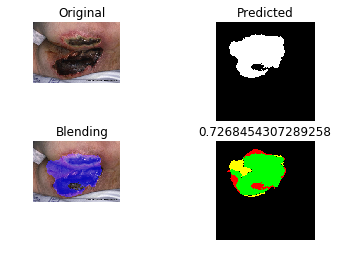

PREDICT... v1_84
../testing_data/features/original/v1_84.txt
 , IoU = 0.6542063189950514
Saving... ../training_data/model/original/results/model71.28/reports/v1_84_report.png


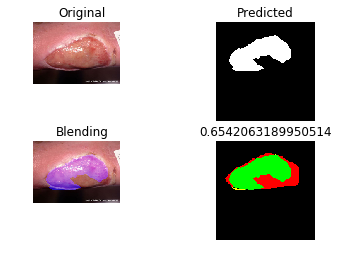

PREDICT... b_20
../testing_data/features/original/b_20.txt
 , IoU = 0.0
Saving... ../training_data/model/original/results/model71.28/reports/b_20_report.png


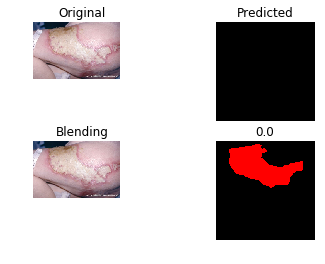

PREDICT... v1_32
../testing_data/features/original/v1_32.txt
 , IoU = 0.9169504846738276
Saving... ../training_data/model/original/results/model71.28/reports/v1_32_report.png


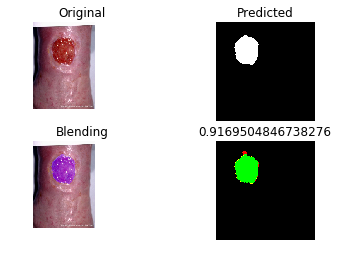

PREDICT... m_25
../testing_data/features/original/m_25.txt
 , IoU = 0.6926970354302241
Saving... ../training_data/model/original/results/model71.28/reports/m_25_report.png


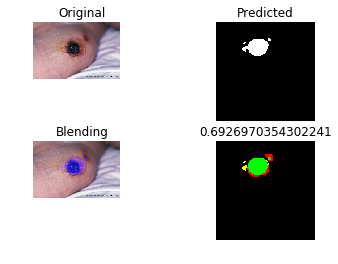

PREDICT... p1_81
../testing_data/features/original/p1_81.txt
 , IoU = 0.4398557468590042
Saving... ../training_data/model/original/results/model71.28/reports/p1_81_report.png


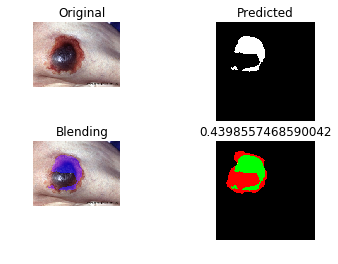

PREDICT... p1_72
../testing_data/features/original/p1_72.txt
 , IoU = 0.8223105307976156
Saving... ../training_data/model/original/results/model71.28/reports/p1_72_report.png


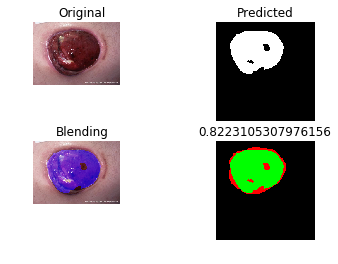

PREDICT... f_18
../testing_data/features/original/f_18.txt
 , IoU = 0.6644620811287478
Saving... ../training_data/model/original/results/model71.28/reports/f_18_report.png


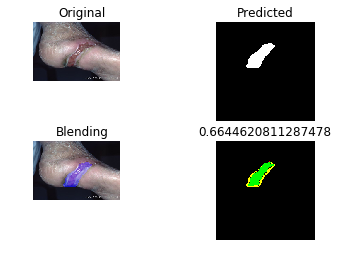

SEGMENTATION REPORT :: iou_avg 0.6675381207702601, iou_min 0.0
date: 2018-05-07 ,time: 16:54:57
	wound	not wound
    wound	117151	12333
not wound	54248	1585740
precision => 90.48
recall => 68.35
f-measure => 77.87
accuracy => 96.24
all sample => 1769472


In [113]:
#k-fold => 5
model_name = 'model71.28.model'
segmentation(root_path, model_name, color_dir_path, gray_dir_path)

train 75 epoch

Image Dir is ../testing_data/features/original/
Model is ../training_data/model/original/model65.78.model
START : date: 2018-05-07 ,time: 18:19:20
PREDICT... b_12
../testing_data/features/original/b_12.txt
 , IoU = 0.6433761878144215
Saving... ../training_data/model/original/results/model65.78/reports/b_12_report.png


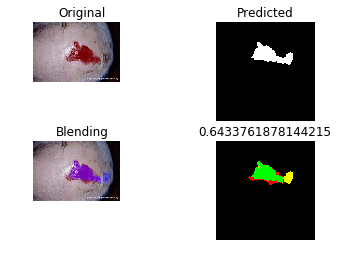

PREDICT... m_03
../testing_data/features/original/m_03.txt
 , IoU = 0.5539102267468764
Saving... ../training_data/model/original/results/model65.78/reports/m_03_report.png


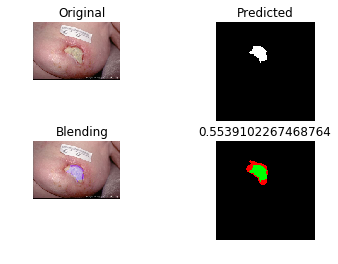

PREDICT... f_50
../testing_data/features/original/f_50.txt
 , IoU = 0.12288276320159415
Saving... ../training_data/model/original/results/model65.78/reports/f_50_report.png


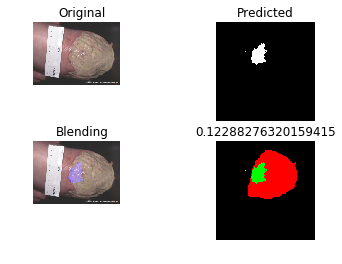

PREDICT... f_35
../testing_data/features/original/f_35.txt
 , IoU = 0.6701613853221816
Saving... ../training_data/model/original/results/model65.78/reports/f_35_report.png


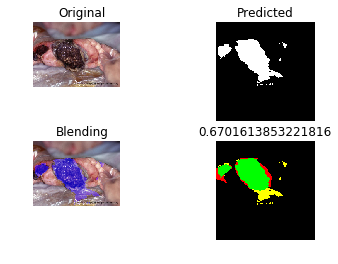

PREDICT... v2_07
../testing_data/features/original/v2_07.txt
 , IoU = 0.4974039460020768
Saving... ../training_data/model/original/results/model65.78/reports/v2_07_report.png


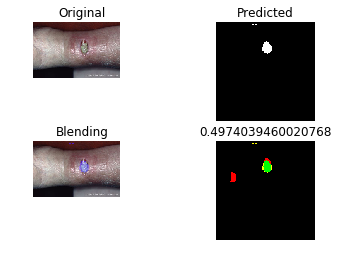

PREDICT... p2_54
../testing_data/features/original/p2_54.txt
 , IoU = 0.8824446523230434
Saving... ../training_data/model/original/results/model65.78/reports/p2_54_report.png


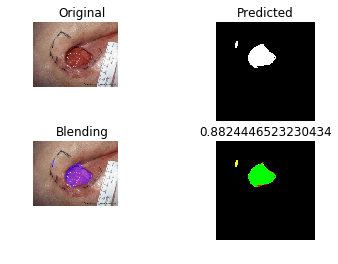

PREDICT... m_47
../testing_data/features/original/m_47.txt
 , IoU = 0.7059643459760839
Saving... ../training_data/model/original/results/model65.78/reports/m_47_report.png


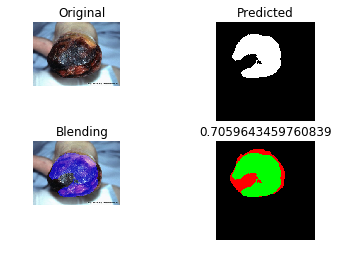

PREDICT... a_04
../testing_data/features/original/a_04.txt
 , IoU = 0.8817744297970287
Saving... ../training_data/model/original/results/model65.78/reports/a_04_report.png


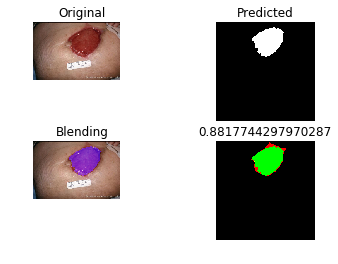

PREDICT... f_41
../testing_data/features/original/f_41.txt
 , IoU = 0.6553471870248353
Saving... ../training_data/model/original/results/model65.78/reports/f_41_report.png


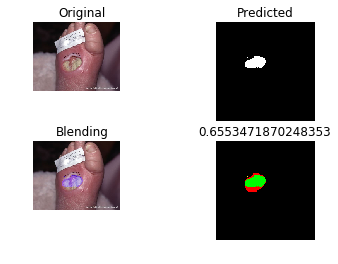

PREDICT... p2_57
../testing_data/features/original/p2_57.txt
 , IoU = 0.8382352941176471
Saving... ../training_data/model/original/results/model65.78/reports/p2_57_report.png


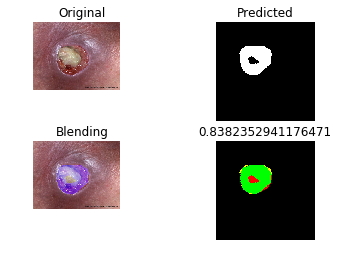

PREDICT... p1_82
../testing_data/features/original/p1_82.txt
 , IoU = 0.37280504277352544
Saving... ../training_data/model/original/results/model65.78/reports/p1_82_report.png


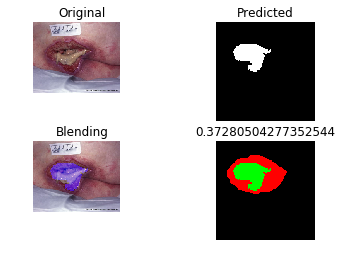

PREDICT... v1_70
../testing_data/features/original/v1_70.txt
 , IoU = 0.8438063740228503
Saving... ../training_data/model/original/results/model65.78/reports/v1_70_report.png


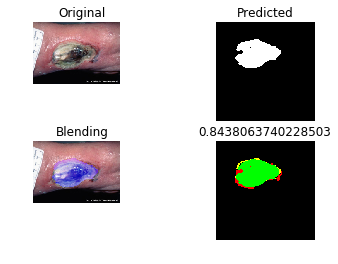

PREDICT... a_05
../testing_data/features/original/a_05.txt
 , IoU = 0.8488602576808721
Saving... ../training_data/model/original/results/model65.78/reports/a_05_report.png


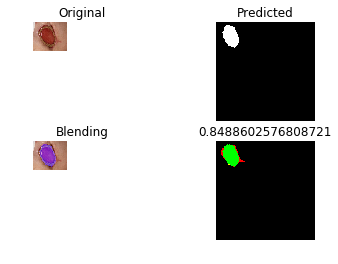

PREDICT... v1_76
../testing_data/features/original/v1_76.txt
 , IoU = 0.3144215060151493
Saving... ../training_data/model/original/results/model65.78/reports/v1_76_report.png


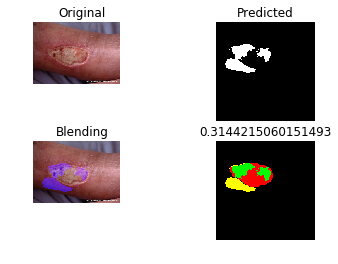

PREDICT... t_25
../testing_data/features/original/t_25.txt
 , IoU = 0.05794813979706877
Saving... ../training_data/model/original/results/model65.78/reports/t_25_report.png


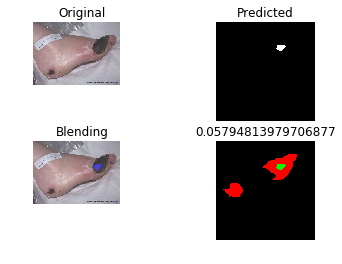

PREDICT... b_11
../testing_data/features/original/b_11.txt
 , IoU = 0.7827638959714431
Saving... ../training_data/model/original/results/model65.78/reports/b_11_report.png


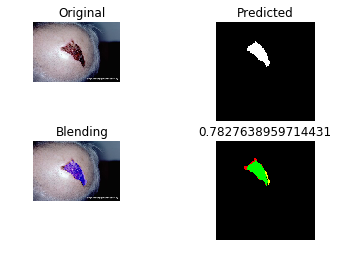

PREDICT... p1_67
../testing_data/features/original/p1_67.txt
 , IoU = 0.7506835694755157
Saving... ../training_data/model/original/results/model65.78/reports/p1_67_report.png


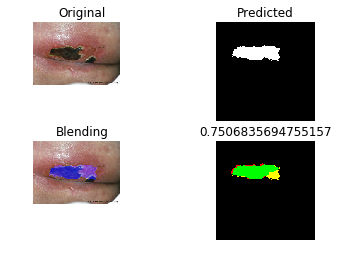

PREDICT... b_05
../testing_data/features/original/b_05.txt
 , IoU = 0.47306812180954055
Saving... ../training_data/model/original/results/model65.78/reports/b_05_report.png


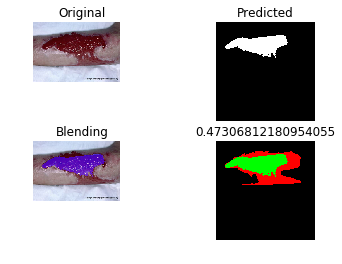

PREDICT... m_43
../testing_data/features/original/m_43.txt
 , IoU = 0.35497124075595726
Saving... ../training_data/model/original/results/model65.78/reports/m_43_report.png


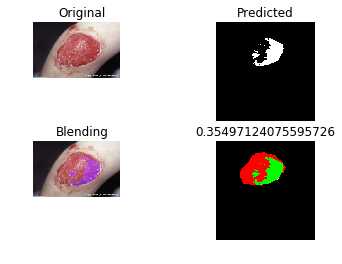

PREDICT... p1_73
../testing_data/features/original/p1_73.txt
 , IoU = 0.6954808620135091
Saving... ../training_data/model/original/results/model65.78/reports/p1_73_report.png


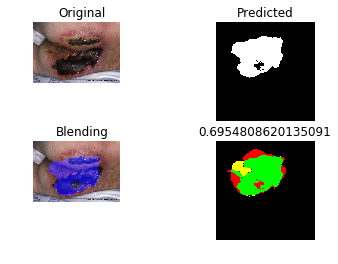

PREDICT... v1_84
../testing_data/features/original/v1_84.txt
 , IoU = 0.28576943865338583
Saving... ../training_data/model/original/results/model65.78/reports/v1_84_report.png


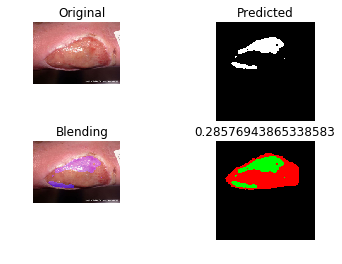

PREDICT... b_20
../testing_data/features/original/b_20.txt
 , IoU = 0.0
Saving... ../training_data/model/original/results/model65.78/reports/b_20_report.png


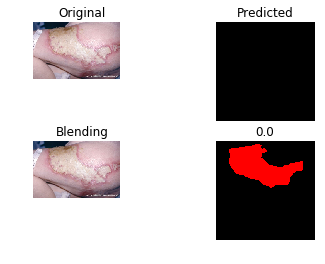

PREDICT... v1_32
../testing_data/features/original/v1_32.txt
 , IoU = 0.8382474510884541
Saving... ../training_data/model/original/results/model65.78/reports/v1_32_report.png


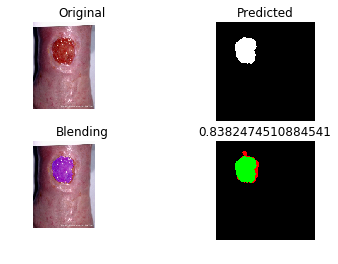

PREDICT... m_25
../testing_data/features/original/m_25.txt
 , IoU = 0.5275835275835276
Saving... ../training_data/model/original/results/model65.78/reports/m_25_report.png


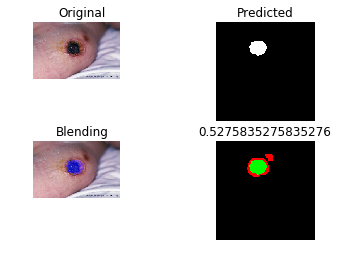

PREDICT... p1_81
../testing_data/features/original/p1_81.txt
 , IoU = 0.31287128712871287
Saving... ../training_data/model/original/results/model65.78/reports/p1_81_report.png


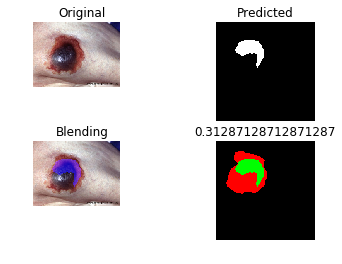

PREDICT... p1_72
../testing_data/features/original/p1_72.txt
 , IoU = 0.6296138557637706
Saving... ../training_data/model/original/results/model65.78/reports/p1_72_report.png


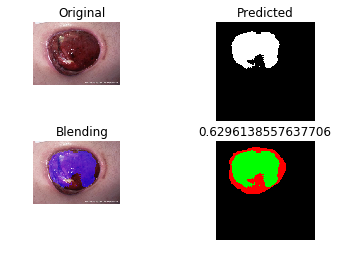

PREDICT... f_18
../testing_data/features/original/f_18.txt
 , IoU = 0.7182587666263603
Saving... ../training_data/model/original/results/model65.78/reports/f_18_report.png


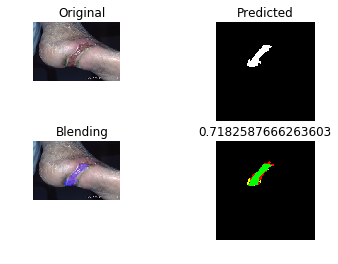

SEGMENTATION REPORT :: iou_avg 0.5651353242772382, iou_min 0.0
date: 2018-05-07 ,time: 18:20:05
	wound	not wound
    wound	89352	6640
not wound	82047	1591433
precision => 93.08
recall => 52.13
f-measure => 66.83
accuracy => 94.99
all sample => 1769472


In [114]:
#k-fold => 1
model_name = 'model65.78.model'
segmentation(root_path, model_name, color_dir_path, gray_dir_path)

Image Dir is ../testing_data/features/original/
Model is ../training_data/model/original/model66.88.model
START : date: 2018-05-08 ,time: 11:10:47
PREDICT... b_12
../testing_data/features/original/b_12.txt
 , IoU = 0.6952191235059761
Saving... ../training_data/model/original/results/model66.88/reports/b_12_report.png


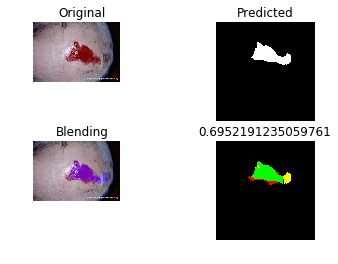

PREDICT... m_03
../testing_data/features/original/m_03.txt
 , IoU = 0.2175925925925926
Saving... ../training_data/model/original/results/model66.88/reports/m_03_report.png


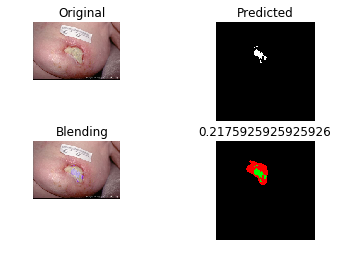

PREDICT... f_50
../testing_data/features/original/f_50.txt
 , IoU = 0.04494848786972416
Saving... ../training_data/model/original/results/model66.88/reports/f_50_report.png


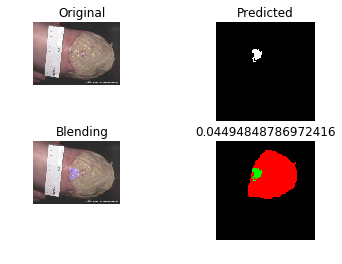

PREDICT... f_35
../testing_data/features/original/f_35.txt
 , IoU = 0.6590673575129534
Saving... ../training_data/model/original/results/model66.88/reports/f_35_report.png


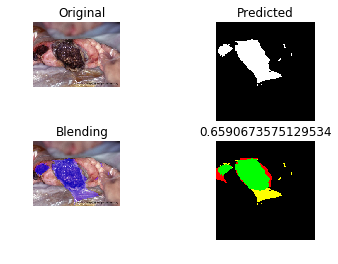

PREDICT... v2_07
../testing_data/features/original/v2_07.txt
 , IoU = 0.2693682955899881
Saving... ../training_data/model/original/results/model66.88/reports/v2_07_report.png


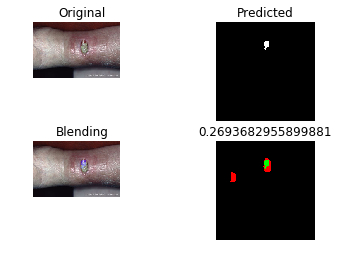

PREDICT... p2_54
../testing_data/features/original/p2_54.txt
 , IoU = 0.8861462511570503
Saving... ../training_data/model/original/results/model66.88/reports/p2_54_report.png


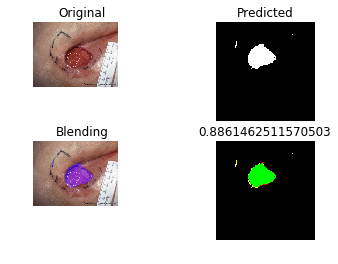

PREDICT... m_47
../testing_data/features/original/m_47.txt
 , IoU = 0.6888627854048895
Saving... ../training_data/model/original/results/model66.88/reports/m_47_report.png


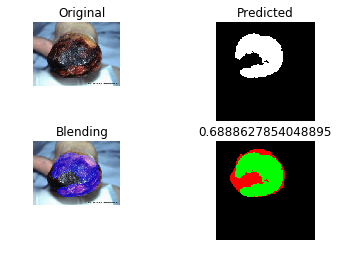

PREDICT... a_04
../testing_data/features/original/a_04.txt
 , IoU = 0.8764718033464161
Saving... ../training_data/model/original/results/model66.88/reports/a_04_report.png


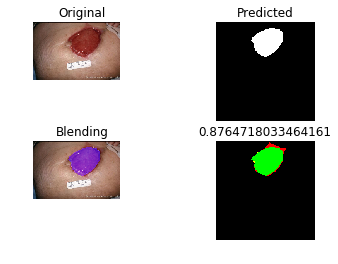

PREDICT... f_41
../testing_data/features/original/f_41.txt
 , IoU = 0.5250112663361874
Saving... ../training_data/model/original/results/model66.88/reports/f_41_report.png


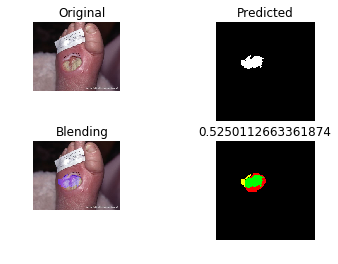

PREDICT... p2_57
../testing_data/features/original/p2_57.txt
 , IoU = 0.7423220973782771
Saving... ../training_data/model/original/results/model66.88/reports/p2_57_report.png


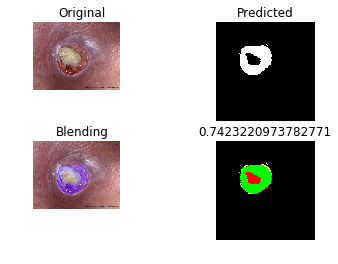

PREDICT... p1_82
../testing_data/features/original/p1_82.txt
 , IoU = 0.4039621791985592
Saving... ../training_data/model/original/results/model66.88/reports/p1_82_report.png


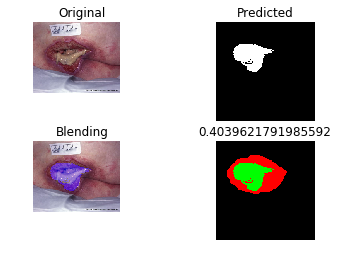

PREDICT... v1_70
../testing_data/features/original/v1_70.txt
 , IoU = 0.7341154959622124
Saving... ../training_data/model/original/results/model66.88/reports/v1_70_report.png


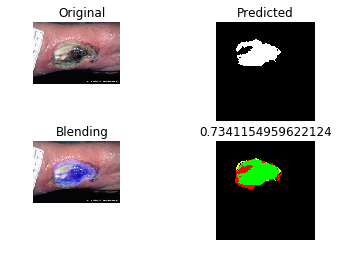

PREDICT... a_05
../testing_data/features/original/a_05.txt
 , IoU = 0.686029043565348
Saving... ../training_data/model/original/results/model66.88/reports/a_05_report.png


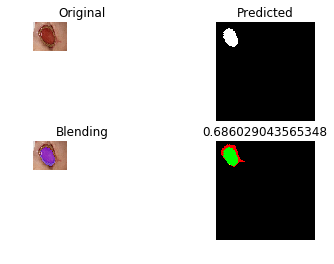

PREDICT... v1_76
../testing_data/features/original/v1_76.txt
 , IoU = 0.3245361484325016
Saving... ../training_data/model/original/results/model66.88/reports/v1_76_report.png


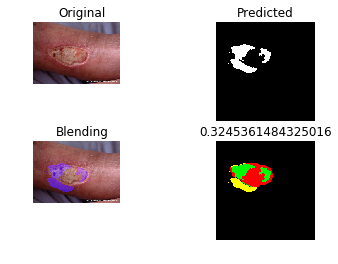

PREDICT... t_25
../testing_data/features/original/t_25.txt
 , IoU = 0.011724915445321308
Saving... ../training_data/model/original/results/model66.88/reports/t_25_report.png


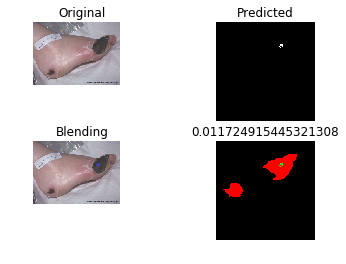

PREDICT... b_11
../testing_data/features/original/b_11.txt
 , IoU = 0.8266527850078085
Saving... ../training_data/model/original/results/model66.88/reports/b_11_report.png


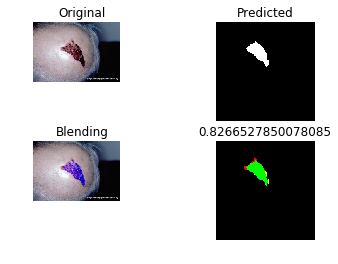

PREDICT... p1_67
../testing_data/features/original/p1_67.txt
 , IoU = 0.712462288233929
Saving... ../training_data/model/original/results/model66.88/reports/p1_67_report.png


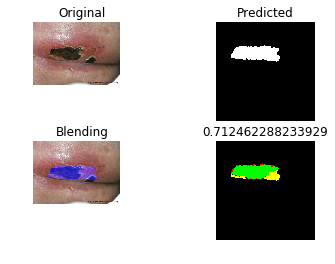

PREDICT... b_05
../testing_data/features/original/b_05.txt
 , IoU = 0.5139487811317434
Saving... ../training_data/model/original/results/model66.88/reports/b_05_report.png


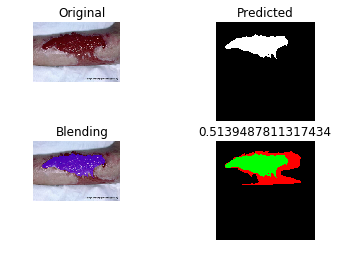

PREDICT... m_43
../testing_data/features/original/m_43.txt
 , IoU = 0.47280163599182007
Saving... ../training_data/model/original/results/model66.88/reports/m_43_report.png


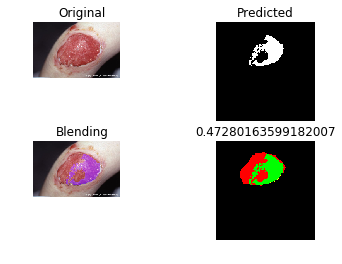

PREDICT... p1_73
../testing_data/features/original/p1_73.txt
 , IoU = 0.7433898577513461
Saving... ../training_data/model/original/results/model66.88/reports/p1_73_report.png


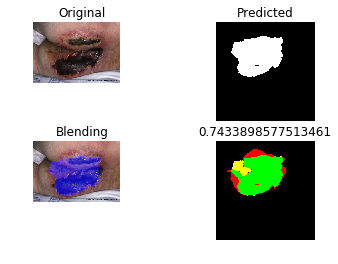

PREDICT... v1_84
../testing_data/features/original/v1_84.txt
 , IoU = 0.26855069106632695
Saving... ../training_data/model/original/results/model66.88/reports/v1_84_report.png


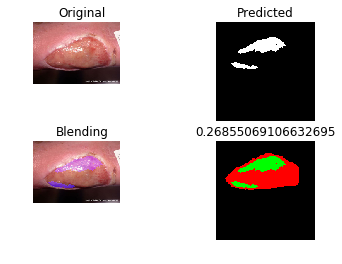

PREDICT... b_20
../testing_data/features/original/b_20.txt
 , IoU = 0.0
Saving... ../training_data/model/original/results/model66.88/reports/b_20_report.png


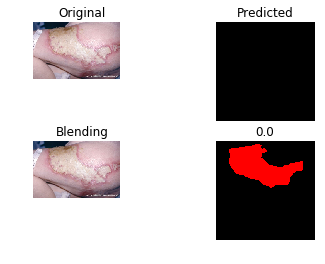

PREDICT... v1_32
../testing_data/features/original/v1_32.txt
 , IoU = 0.8604907637165702
Saving... ../training_data/model/original/results/model66.88/reports/v1_32_report.png


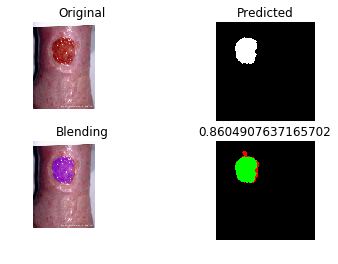

PREDICT... m_25
../testing_data/features/original/m_25.txt
 , IoU = 0.5916860916860917
Saving... ../training_data/model/original/results/model66.88/reports/m_25_report.png


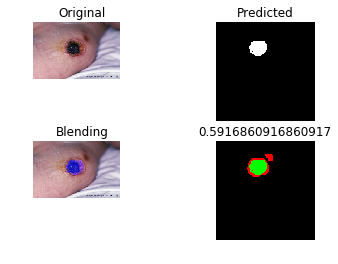

PREDICT... p1_81
../testing_data/features/original/p1_81.txt
 , IoU = 0.3172976121141526
Saving... ../training_data/model/original/results/model66.88/reports/p1_81_report.png


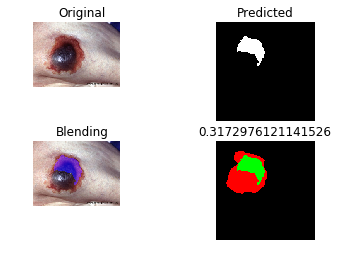

PREDICT... p1_72
../testing_data/features/original/p1_72.txt
 , IoU = 0.5391822827938672
Saving... ../training_data/model/original/results/model66.88/reports/p1_72_report.png


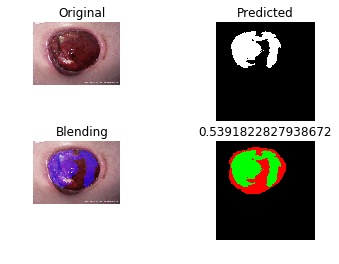

PREDICT... f_18
../testing_data/features/original/f_18.txt
 , IoU = 0.46198453608247425
Saving... ../training_data/model/original/results/model66.88/reports/f_18_report.png


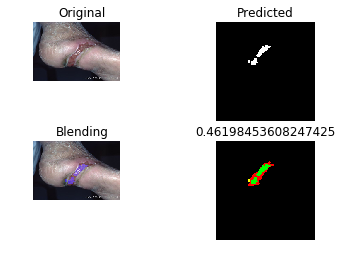

SEGMENTATION REPORT :: iou_avg 0.5212527840323751, iou_min 0.0
date: 2018-05-08 ,time: 11:11:22
	wound	not wound
    wound	86161	6638
not wound	85238	1591435
precision => 92.85
recall => 50.27
f-measure => 65.22
accuracy => 94.81
all sample => 1769472


In [115]:
#k-fold => 2
model_name = 'model66.88.model'
segmentation(root_path, model_name, color_dir_path, gray_dir_path)

Image Dir is ../testing_data/features/original/
Model is ../training_data/model/original/model64.01.model
START : date: 2018-05-08 ,time: 11:11:22
PREDICT... b_12
../testing_data/features/original/b_12.txt
 , IoU = 0.6743576297850026
Saving... ../training_data/model/original/results/model64.01/reports/b_12_report.png


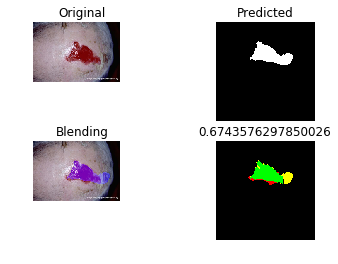

PREDICT... m_03
../testing_data/features/original/m_03.txt
 , IoU = 0.6429889298892989
Saving... ../training_data/model/original/results/model64.01/reports/m_03_report.png


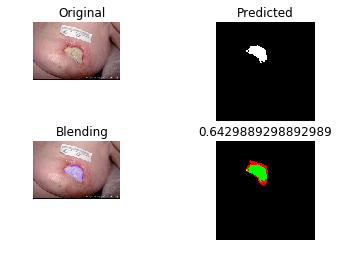

PREDICT... f_50
../testing_data/features/original/f_50.txt
 , IoU = 0.16869338121276423
Saving... ../training_data/model/original/results/model64.01/reports/f_50_report.png


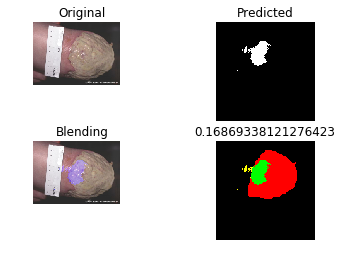

PREDICT... f_35
../testing_data/features/original/f_35.txt
 , IoU = 0.6352201257861635
Saving... ../training_data/model/original/results/model64.01/reports/f_35_report.png


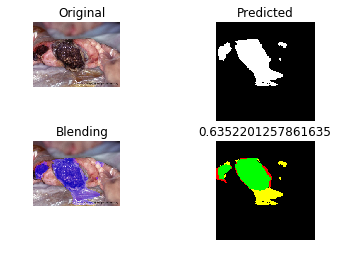

PREDICT... v2_07
../testing_data/features/original/v2_07.txt
 , IoU = 0.5805038335158818
Saving... ../training_data/model/original/results/model64.01/reports/v2_07_report.png


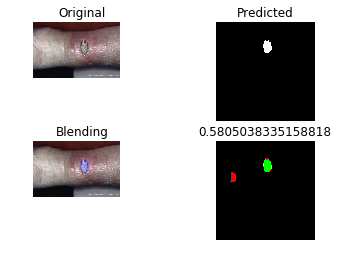

PREDICT... p2_54
../testing_data/features/original/p2_54.txt
 , IoU = 0.7689898198903681
Saving... ../training_data/model/original/results/model64.01/reports/p2_54_report.png


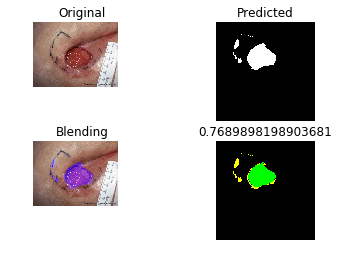

PREDICT... m_47
../testing_data/features/original/m_47.txt
 , IoU = 0.8450466896019098
Saving... ../training_data/model/original/results/model64.01/reports/m_47_report.png


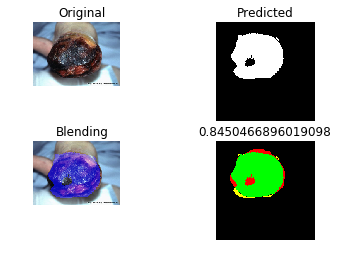

PREDICT... a_04
../testing_data/features/original/a_04.txt
 , IoU = 0.9054191191394357
Saving... ../training_data/model/original/results/model64.01/reports/a_04_report.png


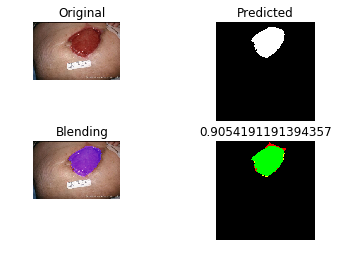

PREDICT... f_41
../testing_data/features/original/f_41.txt
 , IoU = 0.6662162162162162
Saving... ../training_data/model/original/results/model64.01/reports/f_41_report.png


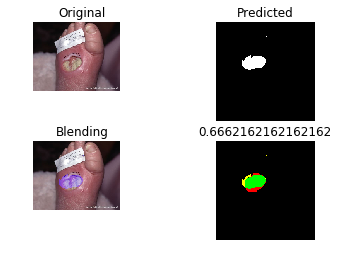

PREDICT... p2_57
../testing_data/features/original/p2_57.txt
 , IoU = 0.7849030228900926
Saving... ../training_data/model/original/results/model64.01/reports/p2_57_report.png


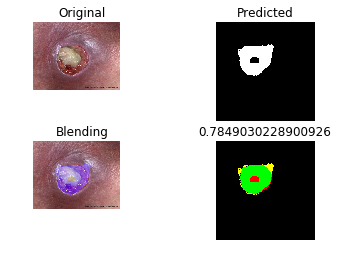

PREDICT... p1_82
../testing_data/features/original/p1_82.txt
 , IoU = 0.4382710490769923
Saving... ../training_data/model/original/results/model64.01/reports/p1_82_report.png


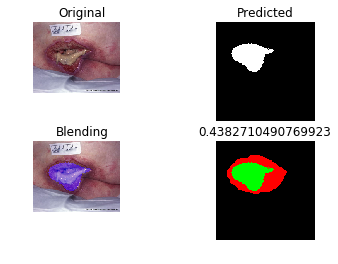

PREDICT... v1_70
../testing_data/features/original/v1_70.txt
 , IoU = 0.8446726572528883
Saving... ../training_data/model/original/results/model64.01/reports/v1_70_report.png


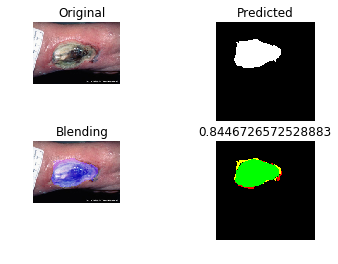

PREDICT... a_05
../testing_data/features/original/a_05.txt
 , IoU = 0.8618389709385421
Saving... ../training_data/model/original/results/model64.01/reports/a_05_report.png


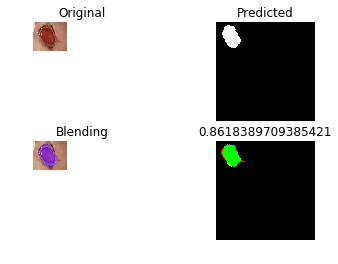

PREDICT... v1_76
../testing_data/features/original/v1_76.txt
 , IoU = 0.49267088412282056
Saving... ../training_data/model/original/results/model64.01/reports/v1_76_report.png


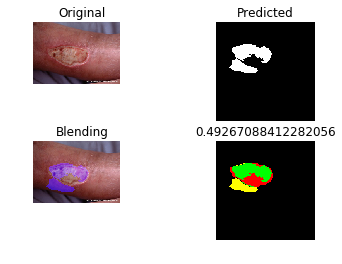

PREDICT... t_25
../testing_data/features/original/t_25.txt
 , IoU = 0.14859075535512964
Saving... ../training_data/model/original/results/model64.01/reports/t_25_report.png


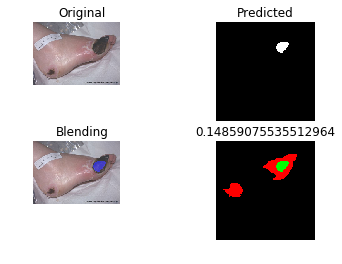

PREDICT... b_11
../testing_data/features/original/b_11.txt
 , IoU = 0.6285390713476784
Saving... ../training_data/model/original/results/model64.01/reports/b_11_report.png


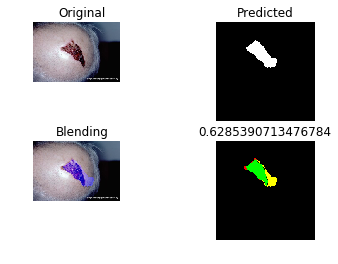

PREDICT... p1_67
../testing_data/features/original/p1_67.txt
 , IoU = 0.6936936936936937
Saving... ../training_data/model/original/results/model64.01/reports/p1_67_report.png


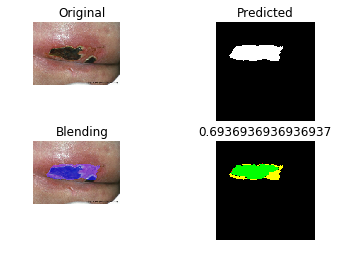

PREDICT... b_05
../testing_data/features/original/b_05.txt
 , IoU = 0.5303430079155673
Saving... ../training_data/model/original/results/model64.01/reports/b_05_report.png


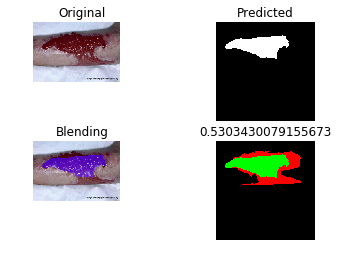

PREDICT... m_43
../testing_data/features/original/m_43.txt
 , IoU = 0.45688170618624985
Saving... ../training_data/model/original/results/model64.01/reports/m_43_report.png


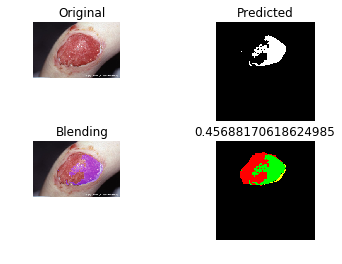

PREDICT... p1_73
../testing_data/features/original/p1_73.txt
 , IoU = 0.7399834623769075
Saving... ../training_data/model/original/results/model64.01/reports/p1_73_report.png


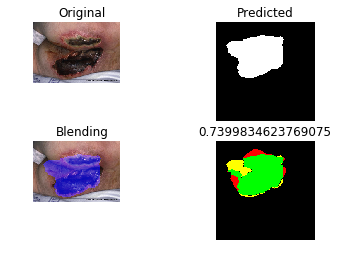

PREDICT... v1_84
../testing_data/features/original/v1_84.txt
 , IoU = 0.4798857231101845
Saving... ../training_data/model/original/results/model64.01/reports/v1_84_report.png


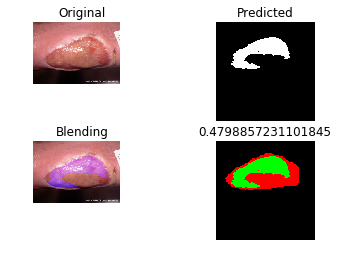

PREDICT... b_20
../testing_data/features/original/b_20.txt
 , IoU = 0.0
Saving... ../training_data/model/original/results/model64.01/reports/b_20_report.png


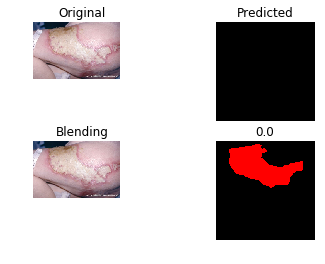

PREDICT... v1_32
../testing_data/features/original/v1_32.txt
 , IoU = 0.8996728462377317
Saving... ../training_data/model/original/results/model64.01/reports/v1_32_report.png


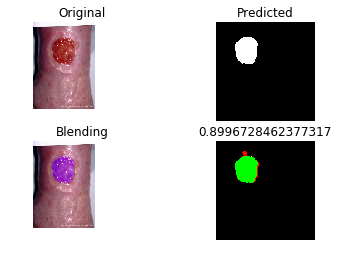

PREDICT... m_25
../testing_data/features/original/m_25.txt
 , IoU = 0.6535922330097087
Saving... ../training_data/model/original/results/model64.01/reports/m_25_report.png


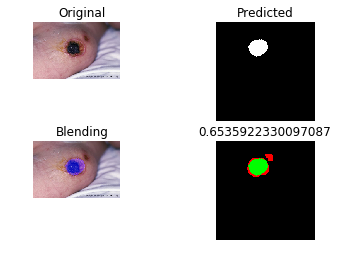

PREDICT... p1_81
../testing_data/features/original/p1_81.txt
 , IoU = 0.396575821104123
Saving... ../training_data/model/original/results/model64.01/reports/p1_81_report.png


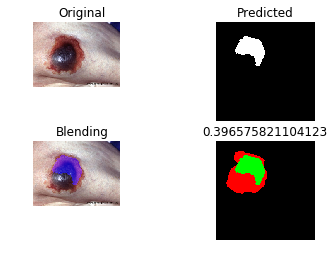

PREDICT... p1_72
../testing_data/features/original/p1_72.txt
 , IoU = 0.7981260647359455
Saving... ../training_data/model/original/results/model64.01/reports/p1_72_report.png


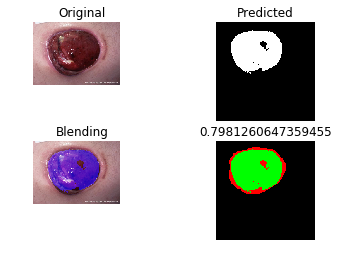

PREDICT... f_18
../testing_data/features/original/f_18.txt
 , IoU = 0.7172619047619048
Saving... ../training_data/model/original/results/model64.01/reports/f_18_report.png


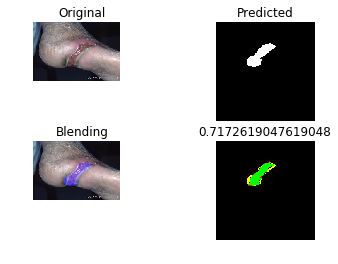

SEGMENTATION REPORT :: iou_avg 0.6093680970056741, iou_min 0.0
date: 2018-05-08 ,time: 11:11:57
	wound	not wound
    wound	106180	12658
not wound	65219	1585415
precision => 89.35
recall => 61.95
f-measure => 73.17
accuracy => 95.60
all sample => 1769472


In [116]:
#k-fold => 3
model_name = 'model64.01.model'
segmentation(root_path, model_name, color_dir_path, gray_dir_path)

Image Dir is ../testing_data/features/original/
Model is ../training_data/model/original/model67.26.model
START : date: 2018-05-08 ,time: 11:11:57
PREDICT... b_12
../testing_data/features/original/b_12.txt
 , IoU = 0.68346499591392
Saving... ../training_data/model/original/results/model67.26/reports/b_12_report.png


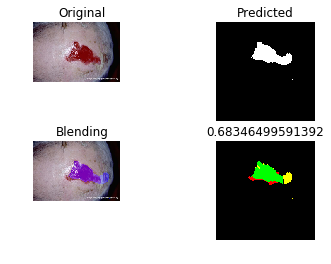

PREDICT... m_03
../testing_data/features/original/m_03.txt
 , IoU = 0.5041666666666667
Saving... ../training_data/model/original/results/model67.26/reports/m_03_report.png


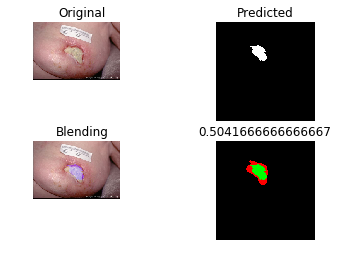

PREDICT... f_50
../testing_data/features/original/f_50.txt
 , IoU = 0.1685754628176969
Saving... ../training_data/model/original/results/model67.26/reports/f_50_report.png


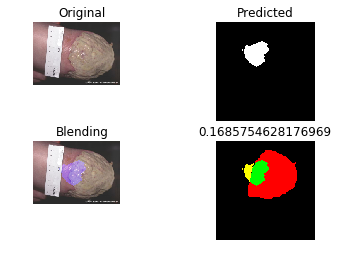

PREDICT... f_35
../testing_data/features/original/f_35.txt
 , IoU = 0.5791085762568652
Saving... ../training_data/model/original/results/model67.26/reports/f_35_report.png


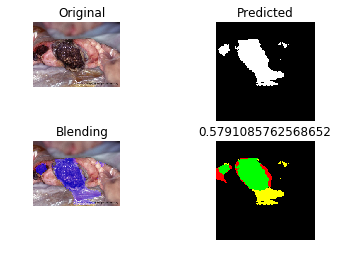

PREDICT... v2_07
../testing_data/features/original/v2_07.txt
 , IoU = 0.5571120689655172
Saving... ../training_data/model/original/results/model67.26/reports/v2_07_report.png


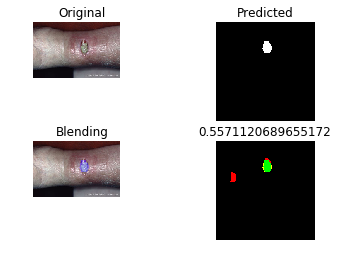

PREDICT... p2_54
../testing_data/features/original/p2_54.txt
 , IoU = 0.8240270727580372
Saving... ../training_data/model/original/results/model67.26/reports/p2_54_report.png


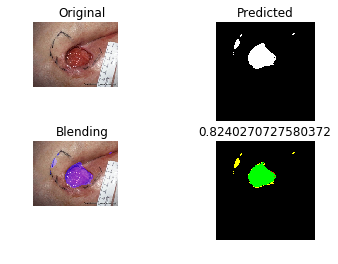

PREDICT... m_47
../testing_data/features/original/m_47.txt
 , IoU = 0.8263041461500036
Saving... ../training_data/model/original/results/model67.26/reports/m_47_report.png


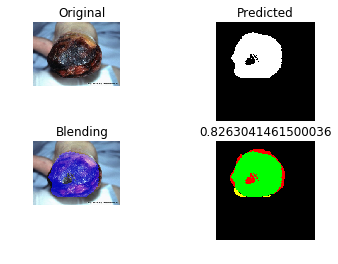

PREDICT... a_04
../testing_data/features/original/a_04.txt
 , IoU = 0.904268545379196
Saving... ../training_data/model/original/results/model67.26/reports/a_04_report.png


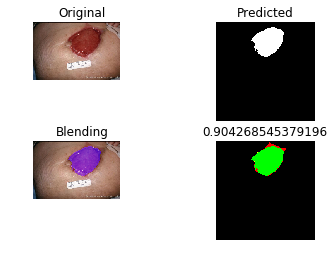

PREDICT... f_41
../testing_data/features/original/f_41.txt
 , IoU = 0.6555831265508685
Saving... ../training_data/model/original/results/model67.26/reports/f_41_report.png


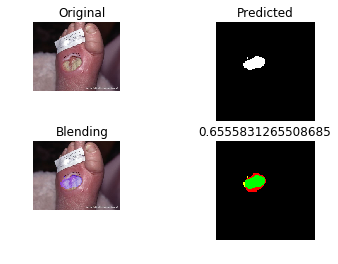

PREDICT... p2_57
../testing_data/features/original/p2_57.txt
 , IoU = 0.8698224852071006
Saving... ../training_data/model/original/results/model67.26/reports/p2_57_report.png


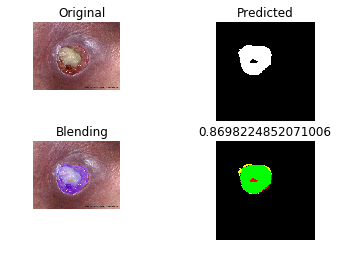

PREDICT... p1_82
../testing_data/features/original/p1_82.txt
 , IoU = 0.4354795137325529
Saving... ../training_data/model/original/results/model67.26/reports/p1_82_report.png


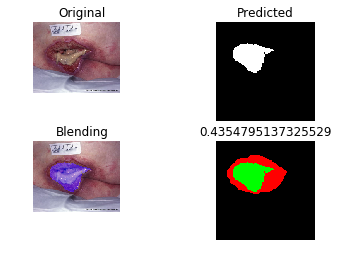

PREDICT... v1_70
../testing_data/features/original/v1_70.txt
 , IoU = 0.8692868840256067
Saving... ../training_data/model/original/results/model67.26/reports/v1_70_report.png


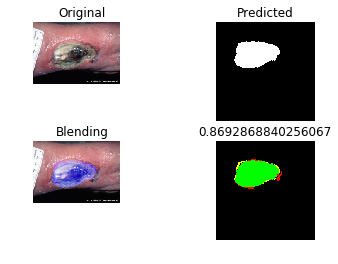

PREDICT... a_05
../testing_data/features/original/a_05.txt
 , IoU = 0.8768082127858143
Saving... ../training_data/model/original/results/model67.26/reports/a_05_report.png


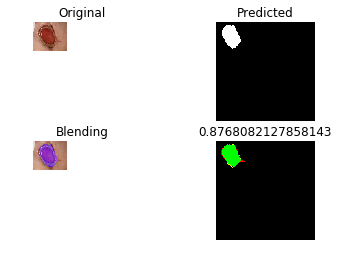

PREDICT... v1_76
../testing_data/features/original/v1_76.txt
 , IoU = 0.24285917294301548
Saving... ../training_data/model/original/results/model67.26/reports/v1_76_report.png


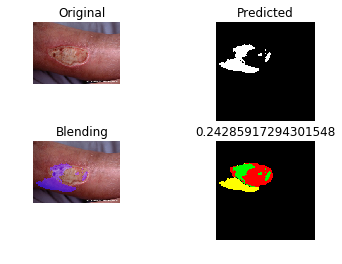

PREDICT... t_25
../testing_data/features/original/t_25.txt
 , IoU = 0.28229988726042843
Saving... ../training_data/model/original/results/model67.26/reports/t_25_report.png


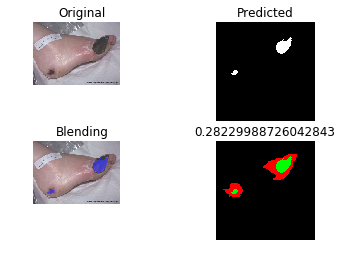

PREDICT... b_11
../testing_data/features/original/b_11.txt
 , IoU = 0.8236173393124065
Saving... ../training_data/model/original/results/model67.26/reports/b_11_report.png


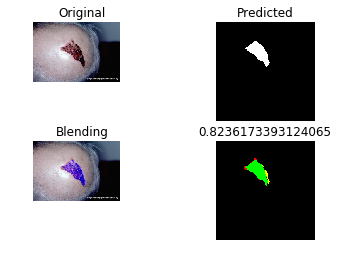

PREDICT... p1_67
../testing_data/features/original/p1_67.txt
 , IoU = 0.7575757575757576
Saving... ../training_data/model/original/results/model67.26/reports/p1_67_report.png


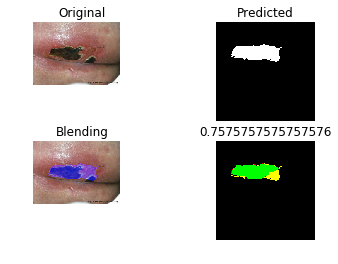

PREDICT... b_05
../testing_data/features/original/b_05.txt
 , IoU = 0.5496787820117927
Saving... ../training_data/model/original/results/model67.26/reports/b_05_report.png


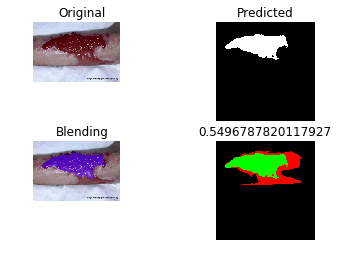

PREDICT... m_43
../testing_data/features/original/m_43.txt
 , IoU = 0.32454004329004327
Saving... ../training_data/model/original/results/model67.26/reports/m_43_report.png


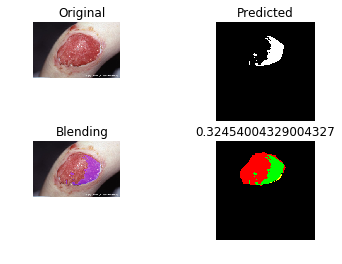

PREDICT... p1_73
../testing_data/features/original/p1_73.txt
 , IoU = 0.7210671151200122
Saving... ../training_data/model/original/results/model67.26/reports/p1_73_report.png


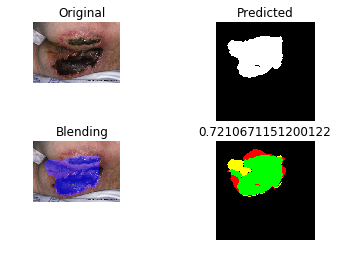

PREDICT... v1_84
../testing_data/features/original/v1_84.txt
 , IoU = 0.312900486373813
Saving... ../training_data/model/original/results/model67.26/reports/v1_84_report.png


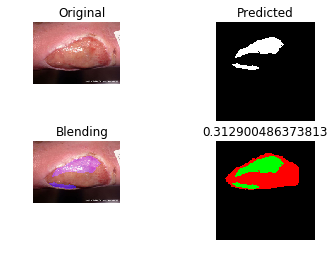

PREDICT... b_20
../testing_data/features/original/b_20.txt
 , IoU = 0.0
Saving... ../training_data/model/original/results/model67.26/reports/b_20_report.png


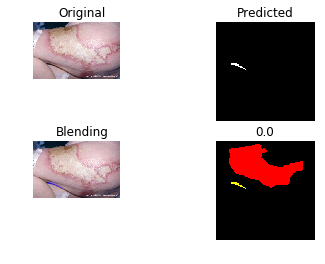

PREDICT... v1_32
../testing_data/features/original/v1_32.txt
 , IoU = 0.8605161998901703
Saving... ../training_data/model/original/results/model67.26/reports/v1_32_report.png


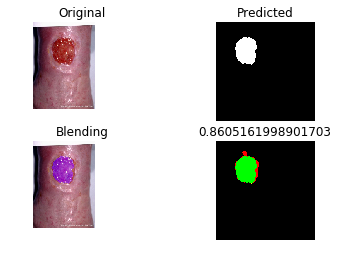

PREDICT... m_25
../testing_data/features/original/m_25.txt
 , IoU = 0.6332945285215367
Saving... ../training_data/model/original/results/model67.26/reports/m_25_report.png


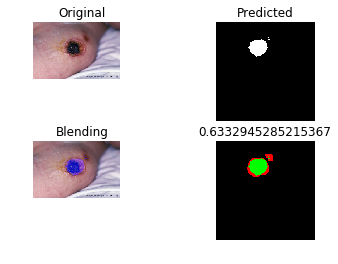

PREDICT... p1_81
../testing_data/features/original/p1_81.txt
 , IoU = 0.4043321299638989
Saving... ../training_data/model/original/results/model67.26/reports/p1_81_report.png


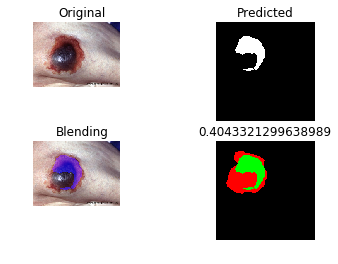

PREDICT... p1_72
../testing_data/features/original/p1_72.txt
 , IoU = 0.743824531516184
Saving... ../training_data/model/original/results/model67.26/reports/p1_72_report.png


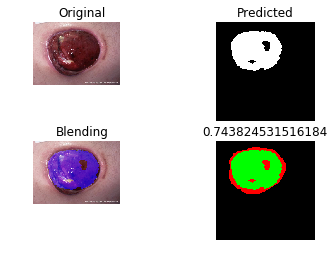

PREDICT... f_18
../testing_data/features/original/f_18.txt
 , IoU = 0.7090209020902091
Saving... ../training_data/model/original/results/model67.26/reports/f_18_report.png


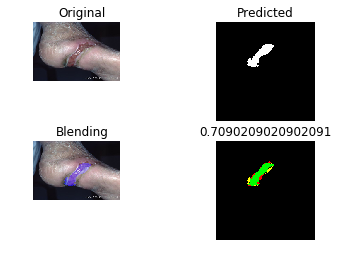

SEGMENTATION REPORT :: iou_avg 0.5970198012251524, iou_min 0.0
date: 2018-05-08 ,time: 11:12:33
	wound	not wound
    wound	99217	10787
not wound	72182	1587286
precision => 90.19
recall => 57.89
f-measure => 70.52
accuracy => 95.31
all sample => 1769472


In [117]:
#k-fold => 4
model_name = 'model67.26.model'
segmentation(root_path, model_name, color_dir_path, gray_dir_path)

Image Dir is ../testing_data/features/original/
Model is ../training_data/model/original/model63.80.model
START : date: 2018-05-08 ,time: 11:12:33
PREDICT... b_12
../testing_data/features/original/b_12.txt
 , IoU = 0.7443828421359789
Saving... ../training_data/model/original/results/model63.80/reports/b_12_report.png


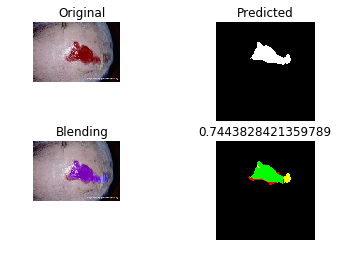

PREDICT... m_03
../testing_data/features/original/m_03.txt
 , IoU = 0.3263888888888889
Saving... ../training_data/model/original/results/model63.80/reports/m_03_report.png


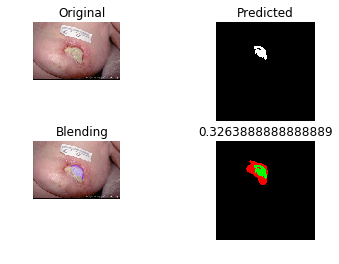

PREDICT... f_50
../testing_data/features/original/f_50.txt
 , IoU = 0.006148222000664672
Saving... ../training_data/model/original/results/model63.80/reports/f_50_report.png


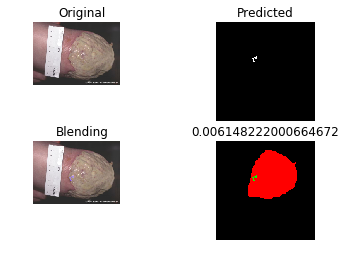

PREDICT... f_35
../testing_data/features/original/f_35.txt
 , IoU = 0.6557133043279139
Saving... ../training_data/model/original/results/model63.80/reports/f_35_report.png


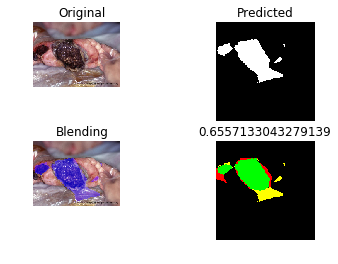

PREDICT... v2_07
../testing_data/features/original/v2_07.txt
 , IoU = 0.533678756476684
Saving... ../training_data/model/original/results/model63.80/reports/v2_07_report.png


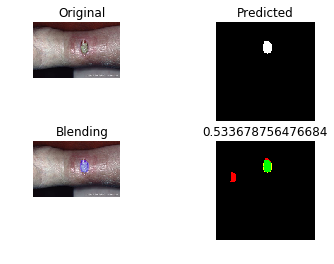

PREDICT... p2_54
../testing_data/features/original/p2_54.txt
 , IoU = 0.8872089507106139
Saving... ../training_data/model/original/results/model63.80/reports/p2_54_report.png


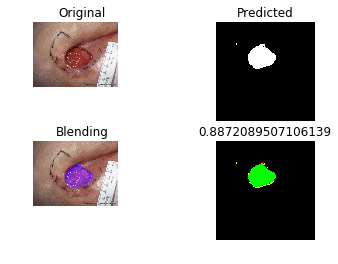

PREDICT... m_47
../testing_data/features/original/m_47.txt
 , IoU = 0.7060723988545414
Saving... ../training_data/model/original/results/model63.80/reports/m_47_report.png


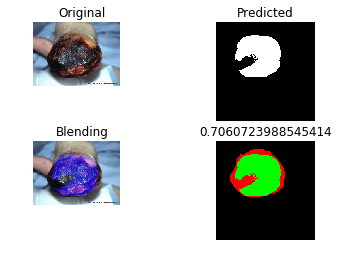

PREDICT... a_04
../testing_data/features/original/a_04.txt
 , IoU = 0.8886143710109121
Saving... ../training_data/model/original/results/model63.80/reports/a_04_report.png


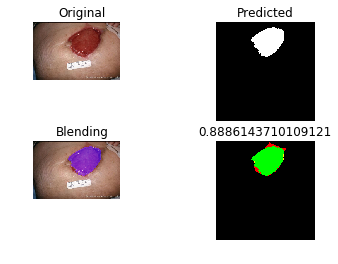

PREDICT... f_41
../testing_data/features/original/f_41.txt
 , IoU = 0.6255279211637729
Saving... ../training_data/model/original/results/model63.80/reports/f_41_report.png


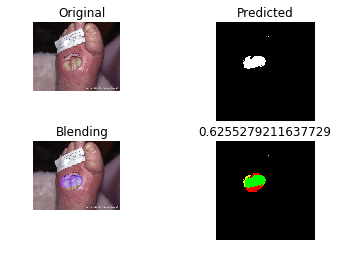

PREDICT... p2_57
../testing_data/features/original/p2_57.txt
 , IoU = 0.7258694439278408
Saving... ../training_data/model/original/results/model63.80/reports/p2_57_report.png


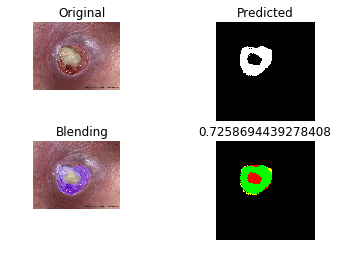

PREDICT... p1_82
../testing_data/features/original/p1_82.txt
 , IoU = 0.49869428185502024
Saving... ../training_data/model/original/results/model63.80/reports/p1_82_report.png


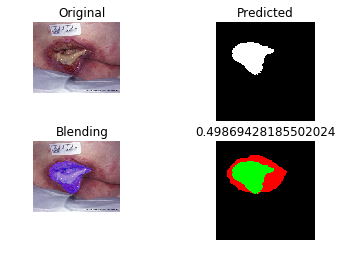

PREDICT... v1_70
../testing_data/features/original/v1_70.txt
 , IoU = 0.5841416474210932
Saving... ../training_data/model/original/results/model63.80/reports/v1_70_report.png


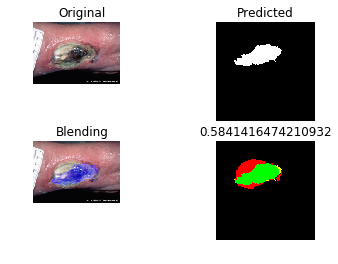

PREDICT... a_05
../testing_data/features/original/a_05.txt
 , IoU = 0.8789840637450199
Saving... ../training_data/model/original/results/model63.80/reports/a_05_report.png


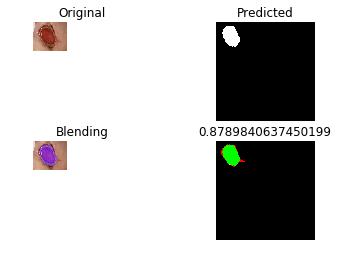

PREDICT... v1_76
../testing_data/features/original/v1_76.txt
 , IoU = 0.32527384450975155
Saving... ../training_data/model/original/results/model63.80/reports/v1_76_report.png


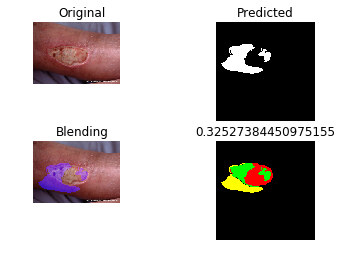

PREDICT... t_25
../testing_data/features/original/t_25.txt
 , IoU = 0.019165727170236752
Saving... ../training_data/model/original/results/model63.80/reports/t_25_report.png


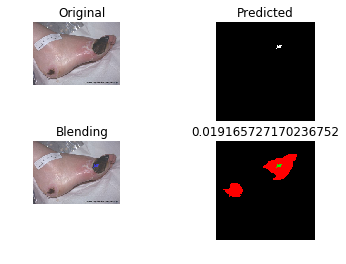

PREDICT... b_11
../testing_data/features/original/b_11.txt
 , IoU = 0.7310376919497441
Saving... ../training_data/model/original/results/model63.80/reports/b_11_report.png


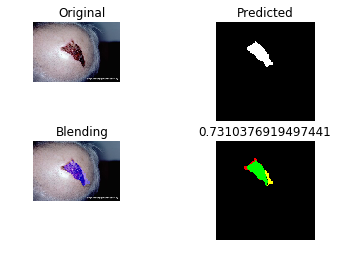

PREDICT... p1_67
../testing_data/features/original/p1_67.txt
 , IoU = 0.6798402354425058
Saving... ../training_data/model/original/results/model63.80/reports/p1_67_report.png


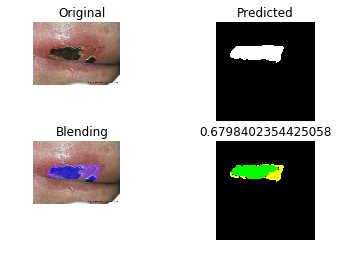

PREDICT... b_05
../testing_data/features/original/b_05.txt
 , IoU = 0.548372911169745
Saving... ../training_data/model/original/results/model63.80/reports/b_05_report.png


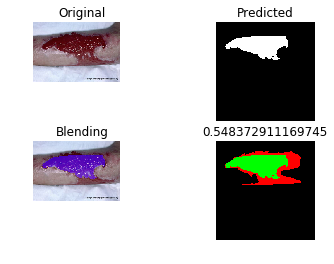

PREDICT... m_43
../testing_data/features/original/m_43.txt
 , IoU = 0.6041331186258723
Saving... ../training_data/model/original/results/model63.80/reports/m_43_report.png


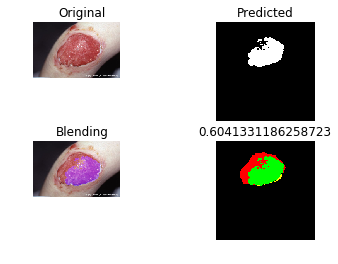

PREDICT... p1_73
../testing_data/features/original/p1_73.txt
 , IoU = 0.717391304347826
Saving... ../training_data/model/original/results/model63.80/reports/p1_73_report.png


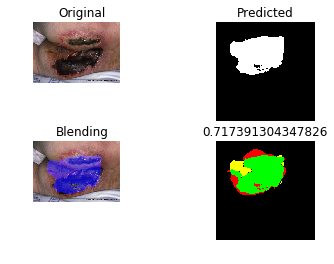

PREDICT... v1_84
../testing_data/features/original/v1_84.txt
 , IoU = 0.3911640414905878
Saving... ../training_data/model/original/results/model63.80/reports/v1_84_report.png


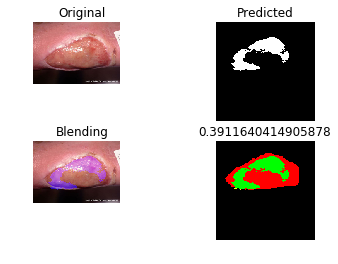

PREDICT... b_20
../testing_data/features/original/b_20.txt
 , IoU = 0.0
Saving... ../training_data/model/original/results/model63.80/reports/b_20_report.png


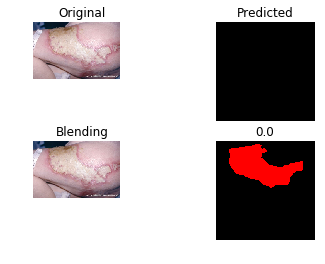

PREDICT... v1_32
../testing_data/features/original/v1_32.txt
 , IoU = 0.8926414058209775
Saving... ../training_data/model/original/results/model63.80/reports/v1_32_report.png


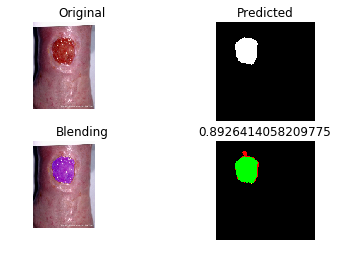

PREDICT... m_25
../testing_data/features/original/m_25.txt
 , IoU = 0.6239316239316239
Saving... ../training_data/model/original/results/model63.80/reports/m_25_report.png


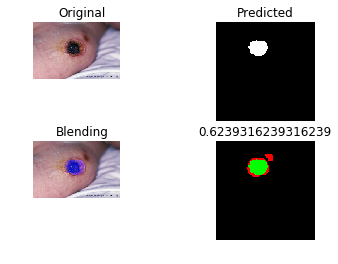

PREDICT... p1_81
../testing_data/features/original/p1_81.txt
 , IoU = 0.2768782760629004
Saving... ../training_data/model/original/results/model63.80/reports/p1_81_report.png


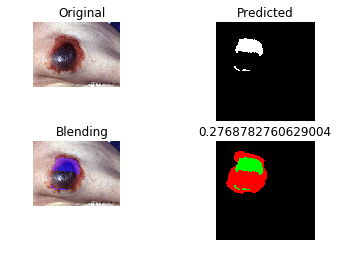

PREDICT... p1_72
../testing_data/features/original/p1_72.txt
 , IoU = 0.7468057921635435
Saving... ../training_data/model/original/results/model63.80/reports/p1_72_report.png


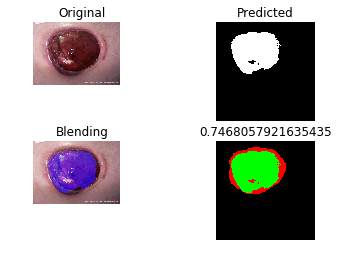

PREDICT... f_18
../testing_data/features/original/f_18.txt
 , IoU = 0.6257309941520468
Saving... ../training_data/model/original/results/model63.80/reports/f_18_report.png


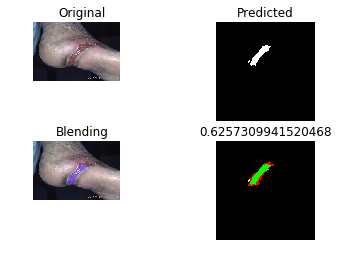

SEGMENTATION REPORT :: iou_avg 0.5645848910872706, iou_min 0.0
date: 2018-05-08 ,time: 11:13:08
	wound	not wound
    wound	93783	8880
not wound	77616	1589193
precision => 91.35
recall => 54.72
f-measure => 68.44
accuracy => 95.11
all sample => 1769472


In [118]:
#k-fold => 5
model_name = 'model63.80.model'
segmentation(root_path, model_name, color_dir_path, gray_dir_path)

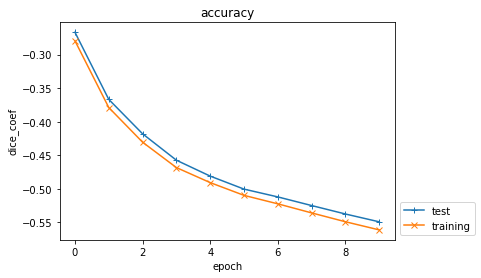

Image Dir is ../testing_data/features/original/


Exception: ../training_data/model/original/model46.15.model not found.

In [123]:
#k-fold => 1
model_name = 'model46.15.model'
segmentation(root_path, model_name, color_dir_path, gray_dir_path)

In [65]:
a = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10]
cv = cross_validation.KFold(len(a), n_folds=5, shuffle=False, random_state=None, )

In [66]:
for train, test in cv :
    print([a[index] for index in train])
    print([a[index] for index in test])

[3, 4, 5, 6, 7, 8, 9, 10]
[1, 2]
[1, 2, 5, 6, 7, 8, 9, 10]
[3, 4]
[1, 2, 3, 4, 7, 8, 9, 10]
[5, 6]
[1, 2, 3, 4, 5, 6, 9, 10]
[7, 8]
[1, 2, 3, 4, 5, 6, 7, 8]
[9, 10]


In [95]:
a = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10]
t = int(len(a) * 0.1)


aa = np.random.permutation(a)

In [96]:
test_indices = aa[:t]
training_indices = aa[t:]

In [97]:
print(aa[t:])
print(aa[:t])
print(os.system('clc'))


[10  3  9  2  5  8  7  1  6]
[4]
32512


In [98]:
print(test_indices)
print(training_indices)

[4]
[10  3  9  2  5  8  7  1  6]


In [99]:
aa


array([ 4, 10,  3,  9,  2,  5,  8,  7,  1,  6])

In [100]:
cv = cross_validation.KFold(180, n_folds=5, shuffle=False, random_state=None, )

In [101]:
for train, test in cv :
    print(train)
    print(test)

[ 36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179]
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35]
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110